# Set up kaggle API and load data
NASA Turbofan Engine: https://www.kaggle.com/datasets/behrad3d/nasa-cmaps/data  
How to connect: https://www.kaggle.com/discussions/general/74235

In [ ]:
!pip install -q kaggle
from google.colab import files

files.upload()
!rm -rf /root/.kaggle
!mkdir /root/.kaggle
!mv kaggle.json /root/.kaggle/kaggle.json
!chmod 600 ~/.kaggle/kaggle.json

Saving kaggle.json to kaggle.json


In [ ]:
!kaggle datasets download behrad3d/nasa-cmaps
! unzip nasa-cmaps.zip -d nasa

 41% 5.00M/12.3M [00:00<00:00, 44.4MB/s]
100% 12.3M/12.3M [00:00<00:00, 66.1MB/s]
Archive:  nasa-cmaps.zip
  inflating: nasa/CMaps/Damage Propagation Modeling.pdf  
  inflating: nasa/CMaps/RUL_FD001.txt  
  inflating: nasa/CMaps/RUL_FD002.txt  
  inflating: nasa/CMaps/RUL_FD003.txt  
  inflating: nasa/CMaps/RUL_FD004.txt  
  inflating: nasa/CMaps/readme.txt   
  inflating: nasa/CMaps/test_FD001.txt  
  inflating: nasa/CMaps/test_FD002.txt  
  inflating: nasa/CMaps/test_FD003.txt  
  inflating: nasa/CMaps/test_FD004.txt  
  inflating: nasa/CMaps/train_FD001.txt  
  inflating: nasa/CMaps/train_FD002.txt  
  inflating: nasa/CMaps/train_FD003.txt  
  inflating: nasa/CMaps/train_FD004.txt  
  inflating: nasa/CMaps/x.txt        


In [ ]:
import plotly.express as px
import pandas as pd
import numpy as np
import plotly.graph_objects as go
from plotly.subplots import make_subplots
import matplotlib.pyplot as plt
import seaborn as sns
from statsmodels.graphics.tsaplots import plot_acf
from statsmodels.tsa.stattools import adfuller
import numpy as np

pd.set_option('display.max_rows', 500)
pd.set_option('display.max_columns', 500)

## From readme
Data Set: FD001
Train trjectories: 100
Test trajectories: 100
Conditions: ONE (Sea Level)
Fault Modes: ONE (HPC Degradation)

Data Set: FD002
Train trjectories: 260
Test trajectories: 259
Conditions: SIX
Fault Modes: ONE (HPC Degradation)

Data Set: FD003
Train trjectories: 100
Test trajectories: 100
Conditions: ONE (Sea Level)
Fault Modes: TWO (HPC Degradation, Fan Degradation)

Data Set: FD004
Train trjectories: 248
Test trajectories: 249
Conditions: SIX
Fault Modes: TWO (HPC Degradation, Fan Degradation)



Experimental Scenario

Data sets consists of multiple multivariate time series. Each data set is further divided into training and test subsets. Each time series is from a different engine i.e., the data can be considered to be from a fleet of engines of the same type. Each engine starts with different degrees of initial wear and manufacturing variation which is unknown to the user. This wear and variation is considered normal, i.e., it is not considered a fault condition. There are three operational settings that have a substantial effect on engine performance. These settings are also included in the data. The data is contaminated with sensor noise.

The engine is operating normally at the start of each time series, and develops a fault at some point during the series. In the training set, the fault grows in magnitude until system failure. In the test set, the time series ends some time prior to system failure. The objective of the competition is to predict the number of remaining operational cycles before failure in the test set, i.e., the number of operational cycles after the last cycle that the engine will continue to operate. Also provided a vector of true Remaining Useful Life (RUL) values for the test data.

The data are provided as a zip-compressed text file with 26 columns of numbers, separated by spaces. Each row is a snapshot of data taken during a single operational cycle, each column is a different variable. The columns correspond to:

1)	unit number  
2)	time, in cycles  
3)	operational setting 1  
4)	operational setting 2  
5)	operational setting 3  
6)	sensor measurement  1  
7)	sensor measurement  2  
...  
26)	sensor measurement  26

In [ ]:
def prepare_data(df: pd.DataFrame, train: bool = True) -> pd.DataFrame:
  # rename columns
  columns = ['unit_number','time_in_cycles','setting_1','setting_2','setting_3'] + ['sensor_' + str(i) for i in range(1,24)]
  df.columns = columns

  # RUL
  if train:
    fd_RUL = df.groupby('unit_number')['time_in_cycles'].max().reset_index()
    fd_RUL = pd.DataFrame(fd_RUL)
    fd_RUL.columns = ['unit_number','max']
    df = df.merge(fd_RUL, on=['unit_number'], how='left')
    df['RUL'] = df['max'] - df['time_in_cycles']
    df.drop(columns=['max'], inplace = True)

  return df

The train datasets contains time series of 23 sensors and 3 settings of multiple units(turbofan engine). Each engine works normally at the beginning of each time series and fails at the end of the time series. Each row is a snapshot of the data taken during a single operation cycle.

In [ ]:
# load the data
fd_1_train = pd.read_csv("nasa/CMaps/train_FD001.txt", sep=" ", header=None)
fd_2_train = pd.read_csv("nasa/CMaps/train_FD002.txt", sep=" ", header=None)
fd_3_train = pd.read_csv("nasa/CMaps/train_FD003.txt", sep=" ", header=None)
fd_4_train = pd.read_csv("nasa/CMaps/train_FD004.txt", sep=" ", header=None)

fd_1_test = pd.read_csv("nasa/CMaps/test_FD001.txt", sep=" ", header=None)
fd_2_test = pd.read_csv("nasa/CMaps/test_FD002.txt", sep=" ", header=None)
fd_3_test = pd.read_csv("nasa/CMaps/test_FD003.txt", sep=" ", header=None)
fd_4_test = pd.read_csv("nasa/CMaps/test_FD004.txt", sep=" ", header=None)

fd_1_test_rul = pd.read_csv("nasa/CMaps/RUL_FD001.txt", header=None, names=['RUL'])
fd_2_test_rul = pd.read_csv("nasa/CMaps/RUL_FD002.txt", header=None, names=['RUL'])
fd_3_test_rul = pd.read_csv("nasa/CMaps/RUL_FD003.txt", header=None, names=['RUL'])
fd_4_test_rul = pd.read_csv("nasa/CMaps/RUL_FD004.txt", header=None, names=['RUL'])

In [ ]:
fd_1_train.to_csv('train_FD001.csv')
fd_2_train.to_csv('train_FD002.csv')
fd_3_train.to_csv('train_FD003.csv')
fd_4_train.to_csv('train_FD004.csv')

fd_1_test.to_csv('test_FD001.csv')
fd_2_test.to_csv('test_FD002.csv')
fd_3_test.to_csv('test_FD003.csv')
fd_4_test.to_csv('test_FD004.csv')

fd_1_test_rul.to_csv('RUL_FD001.csv')
fd_2_test_rul.to_csv('RUL_FD002.csv')
fd_3_test_rul.to_csv('RUL_FD003.csv')
fd_4_test_rul.to_csv('RUL_FD004.csv')

In [ ]:
fd_1_train = prepare_data(fd_1_train)
fd_2_train = prepare_data(fd_2_train)
fd_3_train = prepare_data(fd_3_train)
fd_4_train = prepare_data(fd_4_train)

fd_1_test = prepare_data(fd_1_test, train=False)
fd_2_test = prepare_data(fd_2_test, train=False)
fd_3_test = prepare_data(fd_3_test, train=False)
fd_4_test = prepare_data(fd_4_test, train=False)

The test RUL values correspond to the RUL of the engine in the test set at the last occurence of observation.

In [ ]:
# add RUL column to test set

def prepare_test_data(df: pd.DataFrame, rul: pd.DataFrame) -> pd.DataFrame:
    # add given RUL values for last cycle of each unit
    df.loc[df.groupby('unit_number')['time_in_cycles'].idxmax(), 'RUL'] = rul['RUL'].values
    fd_RUL = df.groupby('unit_number')['RUL'].max().reset_index().rename(columns={'RUL': 'last_rul'})
    cycles = df.groupby('unit_number')['time_in_cycles'].last().reset_index().rename(columns={'time_in_cycles': 'last_cycle_number'})
    fd_RUL = fd_RUL.merge(cycles, on=['unit_number'])
    df = df.merge(fd_RUL, on=['unit_number'], how='left')
    df['RUL'] = df['last_rul'] + df['last_cycle_number'] - df['time_in_cycles']
    df.drop(columns=['last_rul', 'last_cycle_number'], inplace = True)
    return df


fd_1_test = prepare_test_data(fd_1_test, fd_1_test_rul)
fd_2_test = prepare_test_data(fd_2_test, fd_2_test_rul)
fd_3_test = prepare_test_data(fd_3_test, fd_3_test_rul)
fd_4_test = prepare_test_data(fd_4_test, fd_4_test_rul)

In [ ]:
train_dfs = [fd_1_train, fd_2_train, fd_3_train, fd_4_train]
test_dfs = [fd_1_test, fd_2_test, fd_3_test, fd_4_test]

In [ ]:
for i, df in enumerate(train_dfs):
    print(f'Features with none values in train dataset {i+1}:')
    print(df.isna().sum()[df.isna().sum() > 0])
    print('Total rows:', len(df))

Features with none values in train dataset 1:
sensor_22    20631
sensor_23    20631
dtype: int64
Total rows: 20631
Features with none values in train dataset 2:
sensor_22    53759
sensor_23    53759
dtype: int64
Total rows: 53759
Features with none values in train dataset 3:
sensor_22    24720
sensor_23    24720
dtype: int64
Total rows: 24720
Features with none values in train dataset 4:
sensor_22    61249
sensor_23    61249
dtype: int64
Total rows: 61249


Sensor 22 and 23 do not contain any information so we will remove them

In [ ]:
# remove columns with no information
cols_to_remove = ['sensor_22', 'sensor_23']

for df in train_dfs + test_dfs:
    df.drop(columns=cols_to_remove, inplace=True)

# EDA - Exploratory Data Analysis

In [ ]:
ds = 1
for train, test in zip(train_dfs, test_dfs):
    print(f'Dataset {ds} --- Train Shape: {train.shape}     Test Shape: {test.shape}     Proportion of test data: {len(test) / (len(test) + len(train)):.3f}')
    ds += 1

Dataset 1 --- Train Shape: (20631, 27)     Test Shape: (13096, 27)     Proportion of test data: 0.388
Dataset 2 --- Train Shape: (53759, 27)     Test Shape: (33991, 27)     Proportion of test data: 0.387
Dataset 3 --- Train Shape: (24720, 27)     Test Shape: (16596, 27)     Proportion of test data: 0.402
Dataset 4 --- Train Shape: (61249, 27)     Test Shape: (41214, 27)     Proportion of test data: 0.402


In [ ]:
fd_3_train.describe()

,unit_number,time_in_cycles,setting_1,setting_2,setting_3,sensor_1,sensor_2,sensor_3,sensor_4,sensor_5,sensor_6,sensor_7,sensor_8,sensor_9,sensor_10,sensor_11,sensor_12,sensor_13,sensor_14,sensor_15,sensor_16,sensor_17,sensor_18,sensor_19,sensor_20,sensor_21,RUL
count,24720.000000,24720.000000,24720.000000,24720.000000,24720.0,24720.00,24720.000000,24720.000000,24720.000000,2.472000e+04,24720.000000,24720.000000,24720.000000,24720.000000,24720.000000,24720.000000,24720.000000,24720.000000,24720.000000,24720.000000,2.472000e+04,24720.000000,24720.0,24720.0,24720.000000,24720.000000,24720.000000
mean,48.631877,139.077063,-0.000024,0.000005,100.0,518.67,642.457858,1588.079175,1404.471212,1.462000e+01,21.595841,555.143808,2388.071555,9064.110809,1.301232,47.415707,523.050873,2388.071643,8144.202916,8.396176,3.000000e-02,392.566545,2388.0,100.0,38.988552,23.393024,138.077063
std,29.348985,98.846675,0.002194,0.000294,0.0,0.00,0.523031,6.810418,9.773178,3.552786e-15,0.018116,3.437343,0.158285,19.980294,0.003485,0.300074,3.255314,0.158121,16.504118,0.060512,1.734759e-17,1.761459,0.0,0.0,0.248865,0.149234,98.846675
min,1.000000,1.000000,-0.008600,-0.000600,100.0,518.67,640.840000,1564.300000,1377.060000,1.462000e+01,21.450000,549.610000,2386.900000,9017.980000,1.290000,46.690000,517.770000,2386.930000,8099.680000,8.156300,3.000000e-02,388.000000,2388.0,100.0,38.170000,22.872600,0.000000
25%,23.000000,62.000000,-0.001500,-0.000200,100.0,518.67,642.080000,1583.280000,1397.187500,1.462000e+01,21.580000,553.110000,2388.000000,9051.920000,1.300000,47.190000,521.150000,2388.010000,8134.510000,8.360600,3.000000e-02,391.000000,2388.0,100.0,38.830000,23.296200,61.000000
50%,47.000000,124.000000,-0.000000,-0.000000,100.0,518.67,642.400000,1587.520000,1402.910000,1.462000e+01,21.600000,554.050000,2388.070000,9060.010000,1.300000,47.360000,521.980000,2388.070000,8141.200000,8.398300,3.000000e-02,392.000000,2388.0,100.0,38.990000,23.391600,123.000000
75%,74.000000,191.000000,0.001500,0.000300,100.0,518.67,642.790000,1592.412500,1410.600000,1.462000e+01,21.610000,556.040000,2388.140000,9070.092500,1.300000,47.600000,523.840000,2388.140000,8149.230000,8.437000,3.000000e-02,394.000000,2388.0,100.0,39.140000,23.483300,190.000000
max,100.000000,525.000000,0.008600,0.000700,100.0,518.67,645.110000,1615.390000,1441.160000,1.462000e+01,21.610000,570.490000,2388.600000,9234.350000,1.320000,48.440000,537.400000,2388.610000,8290.550000,8.570500,3.000000e-02,399.000000,2388.0,100.0,39.850000,23.950500,524.000000


## Max cycle time (RUL) for each unit in train set

Each engine within each data set has a different lifespan. This can be attributed to different reasons like that observation of the engines are at different points where they have varying degrees of initial wear and that some of them have slightly varing lifespans due to normal production tolerance and varying day to day operations.

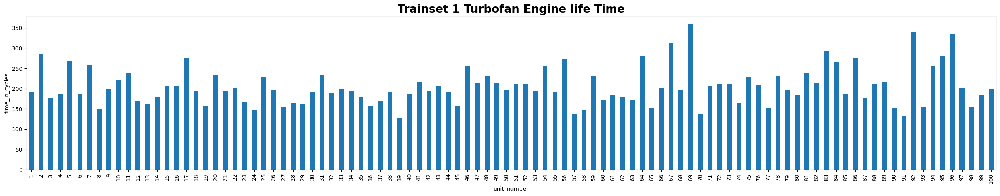

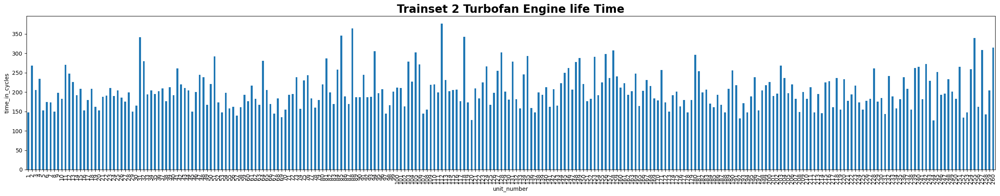

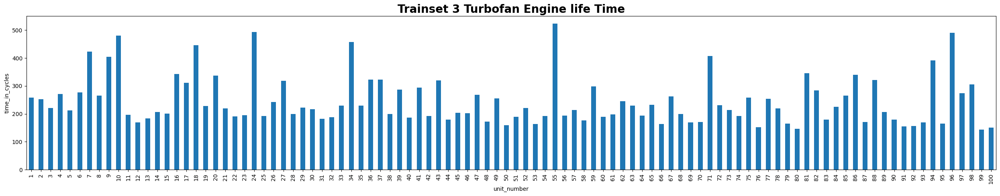

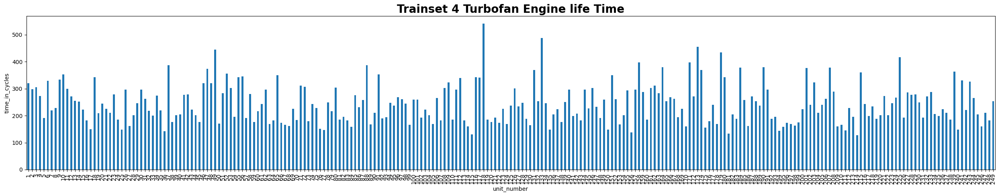

In [ ]:
for i, df in enumerate(train_dfs):
    max_times = df.groupby('unit_number')['RUL'].max()

    plt.figure(figsize=(25,5))
    max_times.plot(kind='bar')
    plt.title(f'Trainset {i+1} Turbofan Engine life Time', fontweight='bold', size=20)
    plt.ylabel('time_in_cycles')
    # plt.grid(True)
    plt.tight_layout()
    plt.show()

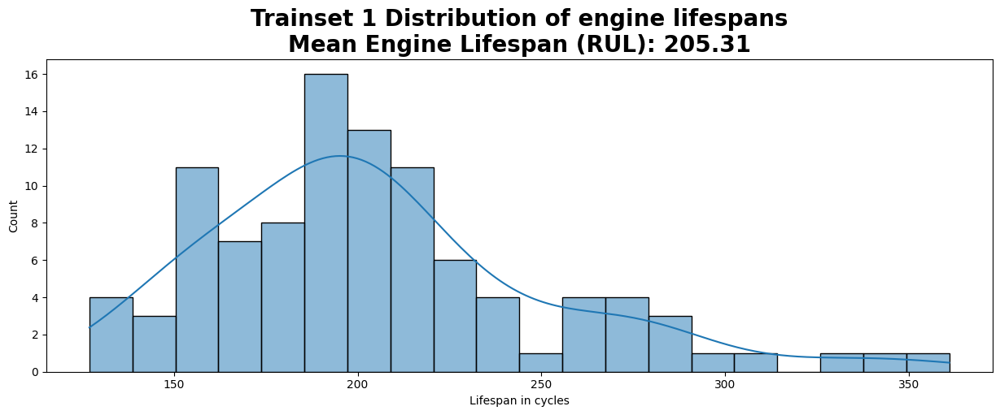

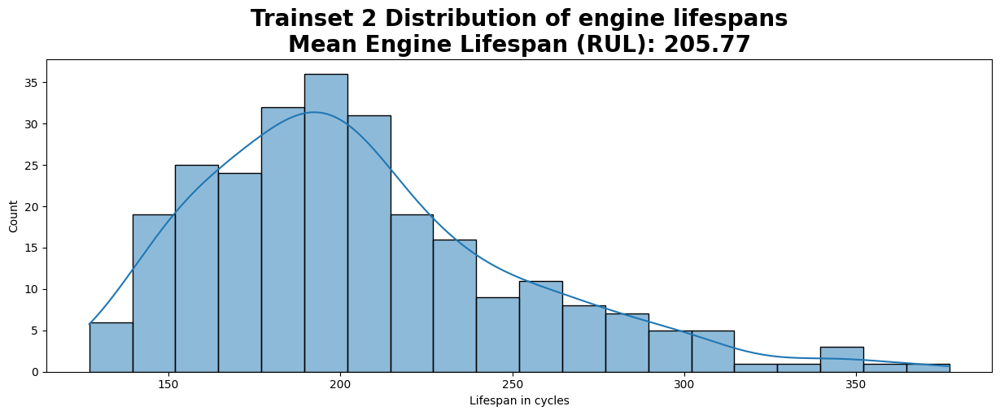

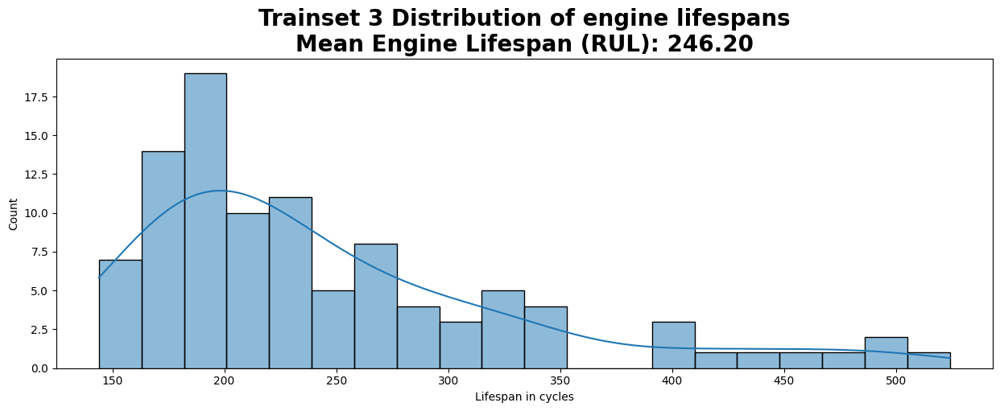

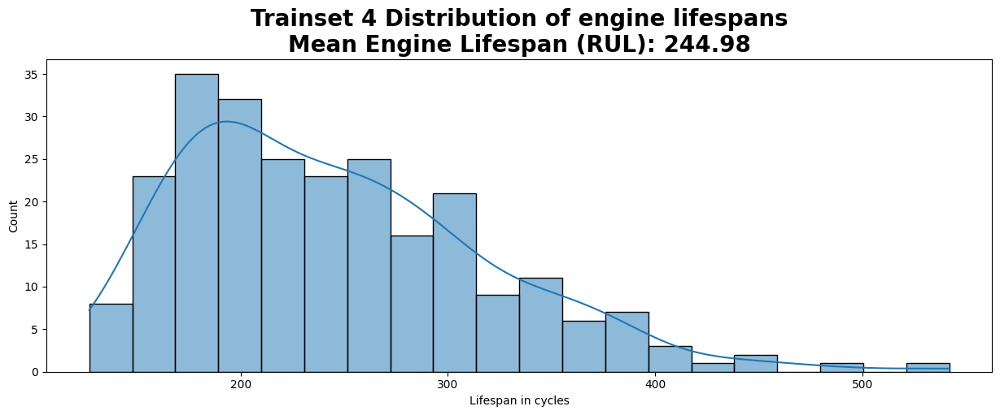

In [ ]:
for i, df in enumerate(train_dfs):
    fig, ax = plt.subplots(figsize=(15,5))
    # plt.hist(df.groupby('unit_number')['RUL'].max(), bins=20, edgecolor='black', density=True)
    rul_max_df = df.groupby('unit_number')['RUL'].max()
    sns.histplot(rul_max_df, bins=20, kde=True, ax=ax)

    plt.title(f'Trainset {i+1} Distribution of engine lifespans\nMean Engine Lifespan (RUL): {rul_max_df.mean():.2f}', fontweight='bold', size=20)
    plt.ylabel('Count')
    plt.xlabel('Lifespan in cycles')
    fig.show()

The data present in the test set are different. Unlike the train set, we only observe the data of each engine up till a certain point BEFORE failure. Thus we do not know exactly how the engine behaves before it fails.

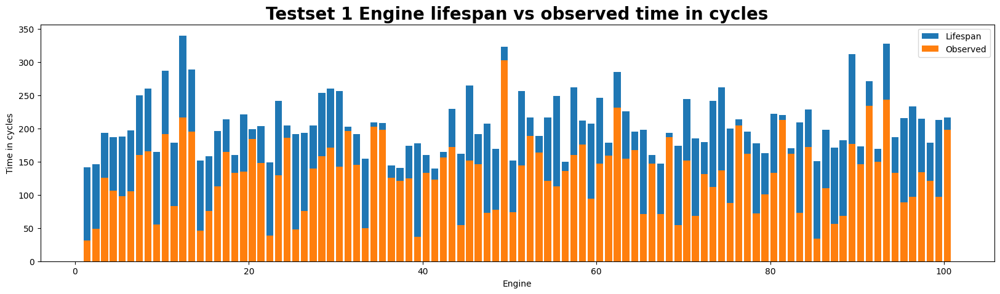

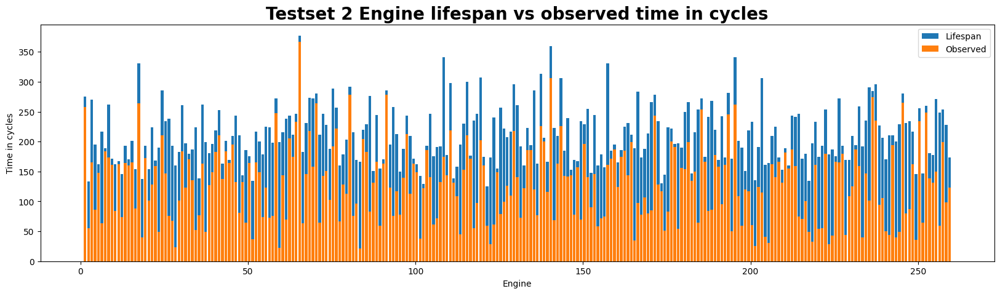

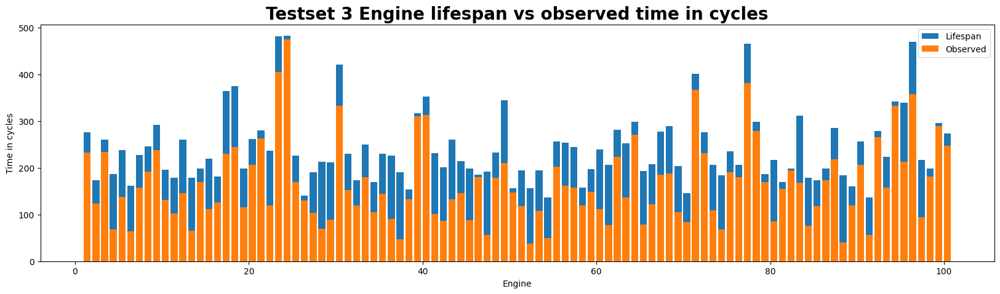

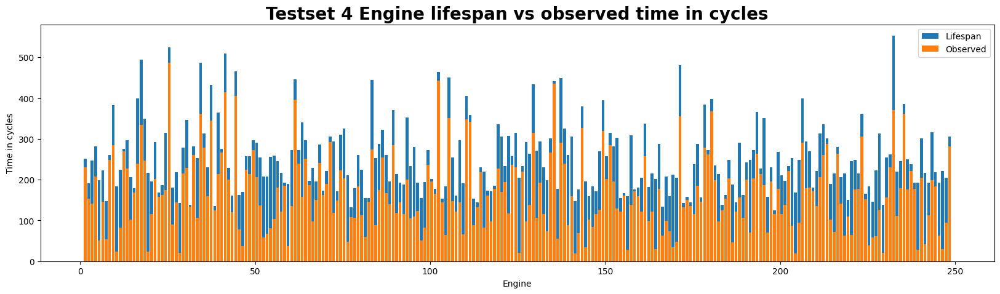

In [ ]:
for i, df in enumerate(test_dfs):
    fig = plt.figure(figsize=(20,5))
    bars = [
                plt.bar(df.groupby('unit_number')['RUL'].max().index, df.groupby('unit_number')['RUL'].max(), align='edge', label='Lifespan'),
                plt.bar(df.groupby('unit_number')['time_in_cycles'].max().index, df.groupby('unit_number')['time_in_cycles'].max(), align='edge', label='Observed'),
            ]
    plt.legend()
    plt.ylabel('Time in cycles')
    plt.xlabel('Engine')
    plt.title(f'Testset {i+1} Engine lifespan vs observed time in cycles', fontweight='bold', size=20)
    fig.show()

As we can see, the test set gives us a challenging variety of scenarios. Some of the engines given fail soon after we finish observing them while some others fail long after we finish observing them.

## Computing correlation matrix

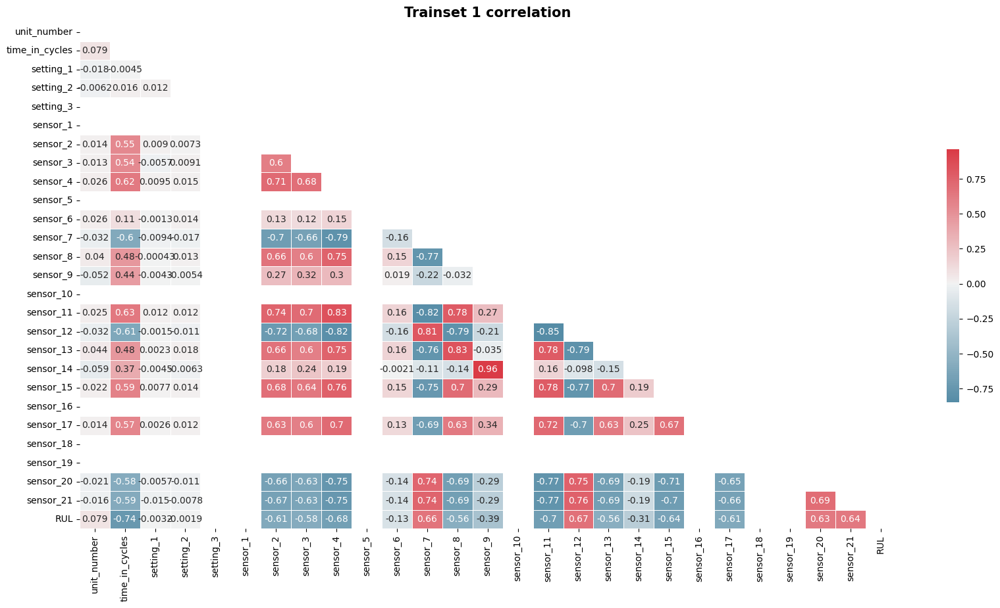

In [ ]:
fig = plt.figure(figsize=(20,10))
mask = np.triu(np.ones_like(fd_1_train.corr(), dtype=bool))
cmap = sns.diverging_palette(230, 10, as_cmap=True)
sns.heatmap(fd_1_train.corr(), mask=mask, annot=True, cmap=cmap, center=0, linewidths=0.5, cbar_kws={"shrink": .5})
fig=plt.gcf()
plt.title('Trainset 1 correlation', fontweight='bold', size=15)
fig.show()

In [ ]:
display(fd_1_train.corr()['RUL'].abs().sort_values(ascending=False))

RUL               1.000000
time_in_cycles    0.736241
sensor_11         0.696228
sensor_4          0.678948
sensor_12         0.671983
sensor_7          0.657223
sensor_15         0.642667
sensor_21         0.635662
sensor_20         0.629428
sensor_2          0.606484
sensor_17         0.606154
sensor_3          0.584520
sensor_8          0.563968
sensor_13         0.562569
sensor_9          0.390102
sensor_14         0.306769
sensor_6          0.128348
unit_number       0.078753
setting_1         0.003198
setting_2         0.001948
setting_3              NaN
sensor_1               NaN
sensor_5               NaN
sensor_10              NaN
sensor_16              NaN
sensor_18              NaN
sensor_19              NaN
Name: RUL, dtype: float64

In [ ]:
high_corr = fd_1_train.corr().unstack().sort_values(ascending=False)
high_corr_pairs = high_corr[(high_corr > 0.5) * (high_corr < 1.0)]
high_corr_pairs

sensor_9        sensor_14         0.963157
sensor_14       sensor_9          0.963157
sensor_4        sensor_11         0.830136
sensor_11       sensor_4          0.830136
sensor_13       sensor_8          0.826084
sensor_8        sensor_13         0.826084
sensor_7        sensor_12         0.812713
sensor_12       sensor_7          0.812713
sensor_8        sensor_11         0.782213
sensor_11       sensor_8          0.782213
sensor_15       sensor_11         0.780913
sensor_11       sensor_15         0.780913
sensor_13       sensor_11         0.780761
sensor_11       sensor_13         0.780761
sensor_15       sensor_4          0.758459
sensor_4        sensor_15         0.758459
sensor_21       sensor_12         0.756263
sensor_12       sensor_21         0.756263
                sensor_20         0.751943
sensor_20       sensor_12         0.751943
sensor_4        sensor_8          0.746852
sensor_8        sensor_4          0.746852
sensor_4        sensor_13         0.745158
sensor_13  

In [ ]:
tuples = high_corr_pairs.index.tolist()
unique_tuples = set()
for tup in tuples:
  sorted_tup = tuple(sorted(set(tup)))
  unique_tuples.add(sorted_tup)
  print(sorted_tup)

('sensor_14', 'sensor_9')
('sensor_14', 'sensor_9')
('sensor_11', 'sensor_4')
('sensor_11', 'sensor_4')
('sensor_13', 'sensor_8')
('sensor_13', 'sensor_8')
('sensor_12', 'sensor_7')
('sensor_12', 'sensor_7')
('sensor_11', 'sensor_8')
('sensor_11', 'sensor_8')
('sensor_11', 'sensor_15')
('sensor_11', 'sensor_15')
('sensor_11', 'sensor_13')
('sensor_11', 'sensor_13')
('sensor_15', 'sensor_4')
('sensor_15', 'sensor_4')
('sensor_12', 'sensor_21')
('sensor_12', 'sensor_21')
('sensor_12', 'sensor_20')
('sensor_12', 'sensor_20')
('sensor_4', 'sensor_8')
('sensor_4', 'sensor_8')
('sensor_13', 'sensor_4')
('sensor_13', 'sensor_4')
('sensor_11', 'sensor_2')
('sensor_11', 'sensor_2')
('sensor_21', 'sensor_7')
('sensor_21', 'sensor_7')
('sensor_20', 'sensor_7')
('sensor_20', 'sensor_7')
('sensor_11', 'sensor_17')
('sensor_11', 'sensor_17')
('sensor_2', 'sensor_4')
('sensor_2', 'sensor_4')
('sensor_17', 'sensor_4')
('sensor_17', 'sensor_4')
('sensor_15', 'sensor_8')
('sensor_15', 'sensor_8')
('sens

Points to note:
- Some features have strong correlations with RUL and other have very weak correlation -> Feature selection to reduce dimensions might be helpful
- Some sensor data have strong correlation with each other, we have to consider the risks of multicolinearity here and might have to select features to reduce their effect on prediction models
- Some features have NaN values in the correlation matrix because their values are stationary throughout.

## Visualisation of evolution of features as engines reach failure

Only visualise the first 20 engines for better visualisation

In [ ]:
# # fd1
# for feature in fd_1_train.columns[2:]:
#   fig = go.Figure()
#   for machine in fd_1_train['unit_number'].unique()[:20]:
#     df_tmp = fd_1_train[fd_1_train['unit_number'] == machine]

#     fig.add_trace(
#         go.Scatter(x=df_tmp['time_in_cycles'], y=df_tmp[feature], name='engine'+str(machine))
#     )
#   fig.update_layout(title=feature)
#   fig.show()

In [ ]:
# Define the number of columns for subplots
columns = 2
# Calculate the required number of rows for subplots based on the number of features
rows = (len(fd_1_train.columns[2:]) + columns - 1) // columns

# Create the subplots
subplot_titles = [f"{feature}" for feature in fd_1_train.columns[2:]]
fig = make_subplots(rows=rows, cols=columns, subplot_titles=subplot_titles, horizontal_spacing=0.015, vertical_spacing=0.01)

# Index to keep track of the current subplot
subplot_index = 1

# Iterate over each feature
for feature in fd_1_train.columns[2:]:
  # Iterate over the first 20 machines
  for machine in fd_1_train['unit_number'].unique()[:20]:
    df_tmp = fd_1_train[fd_1_train['unit_number'] == machine]

    # Determine the current row and column in the subplot grid
    row = (subplot_index - 1) // columns + 1
    col = (subplot_index - 1) % columns + 1

    # Add trace to the appropriate subplot
    fig.add_trace(
        go.Scatter(x=df_tmp['time_in_cycles'], y=df_tmp[feature], name='engine'+str(machine)),
        row=row, col=col
    )

  # Increment subplot index after adding traces for each machine of the current feature
  subplot_index += 1

# Update layout if needed (e.g., for better spacing or adding a global title)
fig.update_layout(height=300*rows, title_text="Plot for each feature")

# Show the plot
fig.show()

In [ ]:
# fd2
df = fd_2_train
columns = 2
rows = (len(df.columns[2:]) + columns - 1) // columns

subplot_titles = [f"{feature}" for feature in df.columns[2:]]
fig = make_subplots(rows=rows, cols=columns, subplot_titles=subplot_titles, horizontal_spacing=0.015, vertical_spacing=0.01)

subplot_index = 1

for feature in df.columns[2:]:
  for machine in df['unit_number'].unique()[:5]:
    df_tmp = df[df['unit_number'] == machine]

    row = (subplot_index - 1) // columns + 1
    col = (subplot_index - 1) % columns + 1

    fig.add_trace(
        go.Scatter(x=df_tmp['time_in_cycles'], y=df_tmp[feature], name='engine'+str(machine)),
        row=row, col=col
    )

  subplot_index += 1

fig.update_layout(height=300*rows, title_text="Plot for each feature")
fig.show()

In [ ]:
# fd3
df = fd_3_train
columns = 2
rows = (len(df.columns[2:]) + columns - 1) // columns

subplot_titles = [f"{feature}" for feature in df.columns[2:]]
fig = make_subplots(rows=rows, cols=columns, subplot_titles=subplot_titles, horizontal_spacing=0.015, vertical_spacing=0.01)

subplot_index = 1

for feature in df.columns[2:]:
  for machine in df['unit_number'].unique()[:5]:
    df_tmp = df[df['unit_number'] == machine]

    row = (subplot_index - 1) // columns + 1
    col = (subplot_index - 1) % columns + 1

    fig.add_trace(
        go.Scatter(x=df_tmp['time_in_cycles'], y=df_tmp[feature], name='engine'+str(machine)),
        row=row, col=col
    )

  subplot_index += 1

fig.update_layout(height=300*rows, title_text="Plot for each feature")
fig.show()

In [ ]:
# fd4
df = fd_4_train
columns = 2
rows = (len(df.columns[2:]) + columns - 1) // columns

subplot_titles = [f"{feature}" for feature in df.columns[2:]]
fig = make_subplots(rows=rows, cols=columns, subplot_titles=subplot_titles, horizontal_spacing=0.015, vertical_spacing=0.01)

subplot_index = 1

for feature in df.columns[2:]:
  for machine in df['unit_number'].unique()[:5]:
    df_tmp = df[df['unit_number'] == machine]

    row = (subplot_index - 1) // columns + 1
    col = (subplot_index - 1) % columns + 1

    fig.add_trace(
        go.Scatter(x=df_tmp['time_in_cycles'], y=df_tmp[feature], name='engine'+str(machine)),
        row=row, col=col
    )

  subplot_index += 1

fig.update_layout(height=300*rows, title_text="Plot for each feature")
fig.show()

Some sensors are constant (that would explain the 0 correlation) so we can drop them later. However just because the sensor in one train set is constant doesnt mean it is constant in all the other trainsets. Another thing to also note is that the sensor values in trainset 4 seem to be normalised or winsorised. Note that while the magnitude of the corresponding sensor values across datasets are in the same ballpark, the behaviours can vary quite a lot. For example, sensor values in trainset 4 seem to span a much wider range compared to trainset 3.

## Distribution of Data

In [ ]:
columns = 3
features = df.columns[2:-1]
rows = (len(features) + columns - 1) // columns
fig = make_subplots(rows=rows, cols=columns, subplot_titles=features)

for i, feature in enumerate(features, 1):
    row = (i-1) // columns + 1
    col = (i-1) % columns + 1
    for j in range(len(train_dfs)):
        df = train_dfs[j]
        fig.add_trace(go.Histogram(x=df[feature], nbinsx=50,
                                   name=f'fd{j+1}',
                                   marker=dict(opacity=1-j*0.2)),
                      row=row, col=col)

fig.update_layout(title_text='Feature Distributions across all trainsets',
                  height=300 * rows, width=400 * columns,
                  showlegend=True)

for i in range(len(features)):
    fig['layout']['xaxis'+str(i+1)].title = features[i]
    fig['layout']['yaxis'+str(i+1)].title = 'Count'

fig.update_layout(margin=dict(t=100))
fig.show();

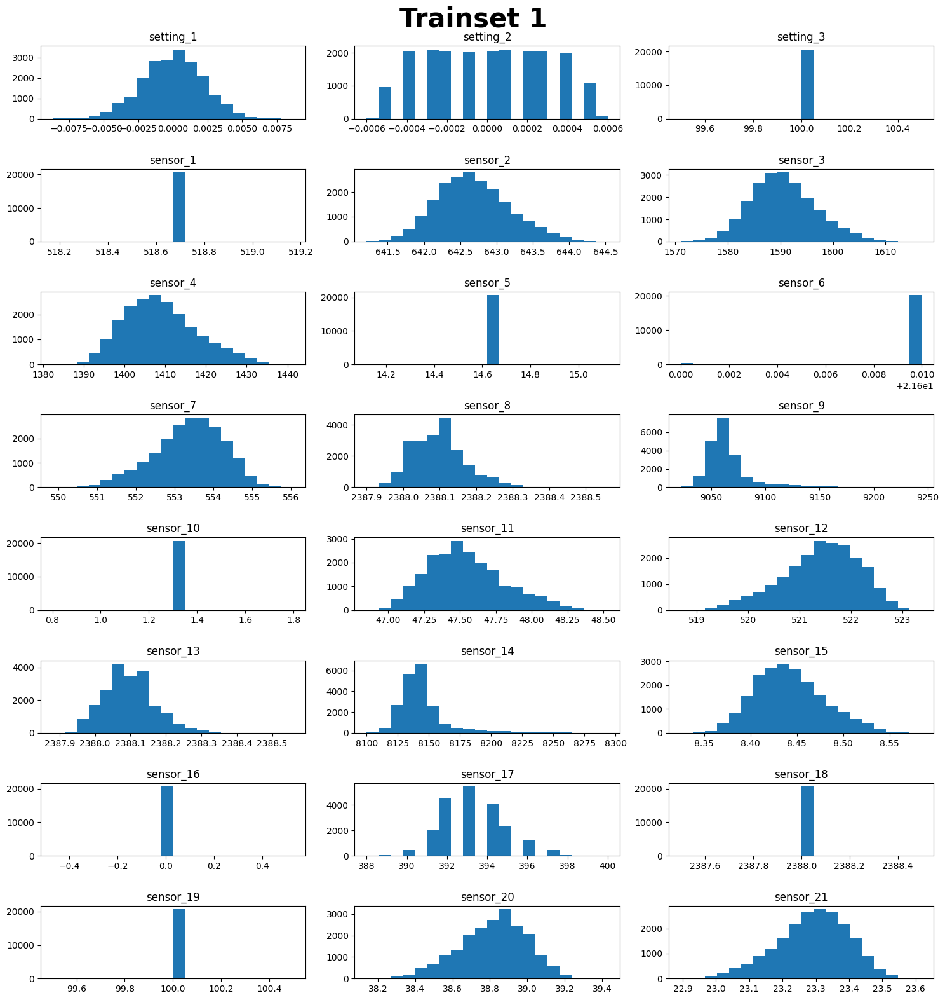

In [ ]:
# fd1
df = fd_1_train

columns = 3
rows = (len(df.columns[2:-1]) + columns - 1) // columns
fig, axs = plt.subplots(rows, columns, figsize=(5 * columns, 2 * rows))
axs = axs.flatten()

for i, feature in enumerate(df.columns[2:-1]):
    ax = axs[i]

    ax.hist(df[feature], bins=20)

    ax.set_title(f"{feature}")

fig.suptitle('Trainset 1', fontweight='bold', size=30)
plt.tight_layout()
plt.show()

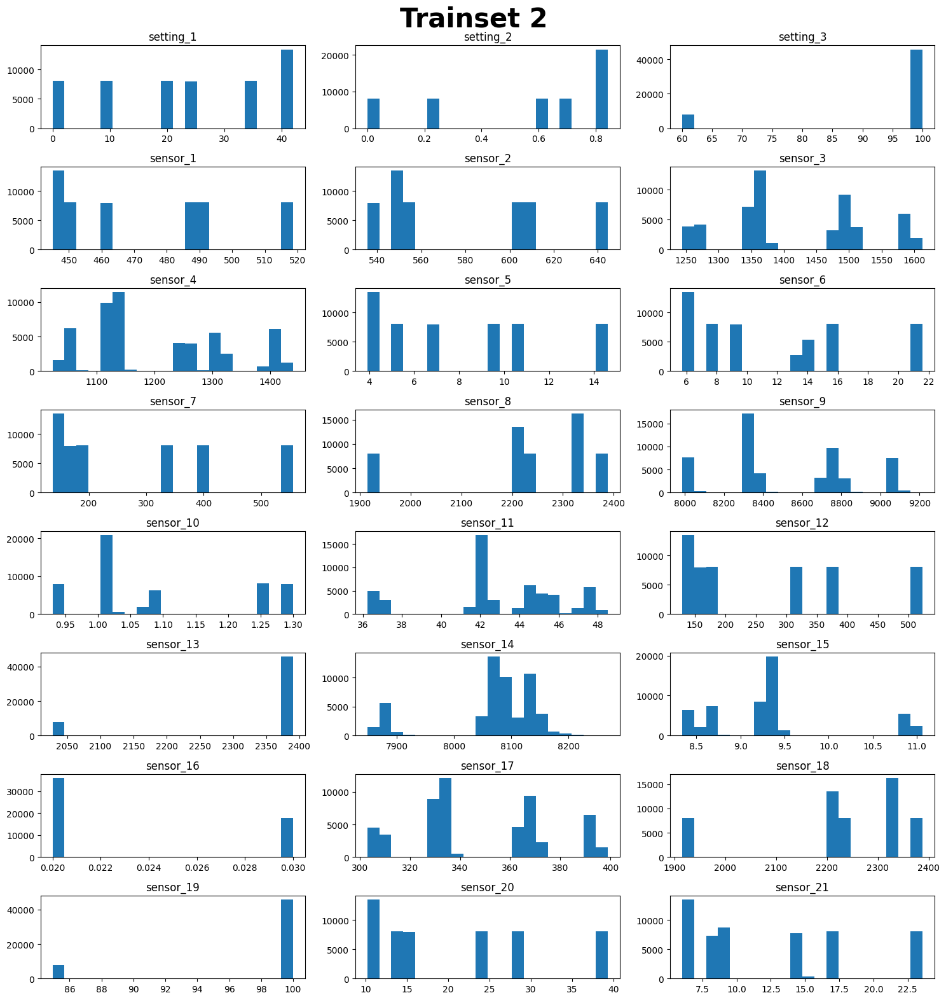

In [ ]:
# fd2
df = fd_2_train

columns = 3
rows = (len(df.columns[2:-1]) + columns - 1) // columns
fig, axs = plt.subplots(rows, columns, figsize=(5 * columns, 2 * rows))
axs = axs.flatten()

for i, feature in enumerate(df.columns[2:-1]):
    ax = axs[i]

    ax.hist(df[feature], bins=20)

    ax.set_title(f"{feature}")

fig.suptitle('Trainset 2', fontweight='bold', size=30)
plt.tight_layout()
plt.show()

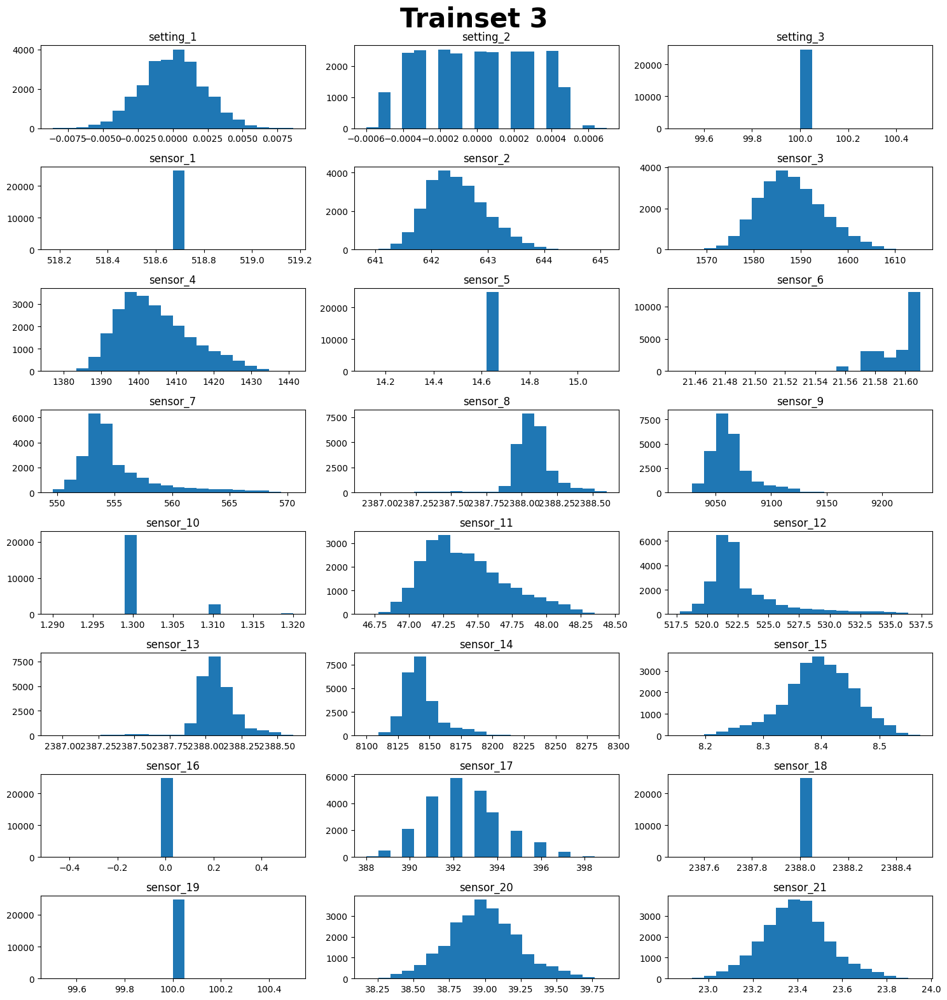

In [ ]:
# fd3
df = fd_3_train

columns = 3
rows = (len(df.columns[2:-1]) + columns - 1) // columns
fig, axs = plt.subplots(rows, columns, figsize=(5 * columns, 2 * rows))
axs = axs.flatten()

for i, feature in enumerate(df.columns[2:-1]):
    ax = axs[i]

    ax.hist(df[feature], bins=20)

    ax.set_title(f"{feature}")

fig.suptitle('Trainset 3', fontweight='bold', size=30)
plt.tight_layout()
plt.show()

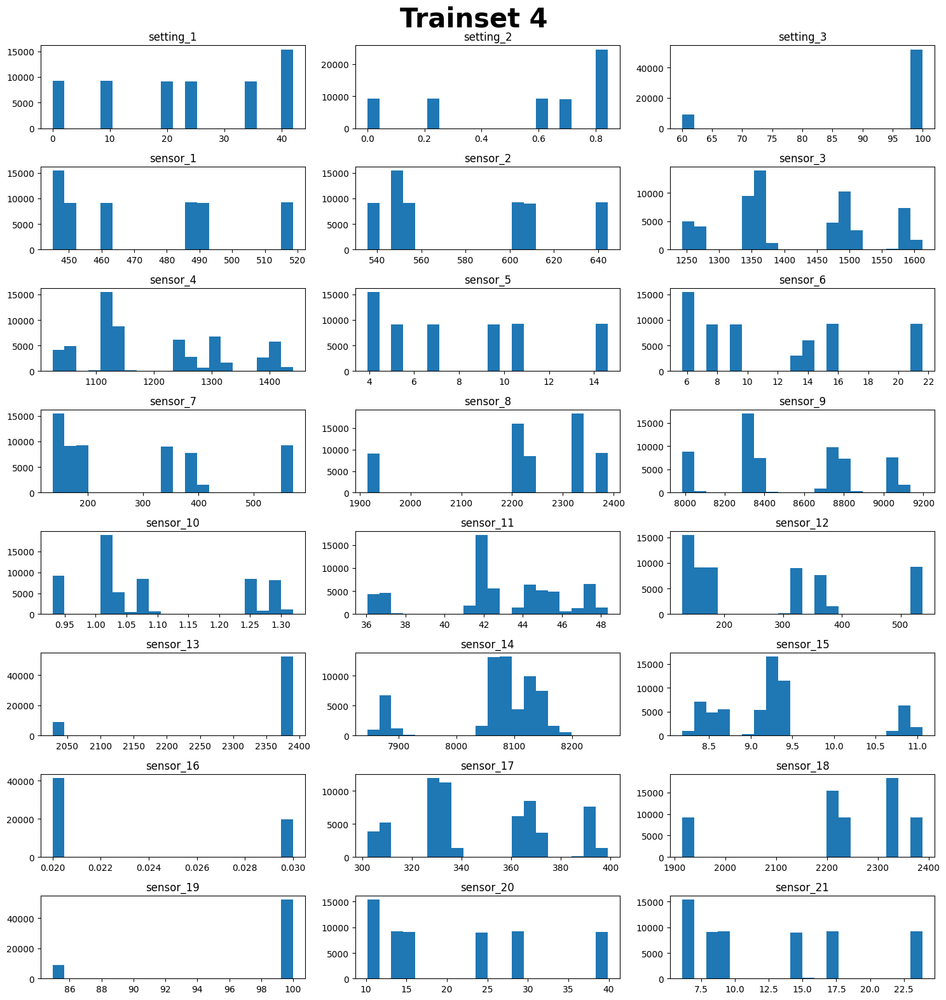

In [ ]:
# fd4
df = fd_4_train

columns = 3
rows = (len(df.columns[2:-1]) + columns - 1) // columns
fig, axs = plt.subplots(rows, columns, figsize=(5 * columns, 2 * rows))
axs = axs.flatten()

for i, feature in enumerate(df.columns[2:-1]):
    ax = axs[i]

    ax.hist(df[feature], bins=20)

    ax.set_title(f"{feature}")

fig.suptitle('Trainset 4', fontweight='bold', size=30)
plt.tight_layout()
plt.show()

# Check for Autocorrelation/Stationarity

Here, we visualise the autocorrelation of sensor data for machine 1 of dataset 1 to check for autocorrelation and see whether there is a need for further feature engineering to make our data stationary later

/usr/local/lib/python3.10/dist-packages/statsmodels/tsa/stattools.py:693: RuntimeWarning:

divide by zero encountered in divide

/usr/local/lib/python3.10/dist-packages/statsmodels/tsa/stattools.py:693: RuntimeWarning:

invalid value encountered in divide

/usr/local/lib/python3.10/dist-packages/matplotlib/axes/_base.py:2503: UserWarning:




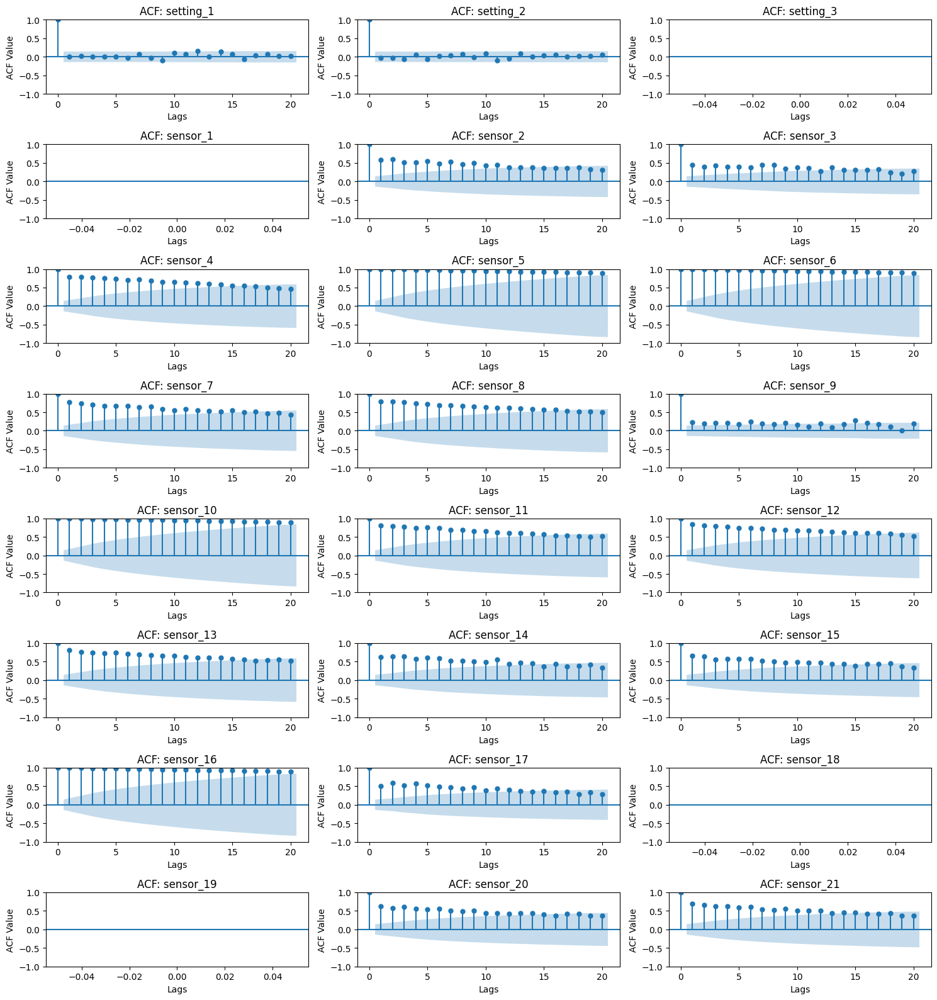

In [ ]:
machine = 1

# Define the number of columns for subplots
columns = 3
# Calculate the required number of rows for subplots
rows = (len(fd_1_train.columns[2:-1]) + columns - 1) // columns

# Create a figure and a grid of subplots
fig, axs = plt.subplots(rows, columns, figsize=(5 * columns, 2 * rows))

# Flatten the array of axes for easy iteration
axs = axs.flatten()

# Iterate over the features and create an ACF plot for each
for i, feature in enumerate(fd_1_train.columns[2:-1]):
    # Select the appropriate subplot
    ax = axs[i]

    # Plot the ACF on the chosen subplot axis
    plot_acf(fd_1_train[fd_1_train['unit_number'] == machine][feature], lags=20, ax=ax)

    # Set the title, xlabel and ylabel for the subplot
    ax.set_title(f"ACF: {feature}")
    ax.set_xlabel("Lags")
    ax.set_ylabel("ACF Value")

# Adjust layout so titles, labels and ticks don't overlap
plt.tight_layout()

# Show the plot
plt.show()

It seems that most of the sensor data are autocorrelated. This is expected for sensor data where we are typically measuring real world measures like temperature that do not drastically change between each time step and are dependent on their previous value

## ADF test

In [ ]:
def adf_test(series: pd.Series, p_value=0.05) -> bool:
    """
    returns True if series is stationary
    """
    adftest = adfuller(series, autolag='AIC', regression='ct')
    p_val = adftest[1]
    return p_val < p_value

In [ ]:
for i, df in enumerate(train_dfs):
    print(f"---------TRAIN DF {i+1}---------")
    for feature in df.columns[2:-1]:
        non_stationary_machines = []
        for machine in df['unit_number'].unique():
            try:
                if not adf_test(df[df['unit_number'] == machine][feature]):
                    non_stationary_machines.append(machine)
            except Exception:
                print(f'ADF test failed on {feature}')
                break
        if non_stationary_machines:
            if len(non_stationary_machines) == len(df['unit_number'].unique()):
                non_stationary_machines = 'ALL MACHINES'
            print(f"train_{i+1} - {feature} - machine {non_stationary_machines}: NOT Stationary")



---------TRAIN DF 1---------
ADF test failed on setting_3
ADF test failed on sensor_1
train_1 - sensor_2 - machine [1, 2, 3, 4, 5, 7, 10, 11, 15, 16, 18, 21, 27, 28, 30, 31, 33, 35, 37, 40, 42, 44, 45, 46, 47, 48, 51, 52, 53, 54, 55, 56, 57, 59, 61, 64, 68, 69, 70, 71, 76, 78, 79, 82, 83, 84, 85, 88, 89, 90, 92, 93, 94, 95, 96, 97, 99]: NOT Stationary
train_1 - sensor_3 - machine [1, 3, 4, 5, 7, 10, 11, 13, 15, 17, 18, 21, 22, 24, 25, 26, 27, 28, 30, 31, 32, 35, 37, 39, 40, 41, 43, 45, 47, 48, 51, 53, 54, 55, 56, 58, 61, 64, 68, 69, 72, 74, 76, 79, 80, 82, 83, 89, 90, 92, 93, 95, 97, 98, 99]: NOT Stationary
train_1 - sensor_4 - machine [1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 19, 20, 21, 22, 23, 24, 25, 26, 28, 29, 30, 31, 32, 33, 34, 35, 37, 38, 39, 40, 41, 42, 43, 44, 45, 46, 47, 48, 49, 50, 51, 52, 54, 55, 56, 57, 58, 59, 60, 61, 63, 64, 65, 66, 67, 68, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79, 80, 81, 82, 83, 84, 85, 86, 87, 88, 89, 90, 91, 92, 93, 94, 95, 

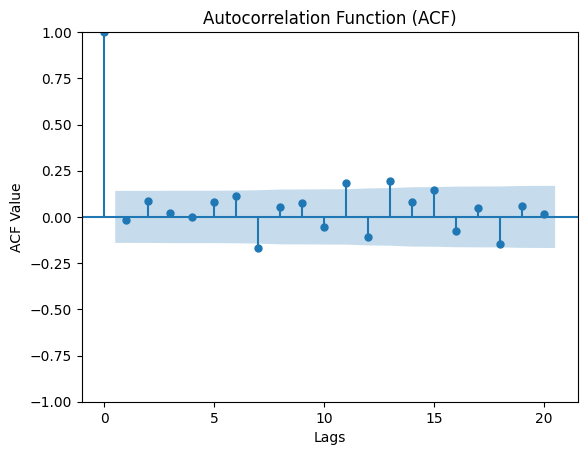

ADF TEST: False


In [ ]:
# BLOCK OF CODE TO INVESTIGATE A SINGLE FEATURE OF A SINGLE MACHINE
df = fd_2_train
machine = 59
feature = 'sensor_21'

px.line(df[df['unit_number'] == machine][feature]).show()

plot_acf(df[df['unit_number'] == machine][feature], lags=20)
plt.title("Autocorrelation Function (ACF)")
plt.xlabel("Lags")
plt.ylabel("ACF Value")
plt.show()
print(f"ADF TEST:", adf_test(df[df['unit_number'] == machine][feature]))

# Feature Engineering, Preprocessing

- Removing features that are constant

Note that the features removed are different for different train sets. Also note that there are some features with only 2 unique values, we treat them as categorical features.

In [ ]:
for train_df, test_df in zip(train_dfs, test_dfs):
  print(train_df.nunique())
  print()
  print(test_df.nunique())
  print("\n\n")

unit_number        100
time_in_cycles     362
setting_1          158
setting_2           13
setting_3            1
sensor_1             1
sensor_2           310
sensor_3          3012
sensor_4          4051
sensor_5             1
sensor_6             2
sensor_7           513
sensor_8            53
sensor_9          6403
sensor_10            1
sensor_11          159
sensor_12          427
sensor_13           56
sensor_14         6078
sensor_15         1918
sensor_16            1
sensor_17           13
sensor_18            1
sensor_19            1
sensor_20          120
sensor_21         4745
RUL                362
dtype: int64

unit_number        100
time_in_cycles     303
setting_1          150
setting_2           14
setting_3            1
sensor_1             1
sensor_2           262
sensor_3          2361
sensor_4          2954
sensor_5             1
sensor_6             2
sensor_7           415
sensor_8            41
sensor_9          4047
sensor_10            1
sensor_11          1

In [ ]:
for train_df, test_df in zip(train_dfs, test_dfs):
  rm_cols = []
  cat_cols = []
  for c in train_df.columns:
    if train_df[c].nunique() == 1:
      rm_cols.append(c)
    elif train_df[c].nunique() == 2:
      train_df[c] = train_df[c].astype('category')
      cat_cols.append(c)

  train_df.drop(rm_cols, axis=1, inplace=True)
  test_df.drop(rm_cols, axis=1, inplace=True)

  print(f"Columns removed: {rm_cols}")
  print(f'Features changed to categorical: {cat_cols}')
  print(f'Train shape: {train_df.shape}, Test shape: {test_df.shape}')
  print()

Columns removed: ['setting_3', 'sensor_1', 'sensor_5', 'sensor_10', 'sensor_16', 'sensor_18', 'sensor_19']
Features changed to categorical: ['sensor_6']
Train shape: (20631, 20), Test shape: (13096, 20)

Columns removed: []
Features changed to categorical: ['setting_3', 'sensor_16', 'sensor_19']
Train shape: (53759, 27), Test shape: (33991, 27)

Columns removed: ['setting_3', 'sensor_1', 'sensor_5', 'sensor_16', 'sensor_18', 'sensor_19']
Features changed to categorical: []
Train shape: (24720, 21), Test shape: (16596, 21)

Columns removed: []
Features changed to categorical: ['setting_3', 'sensor_16', 'sensor_19']
Train shape: (61249, 27), Test shape: (41214, 27)



Adding labels for target variables for classification
- 0 for no risk
- 1 for at risk

Assume the cut off for no risk/at risk as follows:
- No risk: RUL > 60
- At risk: RUL <= 60


We see below that this is a clearly unbalanced dataset, so we should not just depend on classification Accuracy as a model performance metric. So we use AUC ROC instead.

In [ ]:
for i, (train_df, test_df) in enumerate(zip(train_dfs, test_dfs)):
  bins = [0, 60, max(df.RUL)]
  labels = [1,0]
  train_df['RUL_label'] = pd.cut(train_df['RUL'], bins=bins, labels=labels, include_lowest=True)
  test_df['RUL_label'] = pd.cut(test_df['RUL'], bins=bins, labels=labels, include_lowest=True)

  print(f'Trainset {i+1}')
  display(train_df['RUL_label'].value_counts())
  train_norisk = train_df[train_df.RUL_label == 0].shape[0]/train_df.shape[0]*100
  train_risk = train_df[train_df.RUL_label == 1].shape[0]/train_df.shape[0]*100
  print(f'No Risk %: {train_norisk:.2f}, At Risk %: {train_risk:.2f}\n')

  print(f'Testset {i+1}')
  display(test_df['RUL_label'].value_counts())
  test_norisk = test_df[test_df.RUL_label == 0].shape[0]/test_df.shape[0]*100
  test_risk = test_df[test_df.RUL_label == 1].shape[0]/test_df.shape[0]*100
  print(f'No Risk %: {test_norisk:.2f}, At Risk %: {test_risk:.2f}\n')

Trainset 1


RUL_label
0    14531
1     6100
Name: count, dtype: int64

No Risk %: 70.43, At Risk %: 29.57

Testset 1


RUL_label
0    11856
1     1240
Name: count, dtype: int64

No Risk %: 90.53, At Risk %: 9.47

Trainset 2


RUL_label
0    37899
1    15860
Name: count, dtype: int64

No Risk %: 70.50, At Risk %: 29.50

Testset 2


RUL_label
0    30431
1     3560
Name: count, dtype: int64

No Risk %: 89.53, At Risk %: 10.47

Trainset 3


RUL_label
0    18620
1     6100
Name: count, dtype: int64

No Risk %: 75.32, At Risk %: 24.68

Testset 3


RUL_label
0    15456
1     1140
Name: count, dtype: int64

No Risk %: 93.13, At Risk %: 6.87

Trainset 4


RUL_label
0    46060
1    15189
Name: count, dtype: int64

No Risk %: 75.20, At Risk %: 24.80

Testset 4


RUL_label
0    38117
1     3097
Name: count, dtype: int64

No Risk %: 92.49, At Risk %: 7.51



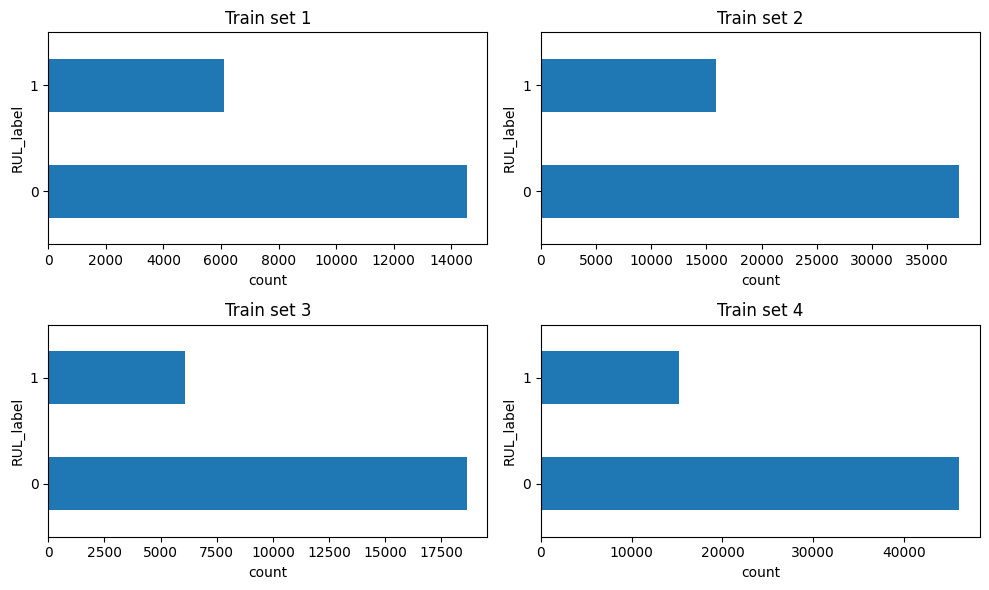

In [ ]:
f, axes = plt.subplots(2,2,figsize=(10,6))
ax = axes.flatten()
for i in range(len(train_dfs)):
  df = train_dfs[i]
  df.RUL_label.value_counts().plot.barh(ax=ax[i])
  ax[i].set_xlabel('count')
  ax[i].set_title(f'Train set {i+1}')
plt.tight_layout()
plt.show();

- Create historical ts features (using MAs)

As seen from the ADF plots above, most sensors are serially autocorrelated. We can factor in temporal effects with moving averages for sensors

In [ ]:
def add_ma(df, selected_cols, window=10):
  ma_df = pd.DataFrame()
  unique_engines = df['unit_number'].unique()

  for unit in unique_engines:
    engine_data = df[df['unit_number']==unit]
    ma = engine_data[selected_cols].rolling(window=window).mean()
    ma.columns = [f'{col}_ma_{window}' for col in selected_cols]
    combined_data = pd.concat([engine_data, ma], axis=1)
    ma_df = pd.concat([ma_df, combined_data], axis=0)

  return ma_df

In [ ]:
for i, (train_df, test_df) in enumerate(zip(train_dfs, test_dfs)):
  selected_cols = train_df.select_dtypes(include=np.number).columns
  selected_cols = [c for c in selected_cols if 'sensor_' in c or 'setting_' in c]
  train_dfs[i] = add_ma(train_df, selected_cols)
  test_dfs[i] = add_ma(test_df, selected_cols)
  print(f'Train shape: {train_dfs[i].shape}, Test shape: {test_dfs[i].shape}')

Train shape: (20631, 37), Test shape: (13096, 37)
Train shape: (53759, 49), Test shape: (33991, 49)
Train shape: (24720, 40), Test shape: (16596, 40)
Train shape: (61249, 49), Test shape: (41214, 49)


Text(0, 0.5, 'setting 1')

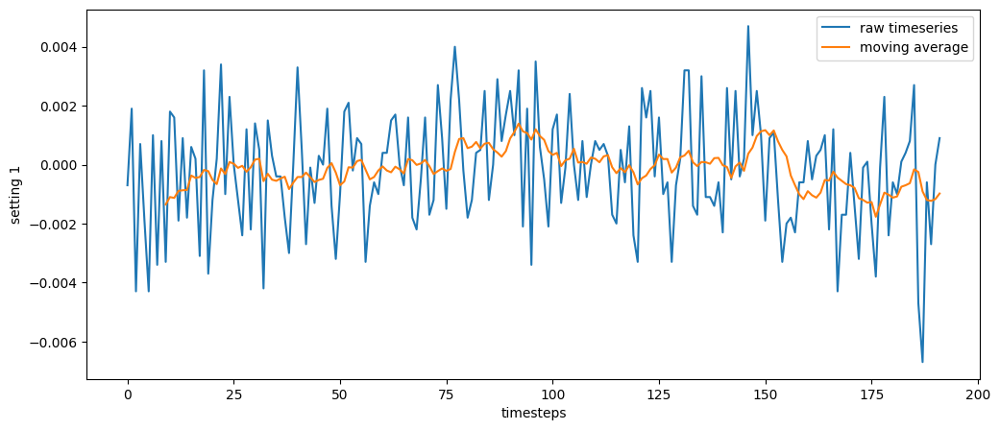

In [ ]:
df1 = train_dfs[0].copy()
f, ax = plt.subplots(figsize=(12,5))
df1.loc[df1.unit_number==1][['setting_1', 'setting_1_ma_10']].plot(ax=ax)
ax.legend(['raw timeseries', 'moving average'])
ax.set_xlabel('timesteps')
ax.set_ylabel('setting 1')

- Time Series Zscore

Each row represents a snapshot in time for measurements of different sensors, settings for each engine (unit_number). We can see that the values for each sensor differ drastically, as a result we have to standardize each one of their time series s.t mean and standard deviation equals 0 and 1 respectively. And now the value of each feature would be a z-score across time.

We could have simply scaled the train and test set values with the entire dataframe's value but we chose to use a rolling standardization technique instead. Using the entire train/test set would incur look ahead bias baked into the calculation of overall mean/SD calculation. However, using the entire train/test set to normalize values could be beneficial in capturing the true volatility of the entire time series. So there's a tradeoff between capturing the whole vol period and slight look ahead bias.

We wanted to be more mathematically rigourous and negate any effects of look ahead bias, but at the same time also try and accurately represent vol. So we chose to use the rolling z-score . Essentially, the first 9 values will be used for MA window. Then the next 9 will be used for rolling z-score calculation.

In [ ]:
def standardize_df(df, cols, window=10):
  standardized_df = df.copy().dropna().reset_index(drop=True)

  rolling_mean = standardized_df.groupby('unit_number')[cols].rolling(window).mean().reset_index(level=1, drop=True).reset_index()
  rolling_std = standardized_df.groupby('unit_number')[cols].rolling(window).std().reset_index(level=1, drop=True).reset_index()
  rolling_std = rolling_std.replace(0,1) # handle std = 0 by replacing it with 1
  standardized_df.loc[:, cols] = standardized_df[cols].sub(rolling_mean[cols]).div(rolling_std[cols])
  standardized_df = standardized_df.dropna().reset_index(drop=True)

  return standardized_df

In [ ]:
scaled_train_dfs = []
scaled_test_dfs = []
for i, (train_df, test_df) in enumerate(zip(train_dfs, test_dfs)):
  selected_cols = train_df.select_dtypes(include=np.number).columns
  selected_cols = [c for c in selected_cols if 'sensor_' in c or 'setting_' in c]
  print(f'DATASET {i+1}, number of unique engines: {train_df.unit_number.nunique()}, {test_df.unit_number.nunique()}')

  old_train_shape = train_dfs[i].shape
  old_test_shape = test_dfs[i].shape

  train = standardize_df(train_df, selected_cols)
  test = standardize_df(test_df, selected_cols)
  scaled_train_dfs.append(train)
  scaled_test_dfs.append(test)
  new_train_shape = train.shape
  new_test_shape = test.shape

  print(f'OLD Train shape: {old_train_shape}, NEW Train shape: {new_train_shape}, Number of rows dropped: {old_train_shape[0]-new_train_shape[0]}')
  print(f'OLD Test shape: {old_test_shape}, NEW Test shape: {new_test_shape}, Number of rows dropped: {old_test_shape[0]-new_test_shape[0]}\n')

DATASET 1, number of unique engines: 100, 100
OLD Train shape: (20631, 37), NEW Train shape: (18831, 37), Number of rows dropped: 1800
OLD Test shape: (13096, 37), NEW Test shape: (11296, 37), Number of rows dropped: 1800

DATASET 2, number of unique engines: 260, 259
OLD Train shape: (53759, 49), NEW Train shape: (49079, 49), Number of rows dropped: 4680
OLD Test shape: (33991, 49), NEW Test shape: (29329, 49), Number of rows dropped: 4662

DATASET 3, number of unique engines: 100, 100
OLD Train shape: (24720, 40), NEW Train shape: (22920, 40), Number of rows dropped: 1800
OLD Test shape: (16596, 40), NEW Test shape: (14796, 40), Number of rows dropped: 1800

DATASET 4, number of unique engines: 249, 248
OLD Train shape: (61249, 49), NEW Train shape: (56767, 49), Number of rows dropped: 4482
OLD Test shape: (41214, 49), NEW Test shape: (36750, 49), Number of rows dropped: 4464



In [ ]:
for i in range(len(scaled_train_dfs)):
  scaled_train_dfs[i].drop(['unit_number', 'time_in_cycles'], axis=1, inplace=True)
  scaled_test_dfs[i].drop(['unit_number', 'time_in_cycles'], axis=1, inplace=True)
  print(f'DATASET {i+1}')
  print(f'NEW Train shape: {scaled_train_dfs[i].shape}, NEW Test Shape: {scaled_test_dfs[i].shape}\n')

DATASET 1
NEW Train shape: (18831, 35), NEW Test Shape: (11296, 35)

DATASET 2
NEW Train shape: (49079, 47), NEW Test Shape: (29329, 47)

DATASET 3
NEW Train shape: (22920, 38), NEW Test Shape: (14796, 38)

DATASET 4
NEW Train shape: (56767, 47), NEW Test Shape: (36750, 47)



Text(0, 0.5, 'standardized sensor 21')

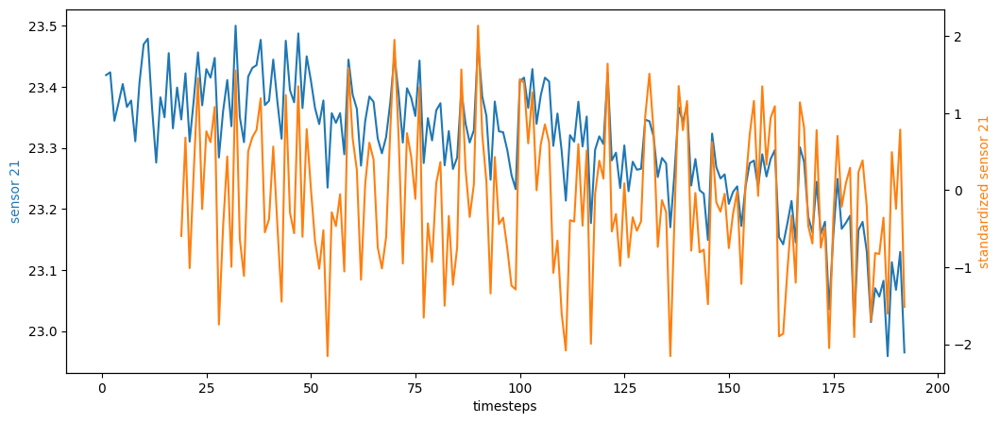

In [ ]:
df1 = train_dfs[0].copy()
df1_standardize = scaled_train_dfs[0].copy()

f, ax = plt.subplots(figsize=(12,5))
ax.plot(df1.loc[df1.unit_number==1].time_in_cycles, df1.loc[df1.unit_number==1].sensor_21)
ax.set_xlabel('timesteps')
ax.set_ylabel('sensor 21', color='C0')

ax_twin = ax.twinx()
ax_twin.plot(df1_standardize.loc[df1_standardize.unit_number==1].time_in_cycles, df1_standardize.loc[df1_standardize.unit_number==1].sensor_21, color='C1')
ax_twin.set_ylabel('standardized sensor 21', color='C1')

# Modelling

Treating this problem as a traditional ML problem, so we can drop unit_number and time_in_cycles features


## Feature Selection w/ Feature Importance

- LASSO Regression

In [ ]:
from sklearn.linear_model import Lasso
from sklearn.ensemble import RandomForestRegressor
from sklearn.model_selection import train_test_split

In [ ]:
def lasso_feature_selection(df, idx):
  print(f'\n--------- DATASET {idx+1} ---------')
  # set data
  X_features = [col for col in df.columns if 'setting_' in col or 'sensor_' in col]
  temp_df = df.dropna()
  X = temp_df[X_features]
  y = temp_df['RUL'].values
  X_train, X_val, y_train, y_val = train_test_split(X, y, test_size=0.3, random_state=42)

  # initialize and fit Lasso model
  lasso = Lasso(alpha=0.1, max_iter=int(1e6))
  lasso.fit(X_train, y_train)

  # plot most important features
  lasso_coef = pd.DataFrame({'coef':lasso.coef_, 'features':X_train.columns})
  lasso_coef = lasso_coef.loc[abs(lasso_coef.coef) > 0].sort_values(by='coef', ascending=False)
  selected_features = set(lasso_coef.features.values)
  print(f'Dropped Features: {[c for c in X_train.columns if c not in selected_features]}')

  f, ax = plt.subplots(figsize=(8,6))
  lasso_coef.plot.barh(x='features', y='coef', ax=ax)
  plt.gca().invert_yaxis()
  plt.title(f'Lasso Coefficients - DATASET {idx+1}')
  plt.tight_layout()
  plt.show();

  return lasso_coef.features.values


--------- DATASET 1 ---------
Dropped Features: ['setting_1', 'sensor_3', 'sensor_6', 'setting_2_ma_10']


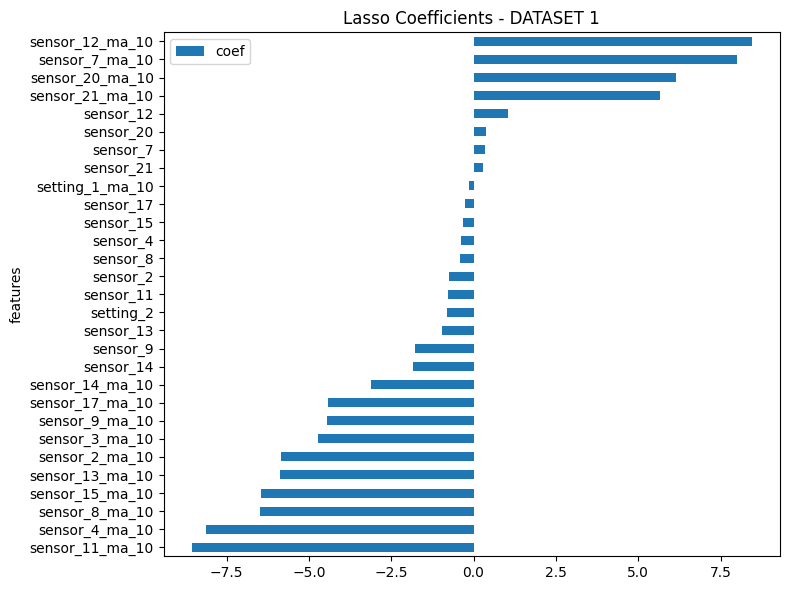


--------- DATASET 2 ---------
Dropped Features: ['setting_1', 'sensor_1', 'sensor_2', 'sensor_3', 'sensor_4', 'sensor_5', 'sensor_7', 'sensor_8', 'sensor_9', 'sensor_10', 'sensor_12', 'sensor_16', 'sensor_17', 'sensor_18', 'sensor_19', 'sensor_20', 'sensor_21', 'sensor_7_ma_10', 'sensor_8_ma_10', 'sensor_12_ma_10', 'sensor_17_ma_10', 'sensor_20_ma_10', 'sensor_21_ma_10']


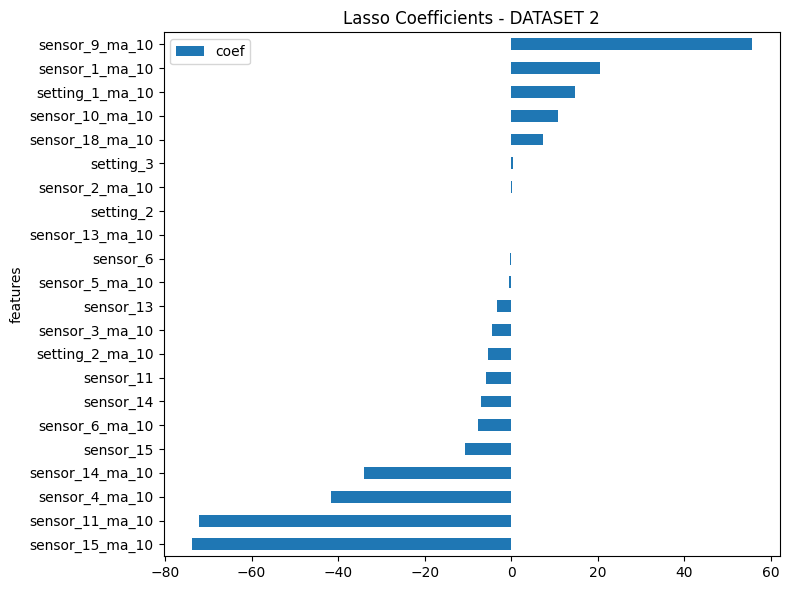


--------- DATASET 3 ---------
Dropped Features: ['sensor_20']


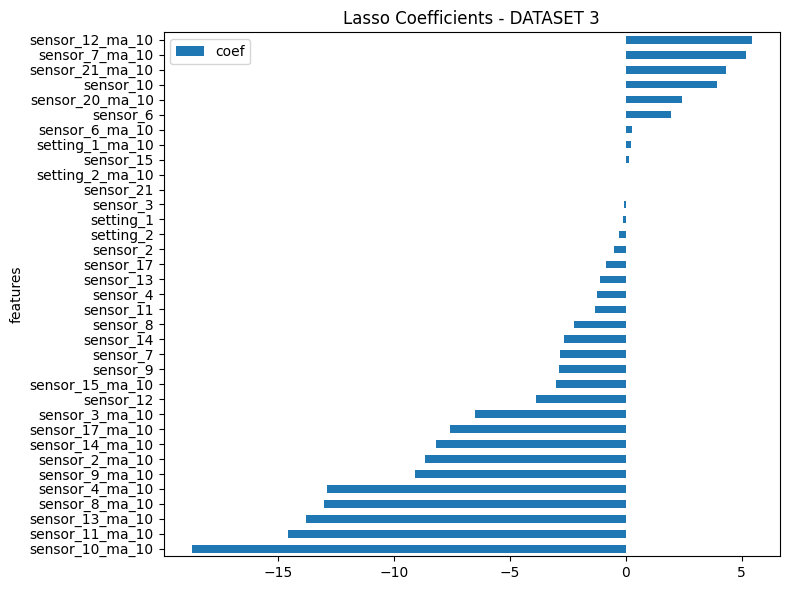


--------- DATASET 4 ---------
Dropped Features: ['sensor_1', 'sensor_2', 'sensor_3', 'sensor_5', 'sensor_6', 'sensor_7', 'sensor_8', 'sensor_9', 'sensor_11', 'sensor_12', 'sensor_16', 'sensor_19', 'sensor_20', 'sensor_21', 'sensor_3_ma_10', 'sensor_6_ma_10', 'sensor_7_ma_10', 'sensor_8_ma_10', 'sensor_20_ma_10', 'sensor_21_ma_10']


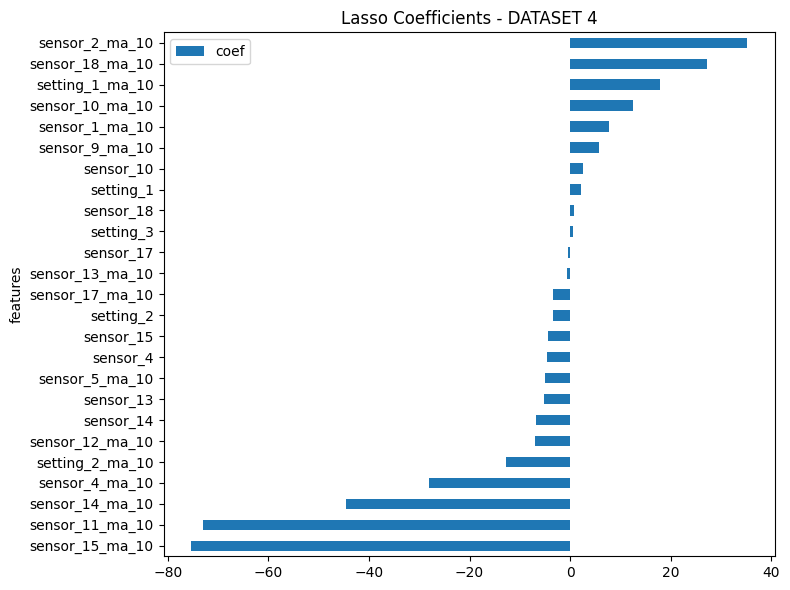

In [ ]:
selected_features = {}
for i in range(len(scaled_train_dfs)):
  train_df = scaled_train_dfs[i]
  selected = lasso_feature_selection(train_df, i)
  selected_features[i] = selected

- Random Forest Feature Importances

In [ ]:
def random_forest_feature_selection(df, idx, thresh=0.1):
    print(f'\n--------- DATASET {idx+1} ---------')
    # Set data
    X_features = [col for col in df.columns if 'setting_' in col or 'sensor_' in col]
    temp_df = df.dropna()
    X = temp_df[X_features]
    y = temp_df['RUL'].values
    X_train, X_val, y_train, y_val = train_test_split(X, y, test_size=0.3, random_state=42)

    # Initialize Random Forest Regressor
    rf = RandomForestRegressor(n_estimators=100, max_depth=5, n_jobs=-1, random_state=42)

    # Fit model
    rf.fit(X_train, y_train)

    # MDI
    rf_importances = pd.DataFrame({'importance': rf.feature_importances_, 'features': X_train.columns})
    rf_importances = rf_importances.sort_values(by='importance', ascending=False)

    # drop features below some percentile threshold
    cutoff = int(thresh * len(rf_importances))
    threshold_importance = rf_importances.importance.nsmallest(cutoff).iloc[-1]
    selected_features = rf_importances[rf_importances.importance > threshold_importance].features.values
    dropped_features = rf_importances[rf_importances.importance <= threshold_importance].features.values
    print(f'Dropped Features: {list(dropped_features)}')

    # Plot feature importances
    f, ax = plt.subplots(figsize=(8, 6))
    rf_importances.plot.barh(x='features', y='importance', ax=ax)
    plt.gca().invert_yaxis()
    plt.title(f'Random Forest Feature Importances (MDI) - DATASET {idx+1}')
    plt.tight_layout()
    plt.show()

    return selected_features


--------- DATASET 1 ---------
Dropped Features: ['setting_1', 'sensor_12', 'sensor_8']


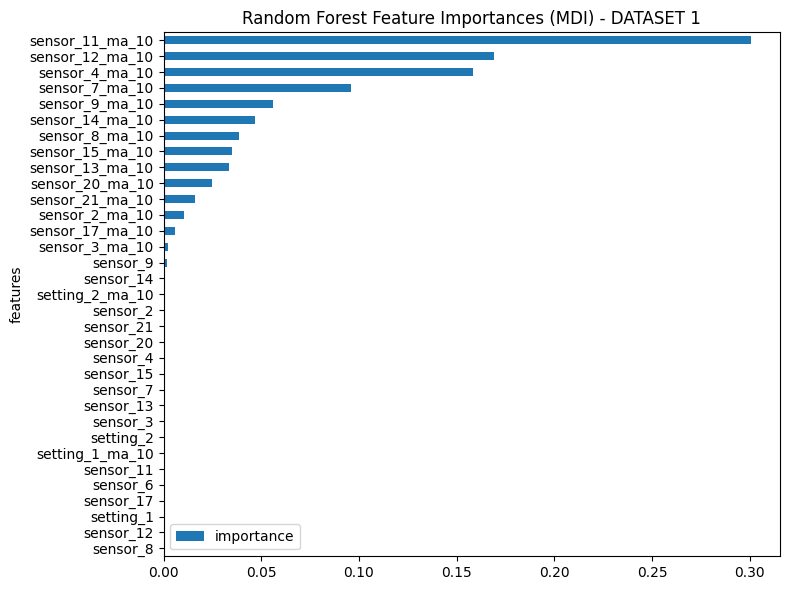


--------- DATASET 2 ---------
Dropped Features: ['sensor_21_ma_10', 'sensor_17_ma_10', 'setting_3', 'sensor_19']


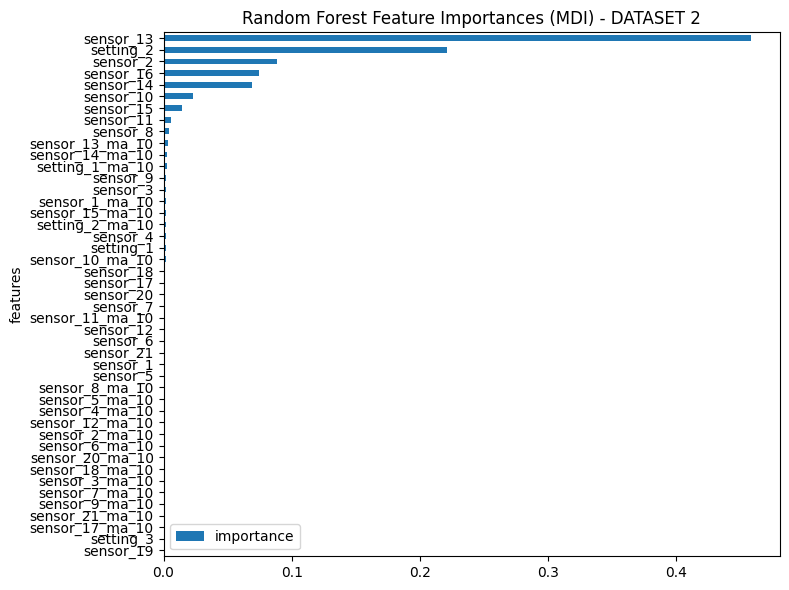


--------- DATASET 3 ---------
Dropped Features: ['sensor_10', 'sensor_11', 'setting_2']


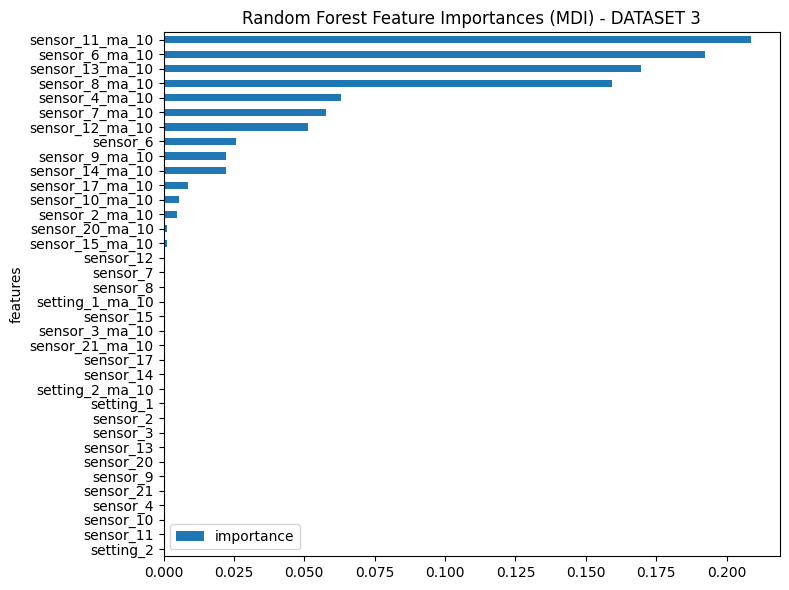


--------- DATASET 4 ---------
Dropped Features: ['sensor_12_ma_10', 'setting_3', 'sensor_19', 'sensor_20_ma_10']


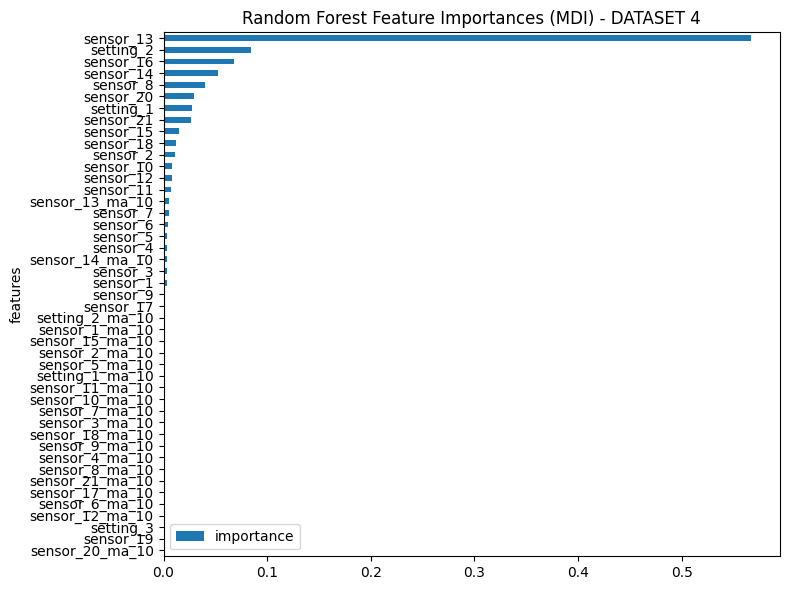

In [ ]:
rf_selected_features = {}
for i in range(len(scaled_train_dfs)):
  train_df = scaled_train_dfs[i]
  selected = random_forest_feature_selection(train_df, i)
  rf_selected_features[i] = selected

- Comparing LASSO Features and RF Features

In [ ]:
final_features = {}
for i in range(0,4):
  arr = list(set(selected_features[i]) & set(rf_selected_features[i]))
  final_features[i] = arr
final_features

{0: ['sensor_11',
  'setting_1_ma_10',
  'sensor_17_ma_10',
  'sensor_3_ma_10',
  'sensor_13_ma_10',
  'sensor_7',
  'sensor_15_ma_10',
  'sensor_20_ma_10',
  'sensor_9_ma_10',
  'sensor_2',
  'setting_2',
  'sensor_9',
  'sensor_8_ma_10',
  'sensor_2_ma_10',
  'sensor_11_ma_10',
  'sensor_7_ma_10',
  'sensor_14',
  'sensor_21_ma_10',
  'sensor_21',
  'sensor_14_ma_10',
  'sensor_20',
  'sensor_4_ma_10',
  'sensor_17',
  'sensor_15',
  'sensor_12_ma_10',
  'sensor_4',
  'sensor_13'],
 1: ['sensor_11',
  'setting_1_ma_10',
  'sensor_3_ma_10',
  'sensor_13_ma_10',
  'sensor_15_ma_10',
  'setting_2_ma_10',
  'sensor_9_ma_10',
  'setting_2',
  'sensor_2_ma_10',
  'sensor_11_ma_10',
  'sensor_14',
  'sensor_5_ma_10',
  'sensor_6',
  'sensor_14_ma_10',
  'sensor_4_ma_10',
  'sensor_1_ma_10',
  'sensor_18_ma_10',
  'sensor_15',
  'sensor_10_ma_10',
  'sensor_6_ma_10',
  'sensor_13'],
 2: ['setting_1_ma_10',
  'sensor_17_ma_10',
  'sensor_3_ma_10',
  'sensor_13_ma_10',
  'sensor_7',
  'sensor_

In [ ]:
final_features = {0: ['sensor_11',
  'setting_1_ma_10',
  'sensor_17_ma_10',
  'sensor_3_ma_10',
  'sensor_13_ma_10',
  'sensor_7',
  'sensor_15_ma_10',
  'sensor_20_ma_10',
  'sensor_9_ma_10',
  'sensor_2',
  'setting_2',
  'sensor_9',
  'sensor_8_ma_10',
  'sensor_2_ma_10',
  'sensor_11_ma_10',
  'sensor_7_ma_10',
  'sensor_14',
  'sensor_21_ma_10',
  'sensor_21',
  'sensor_14_ma_10',
  'sensor_20',
  'sensor_4_ma_10',
  'sensor_17',
  'sensor_15',
  'sensor_12_ma_10',
  'sensor_4',
  'sensor_13'],
 1: ['sensor_11',
  'setting_1_ma_10',
  'sensor_3_ma_10',
  'sensor_13_ma_10',
  'sensor_15_ma_10',
  'setting_2_ma_10',
  'sensor_9_ma_10',
  'setting_2',
  'sensor_2_ma_10',
  'sensor_11_ma_10',
  'sensor_14',
  'sensor_5_ma_10',
  'sensor_6',
  'sensor_14_ma_10',
  'sensor_4_ma_10',
  'sensor_1_ma_10',
  'sensor_18_ma_10',
  'sensor_15',
  'sensor_10_ma_10',
  'sensor_6_ma_10',
  'sensor_13'],
 2: ['setting_1_ma_10',
  'sensor_17_ma_10',
  'sensor_3_ma_10',
  'sensor_13_ma_10',
  'sensor_7',
  'sensor_15_ma_10',
  'setting_2_ma_10',
  'sensor_20_ma_10',
  'sensor_8',
  'sensor_9_ma_10',
  'sensor_2',
  'sensor_9',
  'sensor_8_ma_10',
  'sensor_2_ma_10',
  'sensor_11_ma_10',
  'sensor_7_ma_10',
  'sensor_14',
  'sensor_21_ma_10',
  'sensor_21',
  'setting_1',
  'sensor_6',
  'sensor_14_ma_10',
  'sensor_4_ma_10',
  'sensor_17',
  'sensor_15',
  'sensor_10_ma_10',
  'sensor_12_ma_10',
  'sensor_6_ma_10',
  'sensor_12',
  'sensor_3',
  'sensor_4',
  'sensor_13'],
 3: ['setting_1_ma_10',
  'sensor_17_ma_10',
  'sensor_13_ma_10',
  'sensor_15_ma_10',
  'setting_2_ma_10',
  'sensor_9_ma_10',
  'sensor_18',
  'setting_2',
  'sensor_2_ma_10',
  'sensor_11_ma_10',
  'sensor_10',
  'sensor_14',
  'setting_1',
  'sensor_5_ma_10',
  'sensor_14_ma_10',
  'sensor_4_ma_10',
  'sensor_1_ma_10',
  'sensor_17',
  'sensor_18_ma_10',
  'sensor_15',
  'sensor_10_ma_10',
  'sensor_4',
  'sensor_13']}

In [ ]:
for i in range(0,4):
  print(f'\n--------- DATASET {i+1} ---------')
  print(f'No. of Lasso Features: {len(selected_features[i])}, No. of RF Features: {len(rf_selected_features[i])}, No. of Final Selected Features: {len(final_features[i])}\n')


--------- DATASET 1 ---------
No. of Lasso Features: 29, No. of RF Features: 30, No. of Final Selected Features: 27


--------- DATASET 2 ---------
No. of Lasso Features: 22, No. of RF Features: 41, No. of Final Selected Features: 21


--------- DATASET 3 ---------
No. of Lasso Features: 35, No. of RF Features: 33, No. of Final Selected Features: 32


--------- DATASET 4 ---------
No. of Lasso Features: 25, No. of RF Features: 41, No. of Final Selected Features: 23



## Regression

In [ ]:
from sklearn.model_selection import cross_val_score, learning_curve, GridSearchCV
from sklearn.metrics import mean_absolute_error, mean_squared_error, r2_score
from sklearn.linear_model import LinearRegression, ElasticNet
from xgboost import XGBRegressor
from sklearn.svm import SVR

In [ ]:
# Function to calculate metrics
def calculate_reg_metrics(y_true, y_pred, dataset_name="Validation"):
    mae = mean_absolute_error(y_true, y_pred)
    mse = mean_squared_error(y_true, y_pred)
    rmse = np.sqrt(mse)
    r2 = r2_score(y_true, y_pred)
    print(f"{dataset_name} - Mean Absolute Error (MAE): {mae:.5f}")
    print(f"{dataset_name} - Mean Squared Error (MSE): {mse:.5f}")
    print(f"{dataset_name} - Root Mean Squared Error (RMSE): {rmse:.5f}")
    print(f"{dataset_name} - R-squared (R²): {r2:.5f}\n")

    return [mae, mse, rmse, r2]

In [ ]:
def train_reg_model(train_df, test_df, model, cols, name, idx):
  # Set data
    X = train_df[cols].values
    y = train_df['RUL'].values

    X_train, X_val, y_train, y_val = train_test_split(X, y, test_size=0.3, random_state=42)

    # Cross-validation
    cv_scores = cross_val_score(model, X, y, cv=5, scoring='neg_mean_squared_error')
    print(f"Cross-Validated MSE: {-cv_scores.mean()}")

    # Train model and predict
    model.fit(X_train, y_train)
    pred_train = model.predict(X_train)
    pred_val = model.predict(X_val)

    # Calculate and print metrics for training and validation datasets
    train_metrics = calculate_reg_metrics(y_train, pred_train, "Training")
    val_metrics = calculate_reg_metrics(y_val, pred_val, "Validation")

    # Visualise validation predictions and residuals
    fig, axs = plt.subplots(1, 2, figsize=(20, 5))
    axs = axs.flatten()
    ax = axs[0]
    ax.scatter(y_train, pred_train, marker='o', label='Train')
    ax.scatter(y_val, pred_val, marker='s', label='Validation', alpha=0.3)
    ax.legend()
    ax.set_title(f'{name}: Actual vs Predicted Values - DATASET {idx}')
    ax.set_xlabel('Actual')
    ax.set_ylabel('Predicted')
    ax.plot([y_val.min(), y_val.max()], [y_val.min(), y_val.max()], 'r--') # identity line

    # Visualise residuals
    train_residuals = y_train - pred_train
    val_residuals = y_val - pred_val
    ax = axs[1]
    ax.scatter(y_train, train_residuals, marker='o', label='Train')
    ax.scatter(y_val, val_residuals, marker='s', label='Validation', alpha=0.3)
    ax.legend()
    ax.set_title(f'{name}: Residual Plot for DATASET {idx}')
    ax.set_xlabel('Actual')
    ax.set_ylabel('Residuals')
    ax.axhline(y=0, color='r', linestyle='--')
    plt.show()

    return train_metrics, val_metrics

In [ ]:
def update_model_scores_reg(model_scores, model_name, train_valid, dataset_idx, metric_values, metrics):
  model_scores['model'].append(f'{model_name}')
  model_scores['dataset'].append(dataset_idx)
  model_scores['train_valid'].append(train_valid)
  for i in range(len(metrics)):
    m = metrics[i]
    model_scores[m].append(metric_values[i])

def reg_train_wrapper(scaled_train_dfs, scaled_test_dfs, model, final_features, model_name, model_scores):
  for i, (train_df, test_df) in enumerate(zip(scaled_train_dfs, scaled_test_dfs)):
    print(f'--------- DATASET {i+1} ---------')
    train_metrics, val_metrics = train_reg_model(train_df, test_df, model, final_features[i], model_name, i+1)
    metrics = ['MAE', 'MSE', 'RMSE', 'R2']
    update_model_scores_reg(model_scores, model_name, 'train', i+1, train_metrics, metrics)
    update_model_scores_reg(model_scores, model_name, 'valid', i+1, val_metrics, metrics)

### Linear Regression

In [ ]:
model_scores = {'model': [], 'dataset': [], 'train_valid': [], 'MAE': [], 'MSE': [], 'RMSE':[], 'R2':[]}

--------- DATASET 1 ---------
Cross-Validated MSE: 2452.0542242153815
Training - Mean Absolute Error (MAE): 37.56403
Training - Mean Squared Error (MSE): 2410.27472
Training - Root Mean Squared Error (RMSE): 49.09455
Training - R-squared (R²): 0.42595

Validation - Mean Absolute Error (MAE): 37.19681
Validation - Mean Squared Error (MSE): 2399.32873
Validation - Root Mean Squared Error (RMSE): 48.98294
Validation - R-squared (R²): 0.41160



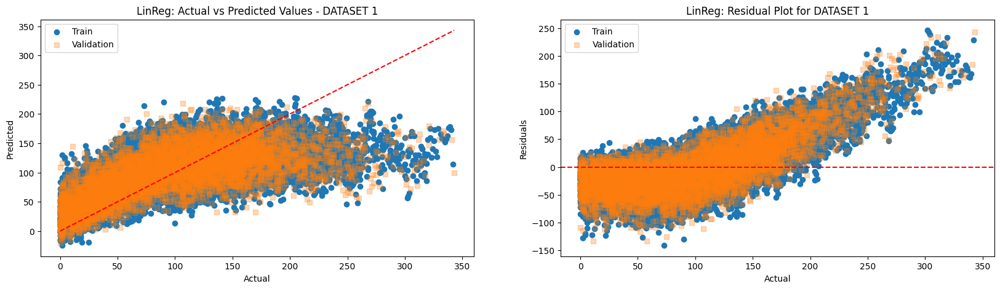

--------- DATASET 2 ---------
Cross-Validated MSE: 3960.357557919285
Training - Mean Absolute Error (MAE): 51.11421
Training - Mean Squared Error (MSE): 3966.12865
Training - Root Mean Squared Error (RMSE): 62.97721
Training - R-squared (R²): 0.06120

Validation - Mean Absolute Error (MAE): 50.78351
Validation - Mean Squared Error (MSE): 3909.18245
Validation - Root Mean Squared Error (RMSE): 62.52346
Validation - R-squared (R²): 0.05793



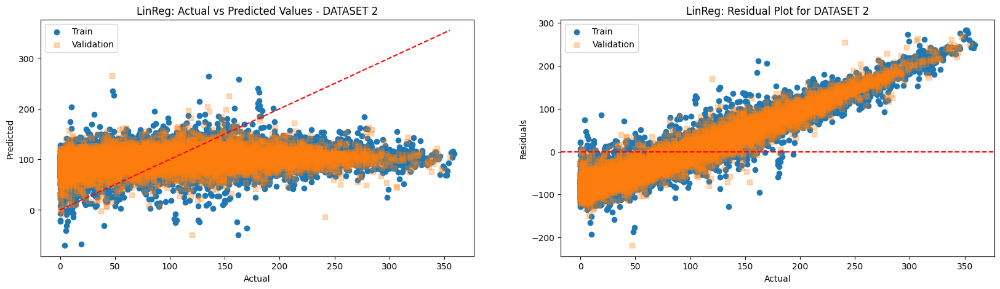

--------- DATASET 3 ---------
Cross-Validated MSE: 6001.607865469918
Training - Mean Absolute Error (MAE): 56.30381
Training - Mean Squared Error (MSE): 5821.41589
Training - Root Mean Squared Error (RMSE): 76.29820
Training - R-squared (R²): 0.35890

Validation - Mean Absolute Error (MAE): 56.90902
Validation - Mean Squared Error (MSE): 5993.10386
Validation - Root Mean Squared Error (RMSE): 77.41514
Validation - R-squared (R²): 0.34788



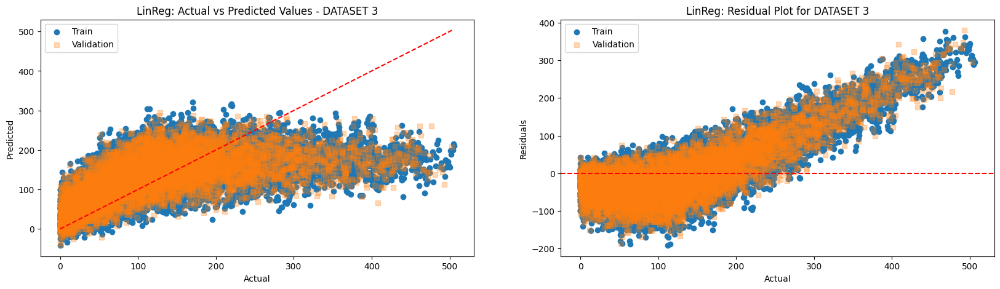

--------- DATASET 4 ---------
Cross-Validated MSE: 7081.554078126833
Training - Mean Absolute Error (MAE): 67.41273
Training - Mean Squared Error (MSE): 7037.80312
Training - Root Mean Squared Error (RMSE): 83.89162
Training - R-squared (R²): 0.04238

Validation - Mean Absolute Error (MAE): 67.41359
Validation - Mean Squared Error (MSE): 7112.22081
Validation - Root Mean Squared Error (RMSE): 84.33398
Validation - R-squared (R²): 0.04037



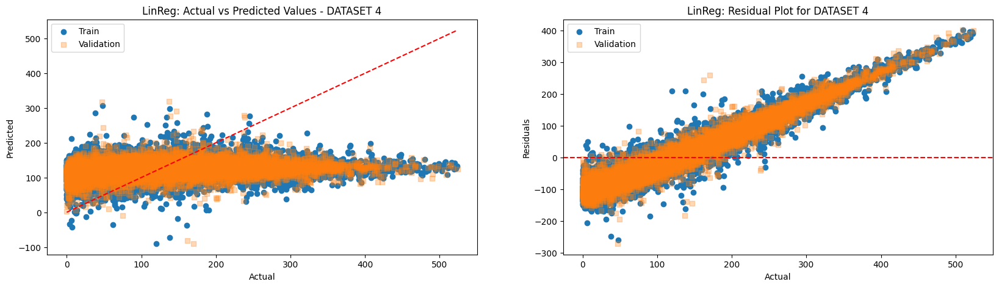

In [ ]:
lr_model = LinearRegression()
reg_train_wrapper(scaled_train_dfs, scaled_test_dfs, lr_model, final_features, 'LinReg', model_scores)

### Elastic Net

--------- DATASET 1 ---------
Cross-Validated MSE: 2464.4750886114984
Training - Mean Absolute Error (MAE): 37.93957
Training - Mean Squared Error (MSE): 2424.80697
Training - Root Mean Squared Error (RMSE): 49.24233
Training - R-squared (R²): 0.42249

Validation - Mean Absolute Error (MAE): 37.51538
Validation - Mean Squared Error (MSE): 2403.88587
Validation - Root Mean Squared Error (RMSE): 49.02944
Validation - R-squared (R²): 0.41049



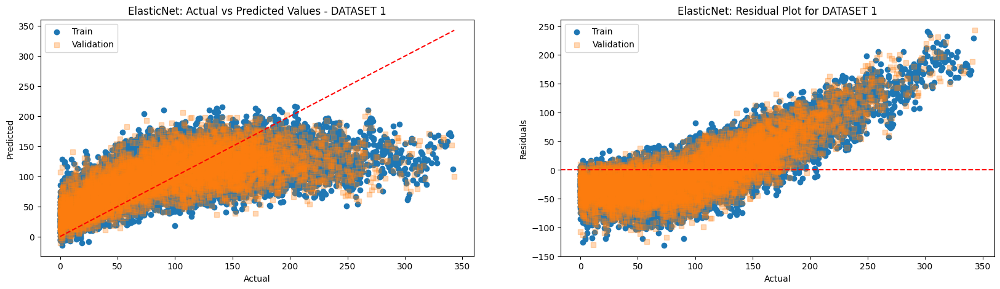

--------- DATASET 2 ---------
Cross-Validated MSE: 4193.033387056696
Training - Mean Absolute Error (MAE): 53.17623
Training - Mean Squared Error (MSE): 4208.23185
Training - Root Mean Squared Error (RMSE): 64.87089
Training - R-squared (R²): 0.00390

Validation - Mean Absolute Error (MAE): 52.77733
Validation - Mean Squared Error (MSE): 4135.42105
Validation - Root Mean Squared Error (RMSE): 64.30724
Validation - R-squared (R²): 0.00341



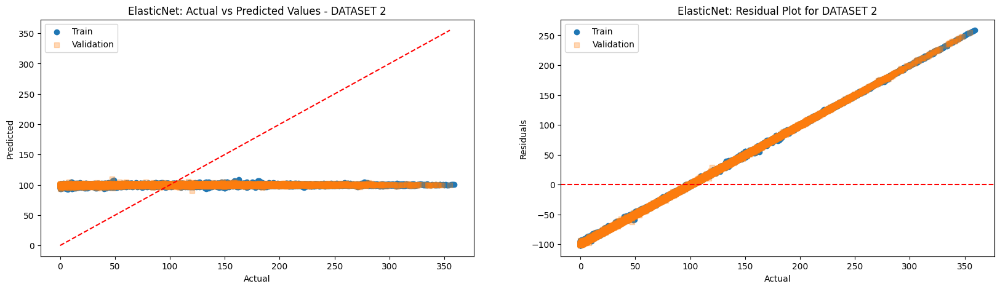

--------- DATASET 3 ---------
Cross-Validated MSE: 6052.4461674890135
Training - Mean Absolute Error (MAE): 56.78759
Training - Mean Squared Error (MSE): 5875.51399
Training - Root Mean Squared Error (RMSE): 76.65190
Training - R-squared (R²): 0.35294

Validation - Mean Absolute Error (MAE): 57.46169
Validation - Mean Squared Error (MSE): 6046.15039
Validation - Root Mean Squared Error (RMSE): 77.75700
Validation - R-squared (R²): 0.34210



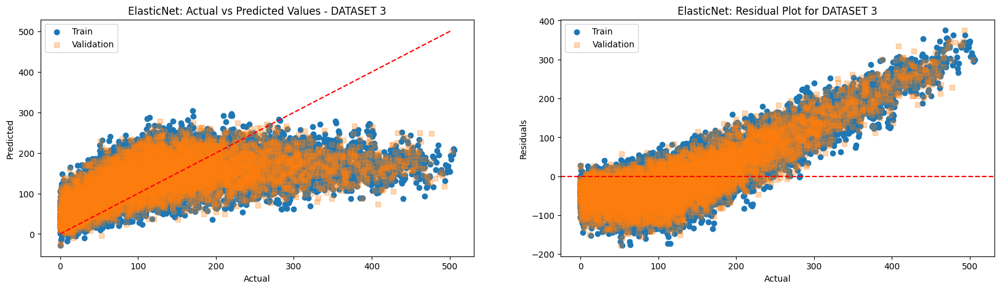

--------- DATASET 4 ---------
Cross-Validated MSE: 7357.633683371966
Training - Mean Absolute Error (MAE): 69.11522
Training - Mean Squared Error (MSE): 7325.08868
Training - Root Mean Squared Error (RMSE): 85.58673
Training - R-squared (R²): 0.00329

Validation - Mean Absolute Error (MAE): 69.06177
Validation - Mean Squared Error (MSE): 7388.25076
Validation - Root Mean Squared Error (RMSE): 85.95493
Validation - R-squared (R²): 0.00313



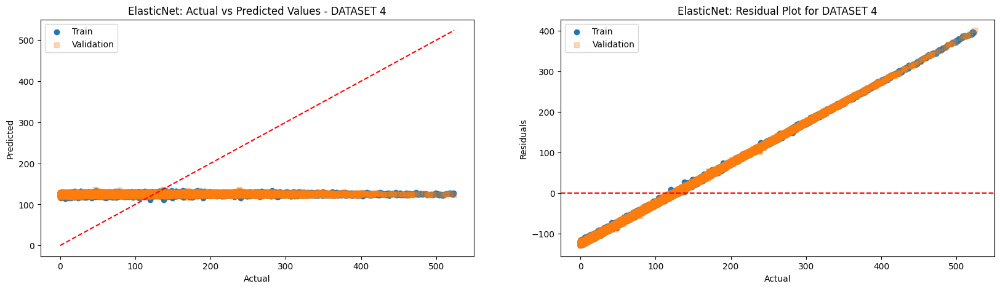

In [ ]:
en_model = ElasticNet(alpha=0.5, l1_ratio=0.5, random_state=42)
reg_train_wrapper(scaled_train_dfs, scaled_test_dfs, en_model, final_features, 'ElasticNet', model_scores)

### Random Forest

--------- DATASET 1 ---------
Cross-Validated MSE: 2678.8387823615403
Training - Mean Absolute Error (MAE): 38.72071
Training - Mean Squared Error (MSE): 2482.89561
Training - Root Mean Squared Error (RMSE): 49.82866
Training - R-squared (R²): 0.40865

Validation - Mean Absolute Error (MAE): 38.78167
Validation - Mean Squared Error (MSE): 2503.41682
Validation - Root Mean Squared Error (RMSE): 50.03416
Validation - R-squared (R²): 0.38608



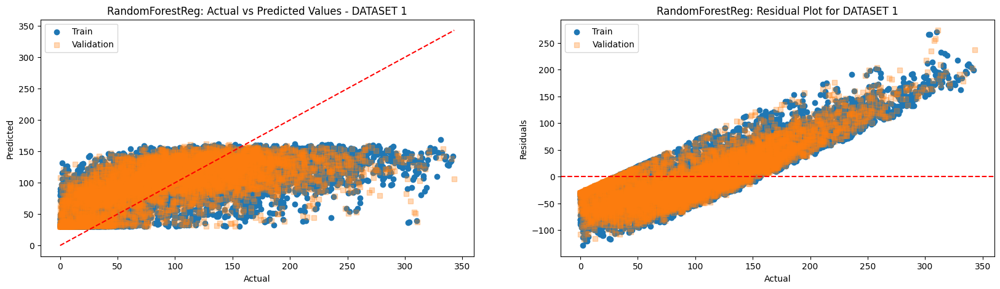

--------- DATASET 2 ---------
Cross-Validated MSE: 3848.630893524403
Training - Mean Absolute Error (MAE): 49.89839
Training - Mean Squared Error (MSE): 3801.87161
Training - Root Mean Squared Error (RMSE): 61.65932
Training - R-squared (R²): 0.10008

Validation - Mean Absolute Error (MAE): 49.80528
Validation - Mean Squared Error (MSE): 3789.54649
Validation - Root Mean Squared Error (RMSE): 61.55929
Validation - R-squared (R²): 0.08676



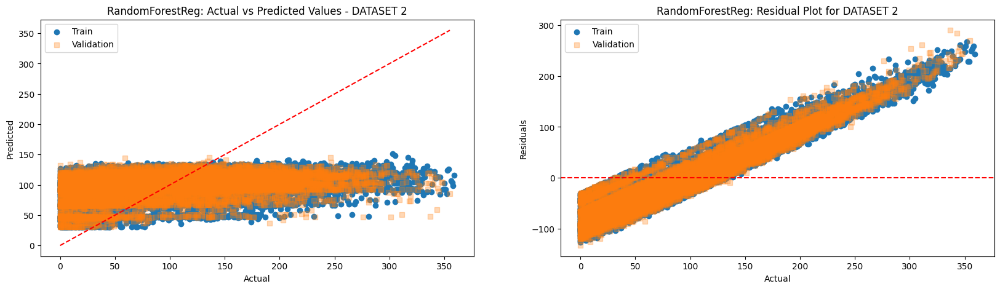

--------- DATASET 3 ---------
Cross-Validated MSE: 5448.13685140786
Training - Mean Absolute Error (MAE): 51.93214
Training - Mean Squared Error (MSE): 4929.78074
Training - Root Mean Squared Error (RMSE): 70.21240
Training - R-squared (R²): 0.45709

Validation - Mean Absolute Error (MAE): 53.90052
Validation - Mean Squared Error (MSE): 5261.02390
Validation - Root Mean Squared Error (RMSE): 72.53292
Validation - R-squared (R²): 0.42754



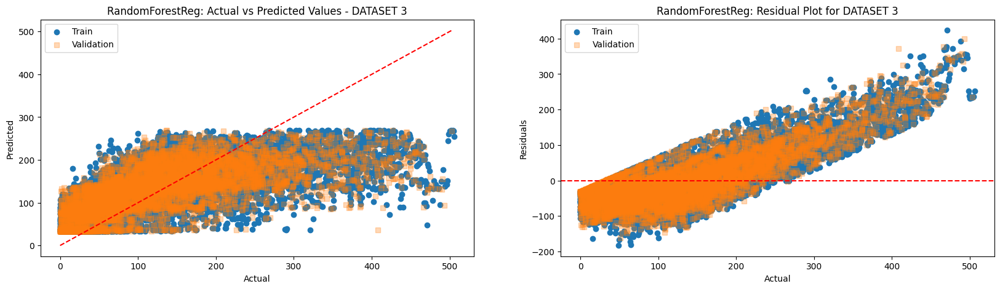

--------- DATASET 4 ---------
Cross-Validated MSE: 6806.82629351962
Training - Mean Absolute Error (MAE): 65.64475
Training - Mean Squared Error (MSE): 6693.10466
Training - Root Mean Squared Error (RMSE): 81.81140
Training - R-squared (R²): 0.08929

Validation - Mean Absolute Error (MAE): 66.02455
Validation - Mean Squared Error (MSE): 6798.12639
Validation - Root Mean Squared Error (RMSE): 82.45075
Validation - R-squared (R²): 0.08275



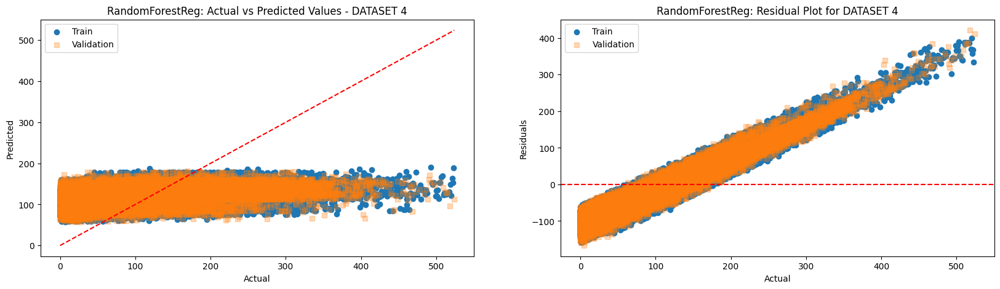

In [ ]:
rf_reg_model = RandomForestRegressor(n_estimators=100, max_depth=5, n_jobs=-1, random_state=42)
reg_train_wrapper(scaled_train_dfs, scaled_test_dfs, rf_reg_model, final_features, 'RandomForestReg', model_scores)

### XGBoost

--------- DATASET 1 ---------
Cross-Validated MSE: 2528.09994752062
Training - Mean Absolute Error (MAE): 23.13089
Training - Mean Squared Error (MSE): 925.29198
Training - Root Mean Squared Error (RMSE): 30.41861
Training - R-squared (R²): 0.77963

Validation - Mean Absolute Error (MAE): 36.80094
Validation - Mean Squared Error (MSE): 2350.07800
Validation - Root Mean Squared Error (RMSE): 48.47760
Validation - R-squared (R²): 0.42368



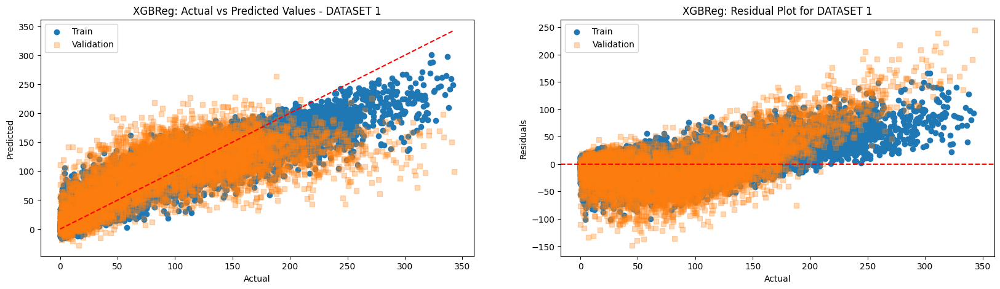

--------- DATASET 2 ---------
Cross-Validated MSE: 3683.186136706666
Training - Mean Absolute Error (MAE): 41.89743
Training - Mean Squared Error (MSE): 2750.52452
Training - Root Mean Squared Error (RMSE): 52.44544
Training - R-squared (R²): 0.34894

Validation - Mean Absolute Error (MAE): 48.25884
Validation - Mean Squared Error (MSE): 3622.36284
Validation - Root Mean Squared Error (RMSE): 60.18607
Validation - R-squared (R²): 0.12705



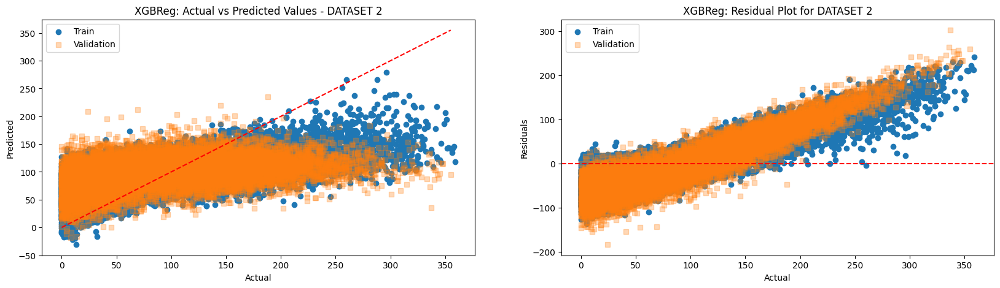

--------- DATASET 3 ---------
Cross-Validated MSE: 4802.088303175252
Training - Mean Absolute Error (MAE): 31.44796
Training - Mean Squared Error (MSE): 1863.70251
Training - Root Mean Squared Error (RMSE): 43.17062
Training - R-squared (R²): 0.79475

Validation - Mean Absolute Error (MAE): 48.09115
Validation - Mean Squared Error (MSE): 4419.88718
Validation - Root Mean Squared Error (RMSE): 66.48223
Validation - R-squared (R²): 0.51906



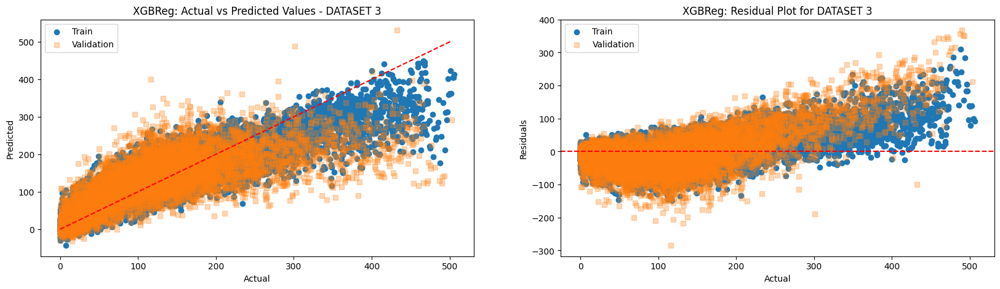

--------- DATASET 4 ---------
Cross-Validated MSE: 6405.860775555882
Training - Mean Absolute Error (MAE): 55.81006
Training - Mean Squared Error (MSE): 4948.74530
Training - Root Mean Squared Error (RMSE): 70.34732
Training - R-squared (R²): 0.32664

Validation - Mean Absolute Error (MAE): 63.28603
Validation - Mean Squared Error (MSE): 6349.11487
Validation - Root Mean Squared Error (RMSE): 79.68133
Validation - R-squared (R²): 0.14333



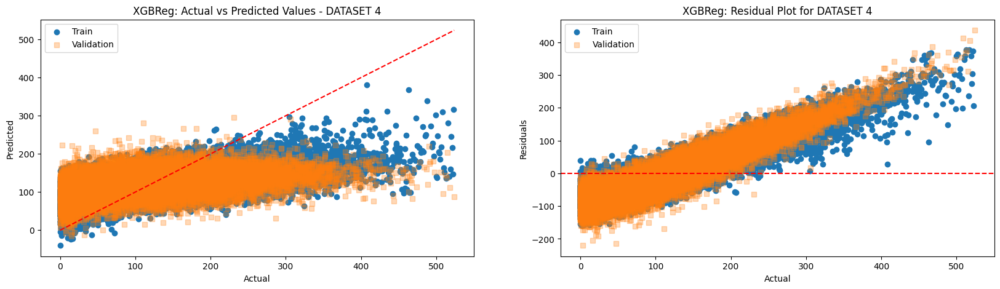

In [ ]:
xgb_reg_model = XGBRegressor(n_estimators=100, max_depth=5, n_jobs=-1, random_state=42)
reg_train_wrapper(scaled_train_dfs, scaled_test_dfs, xgb_reg_model, final_features, 'XGBReg', model_scores)

### Support Vector Regression (SVR)

--------- DATASET 1 ---------
Cross-Validated MSE: 2443.684458205603
Training - Mean Absolute Error (MAE): 35.53564
Training - Mean Squared Error (MSE): 2392.04411
Training - Root Mean Squared Error (RMSE): 48.90853
Training - R-squared (R²): 0.43029

Validation - Mean Absolute Error (MAE): 35.41885
Validation - Mean Squared Error (MSE): 2375.70796
Validation - Root Mean Squared Error (RMSE): 48.74123
Validation - R-squared (R²): 0.41740



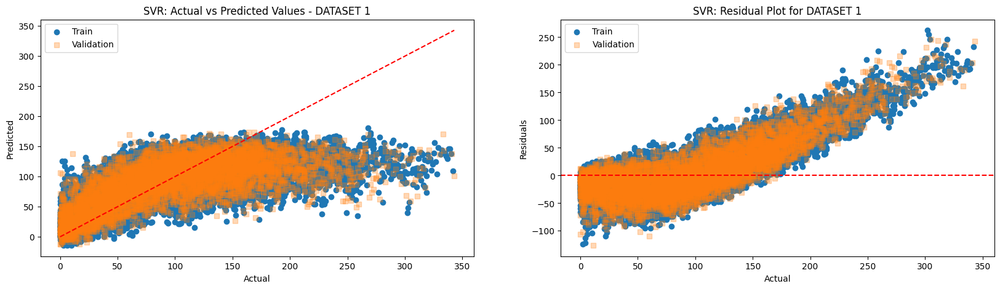

--------- DATASET 2 ---------
Cross-Validated MSE: 4178.786759160106
Training - Mean Absolute Error (MAE): 52.54025
Training - Mean Squared Error (MSE): 4184.42790
Training - Root Mean Squared Error (RMSE): 64.68715
Training - R-squared (R²): 0.00953

Validation - Mean Absolute Error (MAE): 52.16856
Validation - Mean Squared Error (MSE): 4110.21553
Validation - Root Mean Squared Error (RMSE): 64.11096
Validation - R-squared (R²): 0.00948



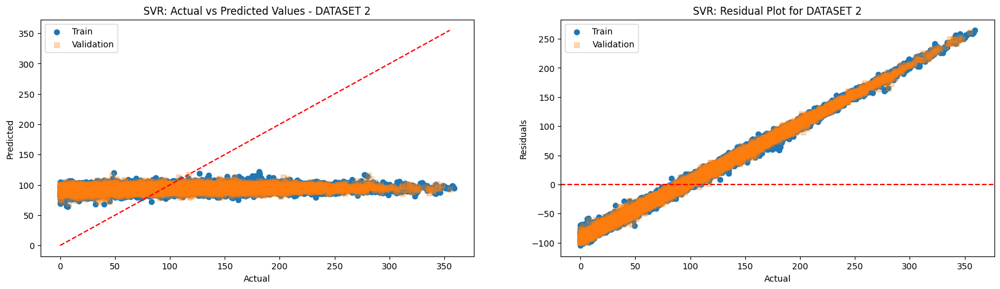

--------- DATASET 3 ---------
Cross-Validated MSE: 6153.845025719567
Training - Mean Absolute Error (MAE): 51.72427
Training - Mean Squared Error (MSE): 5979.64591
Training - Root Mean Squared Error (RMSE): 77.32817
Training - R-squared (R²): 0.34147

Validation - Mean Absolute Error (MAE): 52.58503
Validation - Mean Squared Error (MSE): 6159.71710
Validation - Root Mean Squared Error (RMSE): 78.48387
Validation - R-squared (R²): 0.32975



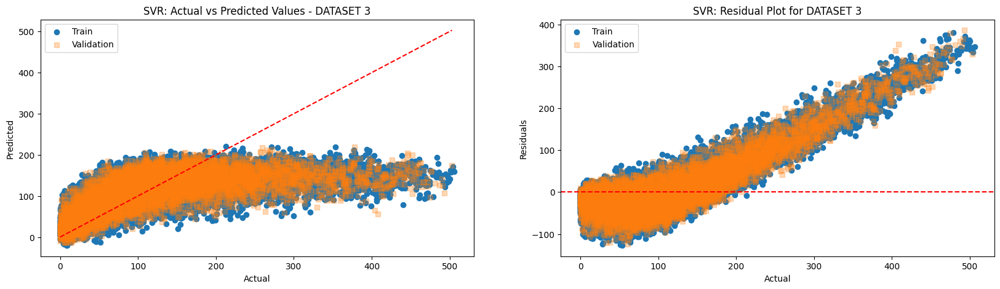

--------- DATASET 4 ---------
Cross-Validated MSE: 7421.267894007389
Training - Mean Absolute Error (MAE): 67.99625
Training - Mean Squared Error (MSE): 7385.10138
Training - Root Mean Squared Error (RMSE): 85.93661
Training - R-squared (R²): -0.00487

Validation - Mean Absolute Error (MAE): 68.25351
Validation - Mean Squared Error (MSE): 7492.58107
Validation - Root Mean Squared Error (RMSE): 86.55970
Validation - R-squared (R²): -0.01095



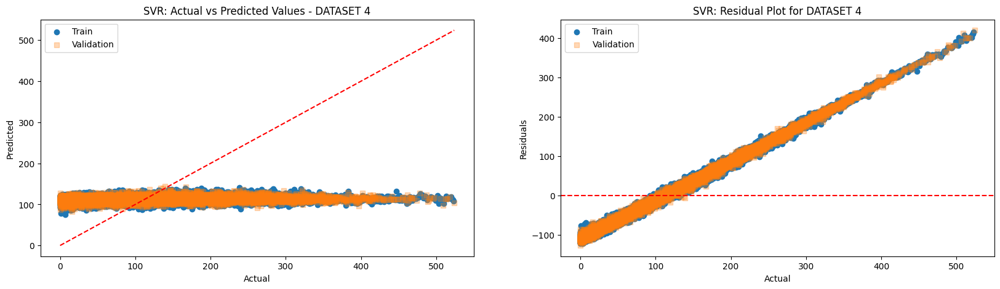

In [ ]:
svr_model = SVR(kernel='rbf', C=1.0, epsilon=0.1) # rbf kernal suitable for non-linear problems
reg_train_wrapper(scaled_train_dfs, scaled_test_dfs, svr_model, final_features, 'SVR', model_scores)

### Comparing Regression Models

Compare validation metrics to choose the best model

In [ ]:
def compare_metrics(scores_df, metrics):
  for i in range(4):
    df_filtered = scores_df[scores_df['dataset'] == i+1]
    f, ax = plt.subplots(2,2, figsize=(24,10))
    for j in range(4):
      df_pivoted = df_filtered.pivot(index='model', columns='train_valid', values=metrics[j])
      a = ax[j%2, j//2]
      axes = df_pivoted.plot(kind='bar', ax=a, rot=45)
      for container in axes.containers:
        axes.bar_label(container, fmt='%.4f')
      a.legend(loc='lower right')
      a.set_xlabel('Model')
      a.set_ylabel(f'{metrics[j]}')
      a.set_title(f'{metrics[j]} for different Models - DATASET {i+1}')
    plt.tight_layout()
    plt.show()

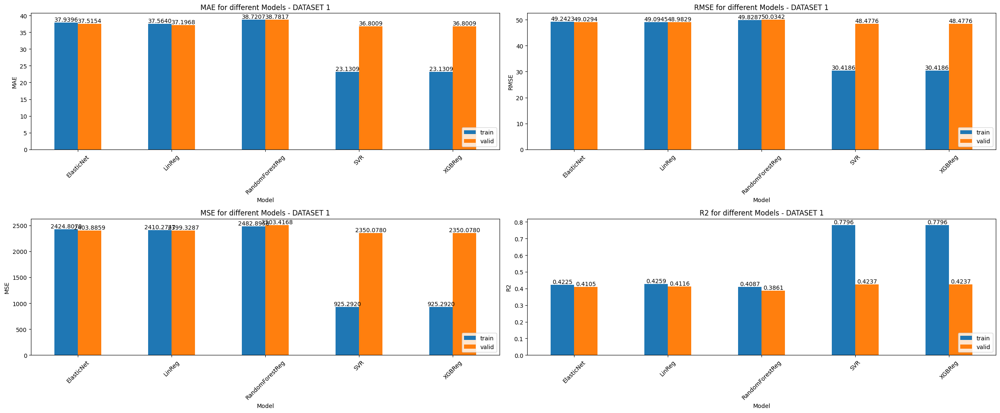

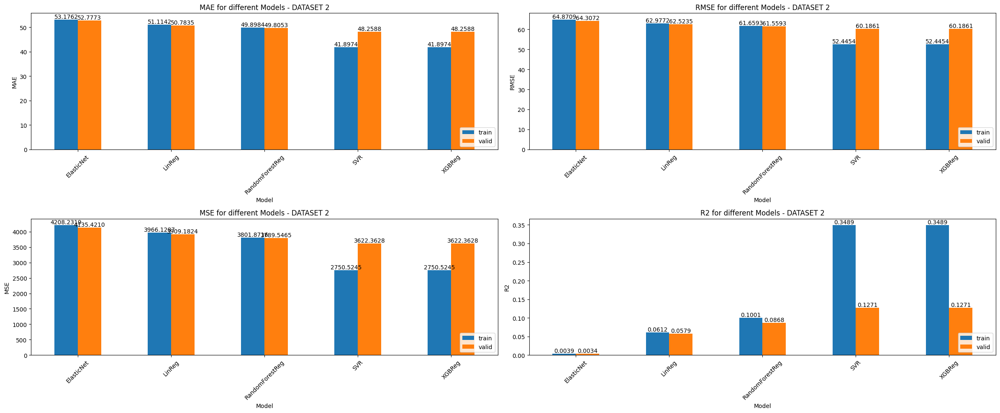

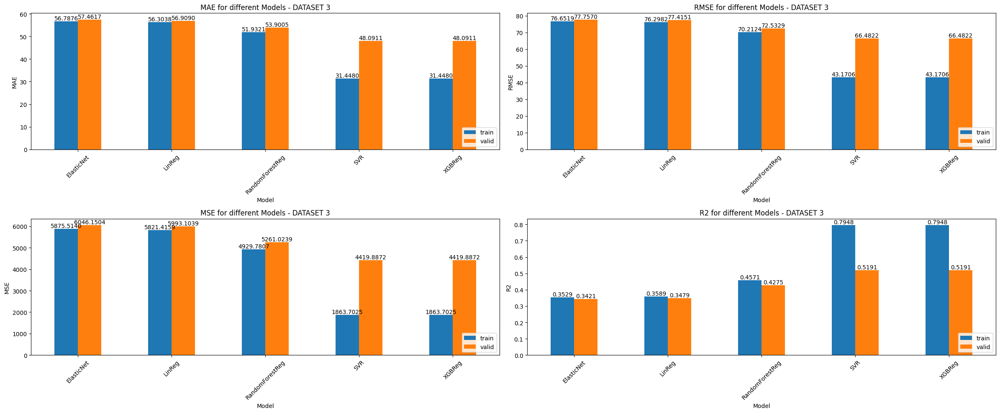

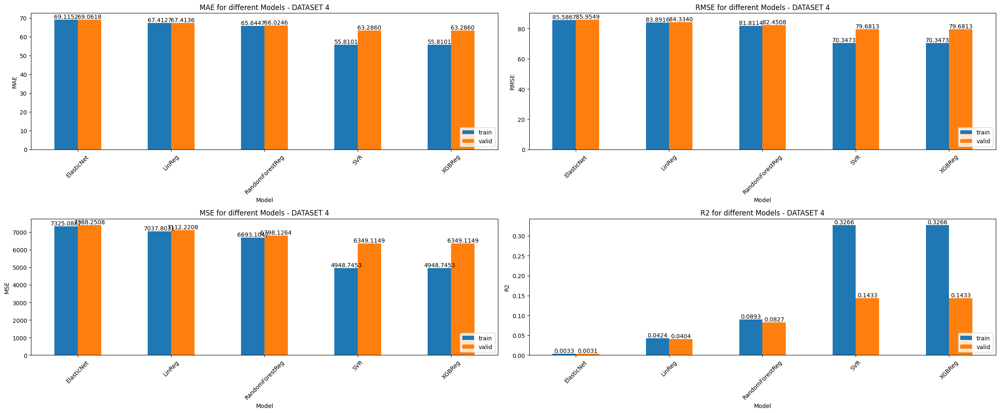

In [ ]:
model_scores_df = pd.DataFrame.from_dict(model_scores)
reg_metrics = ['MAE', 'MSE', 'RMSE', 'R2']
compare_metrics(model_scores_df, reg_metrics)

### Hyperparameter optimisation

- Perform hyperparameter optimisation on best model, XBG

--------- DATASET 1 ---------
Fitting 5 folds for each of 243 candidates, totalling 1215 fits
Best parameters found: {'colsample_bytree': 0.5, 'learning_rate': 0.05, 'max_depth': 4, 'n_estimators': 200, 'subsample': 0.7}
Best CV score: 2269.579871978463
Training - Mean Absolute Error (MAE): 33.29775
Training - Mean Squared Error (MSE): 1937.48084
Training - Root Mean Squared Error (RMSE): 44.01682
Training - R-squared (R²): 0.53855

Validation - Mean Absolute Error (MAE): 32.55365
Validation - Mean Squared Error (MSE): 1879.61675
Validation - Root Mean Squared Error (RMSE): 43.35455
Validation - R-squared (R²): 0.53905

Test - Mean Absolute Error (MAE): 38.94742
Test - Mean Squared Error (MSE): 2642.39993
Test - Root Mean Squared Error (RMSE): 51.40428
Test - R-squared (R²): 0.16071



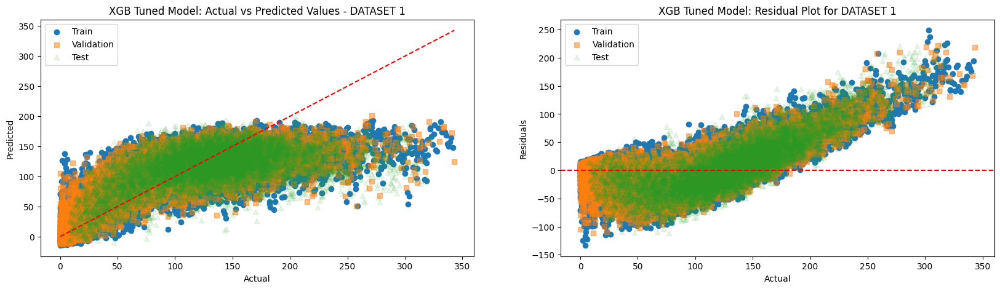

--------- DATASET 2 ---------
Fitting 5 folds for each of 243 candidates, totalling 1215 fits
Best parameters found: {'colsample_bytree': 0.7, 'learning_rate': 0.1, 'max_depth': 5, 'n_estimators': 300, 'subsample': 1.0}
Best CV score: 3621.59753000432
Training - Mean Absolute Error (MAE): 43.48136
Training - Mean Squared Error (MSE): 2945.08388
Training - Root Mean Squared Error (RMSE): 54.26863
Training - R-squared (R²): 0.30289

Validation - Mean Absolute Error (MAE): 43.13937
Validation - Mean Squared Error (MSE): 2898.53449
Validation - Root Mean Squared Error (RMSE): 53.83804
Validation - R-squared (R²): 0.30148

Test - Mean Absolute Error (MAE): 52.06863
Test - Mean Squared Error (MSE): 4381.26635
Test - Root Mean Squared Error (RMSE): 66.19114
Test - R-squared (R²): -0.17726



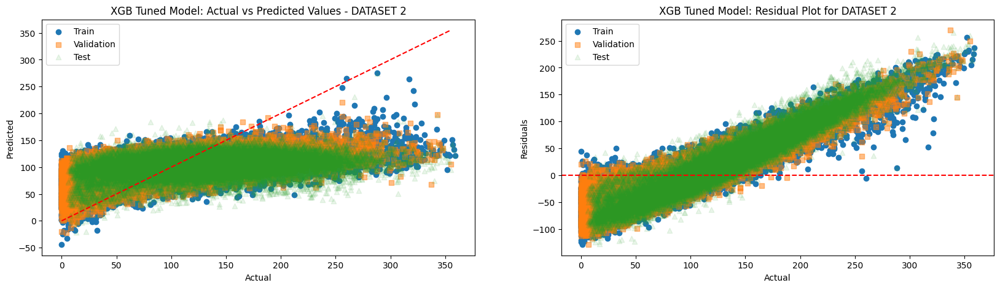

--------- DATASET 3 ---------
Fitting 5 folds for each of 243 candidates, totalling 1215 fits
Best parameters found: {'colsample_bytree': 0.5, 'learning_rate': 0.05, 'max_depth': 5, 'n_estimators': 300, 'subsample': 1.0}
Best CV score: 4448.613502827711
Training - Mean Absolute Error (MAE): 39.24860
Training - Mean Squared Error (MSE): 2974.99146
Training - Root Mean Squared Error (RMSE): 54.54348
Training - R-squared (R²): 0.67237

Validation - Mean Absolute Error (MAE): 39.57605
Validation - Mean Squared Error (MSE): 2990.01724
Validation - Root Mean Squared Error (RMSE): 54.68105
Validation - R-squared (R²): 0.67465

Test - Mean Absolute Error (MAE): 50.26577
Test - Mean Squared Error (MSE): 4629.51172
Test - Root Mean Squared Error (RMSE): 68.04052
Test - R-squared (R²): 0.31256



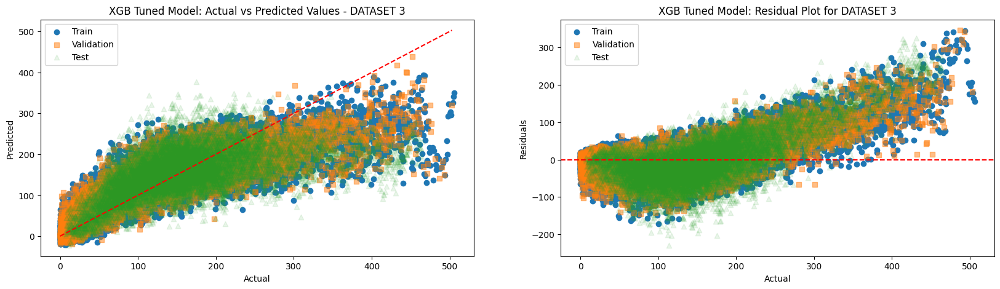

--------- DATASET 4 ---------
Fitting 5 folds for each of 243 candidates, totalling 1215 fits
Best parameters found: {'colsample_bytree': 1.0, 'learning_rate': 0.1, 'max_depth': 5, 'n_estimators': 300, 'subsample': 1.0}
Best CV score: 6311.4377360489825
Training - Mean Absolute Error (MAE): 57.23328
Training - Mean Squared Error (MSE): 5188.36225
Training - Root Mean Squared Error (RMSE): 72.03029
Training - R-squared (R²): 0.29403

Validation - Mean Absolute Error (MAE): 57.11036
Validation - Mean Squared Error (MSE): 5164.62256
Validation - Root Mean Squared Error (RMSE): 71.86531
Validation - R-squared (R²): 0.30315

Test - Mean Absolute Error (MAE): 71.66374
Test - Mean Squared Error (MSE): 9216.76089
Test - Root Mean Squared Error (RMSE): 96.00396
Test - R-squared (R²): -0.13299



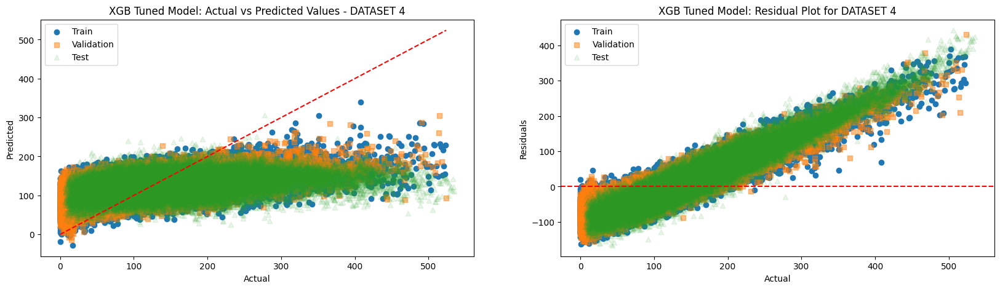

In [ ]:
# Initialize the XGBoost regressor
xgb_reg = XGBRegressor(random_state=42)
tuned_xgb_reg_scores = {'model': [], 'dataset': [], 'train_valid': [], 'MAE': [], 'MSE': [], 'RMSE':[], 'R2':[]}

for i, (train_df, test_df) in enumerate(zip(scaled_train_dfs, scaled_test_dfs)):
    print(f'--------- DATASET {i+1} ---------')

    # Set data
    X = train_df[final_features[i]].values
    y = train_df['RUL'].values
    X_train, X_val, y_train, y_val = train_test_split(X, y, test_size=0.3, random_state=42)
    X_test = test_df[final_features[i]].values
    y_test = test_df['RUL'].values

    # Define the parameter grid for hyperparameter optimization
    param_grid = {
        'n_estimators': [100, 200, 300],
        'learning_rate': [0.01, 0.05, 0.1],
        'max_depth': [3, 4, 5],
        'subsample': [0.5, 0.7, 1.0],
        'colsample_bytree': [0.5, 0.7, 1.0],
    }

    # Initialize GridSearchCV
    grid_search = GridSearchCV(
        estimator=xgb_reg,
        param_grid=param_grid,
        scoring='neg_mean_squared_error',
        cv=5,
        verbose=1,
        n_jobs=-1  # Use all available cores
    )

    # Perform grid search and fit the model
    # fit with entire train set, no need to use validation set anymore. Straight away fit and find the best model
    grid_search.fit(X, y)
    best_params = grid_search.best_params_
    best_model = grid_search.best_estimator_
    print(f"Best parameters found: {best_params}")
    print(f"Best CV score: {-grid_search.best_score_}")

    # Predict with the best model
    pred_train = best_model.predict(X_train)
    pred_val = best_model.predict(X_val)
    pred_test = best_model.predict(X_test)

    # Calculate and print metrics for training, validation, and test datasets
    train_metrics = calculate_reg_metrics(y_train, pred_train, "Training")
    val_metrics = calculate_reg_metrics(y_val, pred_val, "Validation")
    test_metrics = calculate_reg_metrics(y_test, pred_test, "Test")

    metrics = ['MAE', 'MSE', 'RMSE', 'R2']
    update_model_scores_reg(tuned_xgb_reg_scores, 'XGB Tuned', 'train', i+1, train_metrics, metrics)
    update_model_scores_reg(tuned_xgb_reg_scores, 'XGB Tuned', 'valid', i+1, val_metrics, metrics)
    update_model_scores_reg(tuned_xgb_reg_scores, 'XGB Tuned', 'test', i+1, test_metrics, metrics)

    # Visualise validation predictions and residuals
    fig, axs = plt.subplots(1, 2, figsize=(20, 5))
    axs = axs.flatten()
    ax = axs[0]
    ax.scatter(y_train, pred_train, marker='o', label='Train')
    ax.scatter(y_val, pred_val, marker='s', label='Validation', alpha=0.5)
    ax.scatter(y_test, pred_test, marker='^', label='Test', alpha=0.1)
    ax.legend()
    ax.set_title(f'XGB Tuned Model: Actual vs Predicted Values - DATASET {i+1}')
    ax.set_xlabel('Actual')
    ax.set_ylabel('Predicted')
    ax.plot([y_val.min(), y_val.max()], [y_val.min(), y_val.max()], 'r--') # identity line

    # Visualise residuals
    train_residuals = y_train - pred_train
    val_residuals = y_val - pred_val
    test_residuals = y_test - pred_test
    ax = axs[1]
    ax.scatter(y_train, train_residuals, marker='o', label='Train')
    ax.scatter(y_val, val_residuals, marker='s', label='Validation', alpha=0.5)
    ax.scatter(y_test, test_residuals, marker='^', label='Test', alpha=0.1)
    ax.legend()
    ax.set_title(f'XGB Tuned Model: Residual Plot for DATASET {i+1}')
    ax.set_xlabel('Actual')
    ax.set_ylabel('Residuals')
    ax.axhline(y=0, color='r', linestyle='--')
    plt.show()

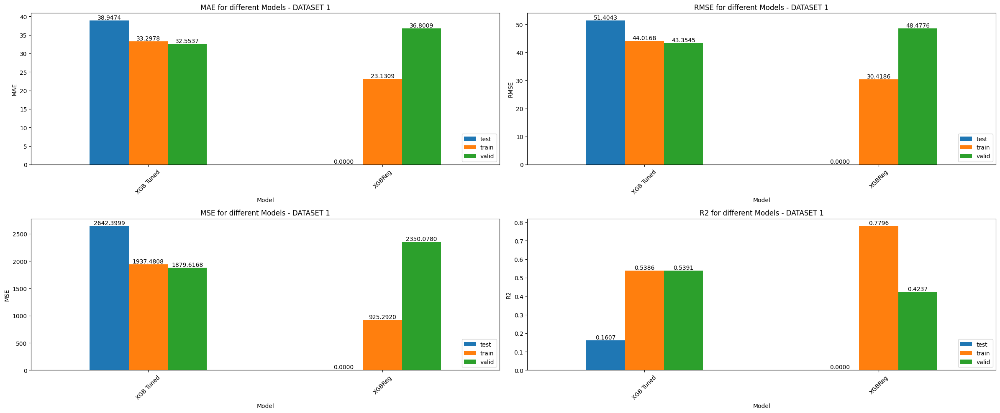

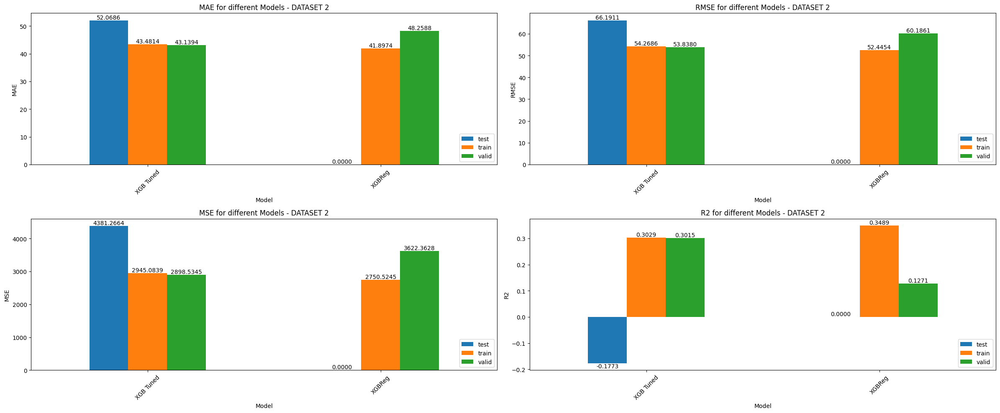

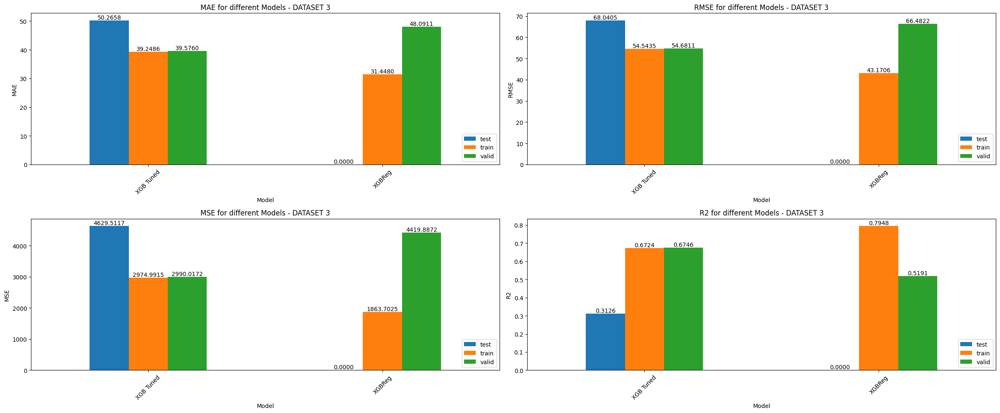

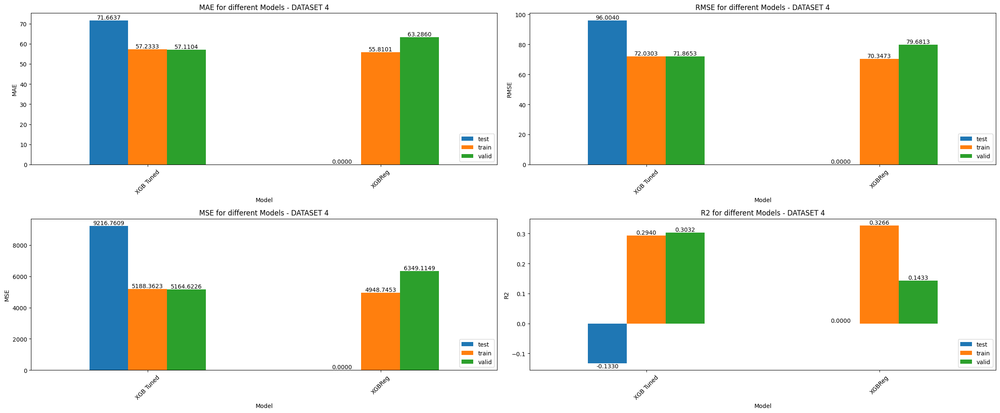

In [ ]:
tuned_xgb = pd.concat([model_scores_df.loc[model_scores_df.model == 'XGBReg'], pd.DataFrame.from_dict(tuned_xgb_reg_scores)]).reset_index(drop=True)
compare_metrics(tuned_xgb, reg_metrics)

## Classification

In [ ]:
from sklearn.metrics import roc_auc_score, recall_score, accuracy_score, precision_score, f1_score
from sklearn.metrics import confusion_matrix, roc_curve, auc, ConfusionMatrixDisplay
from sklearn.naive_bayes import GaussianNB
from sklearn.tree import DecisionTreeClassifier
from sklearn.ensemble import RandomForestClassifier
from xgboost import XGBClassifier
from sklearn.neighbors import KNeighborsClassifier

In [ ]:
def calculate_class_metrics(y_true, y_pred, y_score, dataset_name="Validation"):
    roc_auc = roc_auc_score(y_true, y_score)
    recall = recall_score(y_true, y_pred)
    accuracy = accuracy_score(y_true, y_pred)
    precision = precision_score(y_true, y_pred)
    f1 = f1_score(y_true, y_pred)

    print(f"{dataset_name} - ROC AUC: {roc_auc:.5f}")
    print(f"{dataset_name} - Recall: {recall:.5f}")
    print(f"{dataset_name} - Accuracy: {accuracy:.5f}")
    print(f"{dataset_name} - Precision: {precision:.5f}")
    print(f"{dataset_name} - F1 Score: {f1:.5f}\n")

    return [roc_auc, recall, accuracy, precision, f1]

In [ ]:
def train_class_model(train_df, test_df, model, cols, name, idx):
    # Set data
    X = train_df[cols].values
    y = train_df['RUL_label'].values
    X_train, X_val, y_train, y_val = train_test_split(X, y, test_size=0.3, random_state=42)

    # Cross-validation for ROC AUC
    cv_scores = cross_val_score(model, X, y, cv=5, scoring='roc_auc')
    print(f"Cross-Validated ROC AUC: {cv_scores.mean():.5f}")

    # Train model and predict
    model.fit(X_train, y_train)
    y_pred_train = model.predict(X_train)
    y_score_train = model.predict_proba(X_train)[:, 1] # Probabilities for the positive class
    y_pred_val = model.predict(X_val)
    y_score_val = model.predict_proba(X_val)[:, 1]

    # Calculate and print metrics
    train_metrics = calculate_class_metrics(y_train, y_pred_train, y_score_train, "Training")
    val_metrics = calculate_class_metrics(y_val, y_pred_val, y_score_val, "Validation")

    # Confusion Matrix
    f, axs = plt.subplots(1,3,figsize=(20, 6))

    cm_train = confusion_matrix(y_train, y_pred_train)
    disp = ConfusionMatrixDisplay(confusion_matrix=cm_train, display_labels=model.classes_)
    disp.plot(ax=axs[0])
    axs[0].set_title(f'{name} Train Set: Confusion Matrix - DATASET {idx}')

    cm_val = confusion_matrix(y_val, y_pred_val)
    disp = ConfusionMatrixDisplay(confusion_matrix=cm_val, display_labels=model.classes_)
    disp.plot(ax=axs[1])
    axs[1].set_title(f'{name} Validation Set: Confusion Matrix - DATASET {idx}')

    # ROC Curve
    fpr_train, tpr_train, thresholds_train = roc_curve(y_train, y_score_train)
    th_optimal_train = thresholds_train[np.argmax(tpr_train - fpr_train)] # threshold is optimal for when tpr + (1-fpr) is maximized
    roc_auc_train = auc(fpr_train, tpr_train)

    fpr_val, tpr_val, thresholds_val = roc_curve(y_val, y_score_val)
    th_optimal_val = thresholds_val[np.argmax(tpr_val - fpr_val)]
    roc_auc_val = auc(fpr_val, tpr_val)

    ax = axs[2]
    ax.plot(fpr_train, tpr_train, label=f'Train AUC = {roc_auc_train:.5f}')
    ax.plot(fpr_val, tpr_val, label=f'Validation AUC = {roc_auc_val:.5f}')
    ax.plot([0, 1], [0, 1], 'k--')  # Dashed diagonal
    ax.set_xlabel('False Positive Rate')
    ax.set_ylabel('True Positive Rate')
    ax.set_title(f'{name}: ROC Curve - DATASET {idx}\nTrain set Optimal Threshold: {th_optimal_train:.2f}, Validation set Optimal Threshold: {th_optimal_val:.2f}')
    ax.legend(loc='lower right')
    plt.tight_layout()
    plt.show();

    df_roc_train = pd.DataFrame.from_dict({'Thresholds': thresholds_train, 'TPR': tpr_train, 'FPR': fpr_train})
    df_roc_val = pd.DataFrame.from_dict({'Thresholds': thresholds_val, 'TPR': tpr_val, 'FPR': fpr_val})

    return train_metrics, val_metrics, df_roc_train, df_roc_val


In [ ]:
def class_train_wrapper(scaled_train_dfs, scaled_test_dfs, model, final_features, model_name, model_scores, model_roc_train, model_roc_val):
  for i, (train_df, test_df) in enumerate(zip(scaled_train_dfs, scaled_test_dfs)):
    print(f'--------- DATASET {i+1} ---------')
    train_metrics, val_metrics, df_roc_train, df_roc_val = train_class_model(train_df, test_df, model, final_features[i], model_name, i+1)
    metrics = ['ROC AUC', 'Recall', 'Accuracy', 'Precision', 'F1']
    update_model_scores_reg(model_scores, model_name, 'train', i+1, train_metrics, metrics)
    update_model_scores_reg(model_scores, model_name, 'valid', i+1, val_metrics, metrics)
    model_roc_train[f'{model_name}_{i+1}'] = df_roc_train
    model_roc_val[f'{model_name}_{i+1}'] = df_roc_val


### Gaussian Naive Bayes

In [ ]:
model_scores_class = {'model':[], 'dataset': [], 'train_valid':[], 'ROC AUC' : [], 'Recall':[], 'Accuracy':[], 'Precision':[], 'F1':[]}
model_rocs_train = {}
model_rocs_val = {}

--------- DATASET 1 ---------
Cross-Validated ROC AUC: 0.89562
Training - ROC AUC: 0.89591
Training - Recall: 0.73894
Training - Accuracy: 0.83029
Training - Precision: 0.73773
Training - F1 Score: 0.73833

Validation - ROC AUC: 0.89690
Validation - Recall: 0.73592
Validation - Accuracy: 0.83221
Validation - Precision: 0.74324
Validation - F1 Score: 0.73956



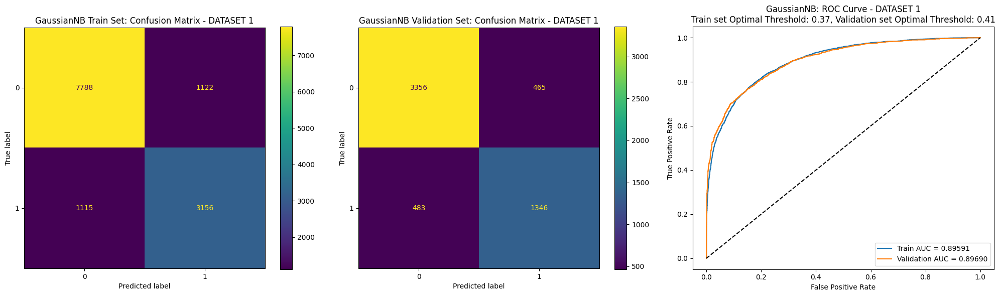

--------- DATASET 2 ---------
Cross-Validated ROC AUC: 0.51069


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


Training - ROC AUC: 0.51218
Training - Recall: 0.00000
Training - Accuracy: 0.67786
Training - Precision: 0.00000
Training - F1 Score: 0.00000

Validation - ROC AUC: 0.50394
Validation - Recall: 0.00000
Validation - Accuracy: 0.67448
Validation - Precision: 0.00000
Validation - F1 Score: 0.00000



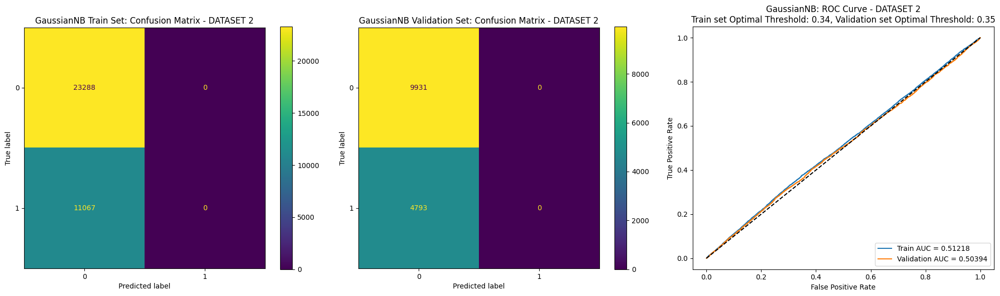

--------- DATASET 3 ---------
Cross-Validated ROC AUC: 0.88633
Training - ROC AUC: 0.88998
Training - Recall: 0.71776
Training - Accuracy: 0.83963
Training - Precision: 0.68869
Training - F1 Score: 0.70292

Validation - ROC AUC: 0.88246
Validation - Recall: 0.70468
Validation - Accuracy: 0.82955
Validation - Precision: 0.67770
Validation - F1 Score: 0.69093



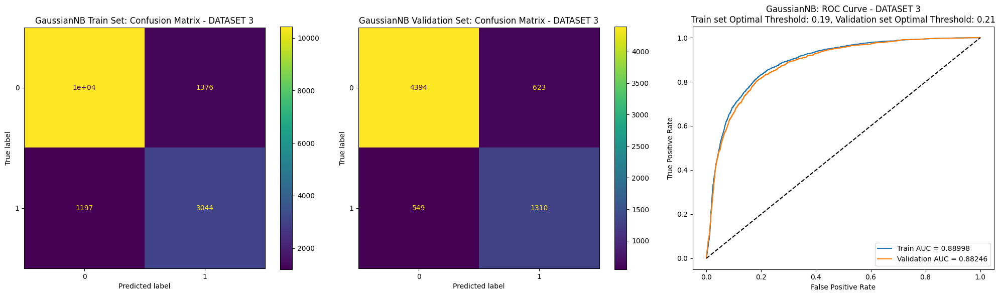

--------- DATASET 4 ---------
Cross-Validated ROC AUC: 0.51275
Training - ROC AUC: 0.51353
Training - Recall: 0.00000
Training - Accuracy: 0.73115
Training - Precision: 0.00000
Training - F1 Score: 0.00000

Validation - ROC AUC: 0.50789
Validation - Recall: 0.00000
Validation - Accuracy: 0.73542
Validation - Precision: 0.00000
Validation - F1 Score: 0.00000



/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


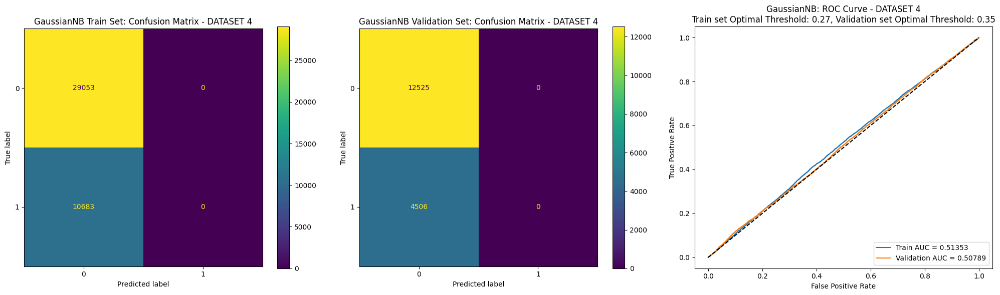

In [ ]:
gnb_model = GaussianNB()
class_train_wrapper(scaled_train_dfs, scaled_test_dfs, gnb_model, final_features, 'GaussianNB', model_scores_class, model_rocs_train, model_rocs_val)

### Decision Tree

--------- DATASET 1 ---------
Cross-Validated ROC AUC: 0.83122
Training - ROC AUC: 0.85691
Training - Recall: 0.79021
Training - Accuracy: 0.77065
Training - Precision: 0.61341
Training - F1 Score: 0.69068

Validation - ROC AUC: 0.84284
Validation - Recall: 0.78568
Validation - Accuracy: 0.76372
Validation - Precision: 0.60378
Validation - F1 Score: 0.68282



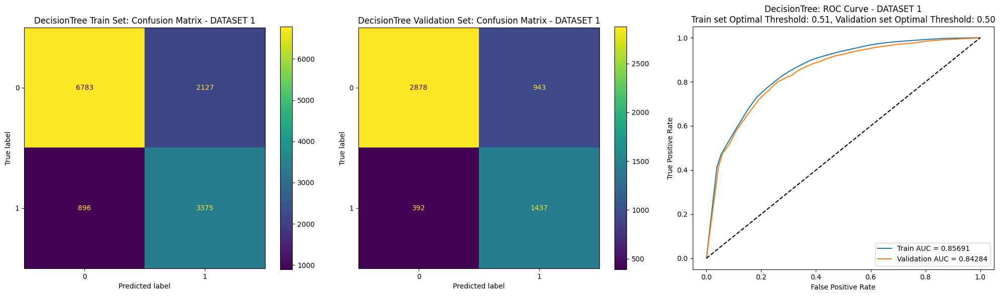

--------- DATASET 2 ---------
Cross-Validated ROC AUC: 0.64947
Training - ROC AUC: 0.66577
Training - Recall: 0.65040
Training - Accuracy: 0.60416
Training - Precision: 0.42521
Training - F1 Score: 0.51423

Validation - ROC AUC: 0.65022
Validation - Recall: 0.63530
Validation - Accuracy: 0.59291
Validation - Precision: 0.41764
Validation - F1 Score: 0.50397



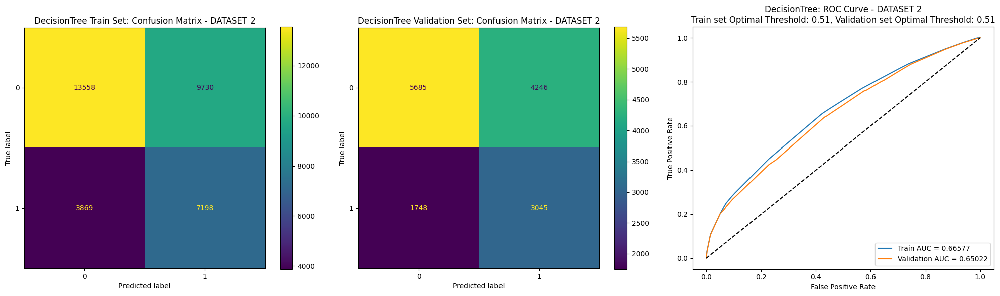

--------- DATASET 3 ---------
Cross-Validated ROC AUC: 0.87706
Training - ROC AUC: 0.89555
Training - Recall: 0.83589
Training - Accuracy: 0.81146
Training - Precision: 0.60351
Training - F1 Score: 0.70094

Validation - ROC AUC: 0.87812
Validation - Recall: 0.81226
Validation - Accuracy: 0.80032
Validation - Precision: 0.59590
Validation - F1 Score: 0.68746



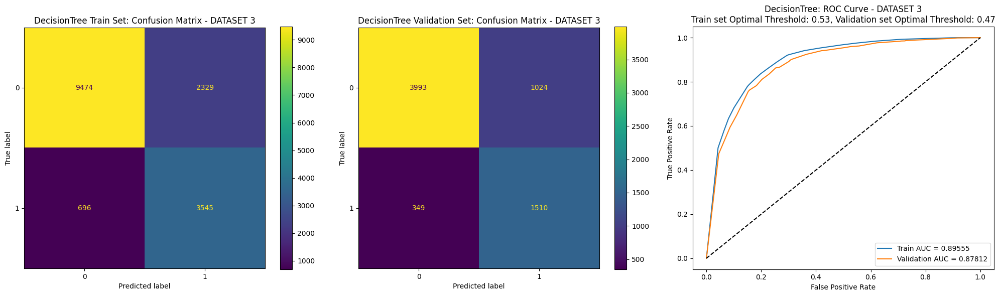

--------- DATASET 4 ---------
Cross-Validated ROC AUC: 0.66492
Training - ROC AUC: 0.67704
Training - Recall: 0.54151
Training - Accuracy: 0.66323
Training - Precision: 0.40542
Training - F1 Score: 0.46369

Validation - ROC AUC: 0.66399
Validation - Recall: 0.52685
Validation - Accuracy: 0.65757
Validation - Precision: 0.39085
Validation - F1 Score: 0.44877



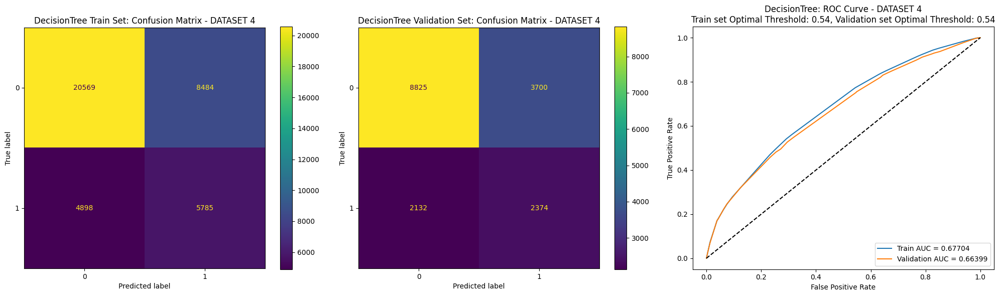

In [ ]:
dt_model = DecisionTreeClassifier(max_depth=5, random_state=42, class_weight='balanced') # this is to fix the unbalanced dataset we have
class_train_wrapper(scaled_train_dfs, scaled_test_dfs, dt_model, final_features, 'DecisionTree', model_scores_class, model_rocs_train, model_rocs_val)

### Random Forest

--------- DATASET 1 ---------
Cross-Validated ROC AUC: 0.89789
Training - ROC AUC: 0.91732
Training - Recall: 0.81456
Training - Accuracy: 0.83977
Training - Precision: 0.72494
Training - F1 Score: 0.76714

Validation - ROC AUC: 0.90753
Validation - Recall: 0.79880
Validation - Accuracy: 0.83469
Validation - Precision: 0.72077
Validation - F1 Score: 0.75778



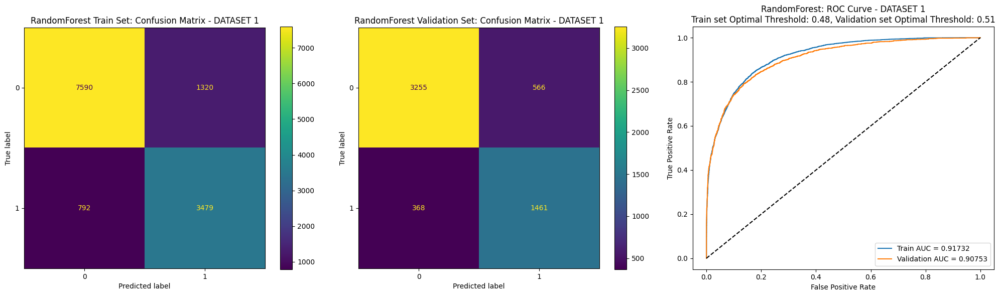

--------- DATASET 2 ---------
Cross-Validated ROC AUC: 0.62653
Training - ROC AUC: 0.67276
Training - Recall: 0.60938
Training - Accuracy: 0.62809
Training - Precision: 0.44374
Training - F1 Score: 0.51354

Validation - ROC AUC: 0.62707
Validation - Recall: 0.56520
Validation - Accuracy: 0.59957
Validation - Precision: 0.41543
Validation - F1 Score: 0.47888



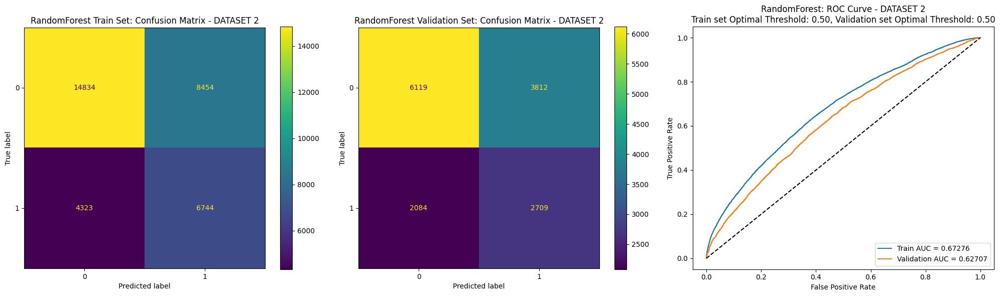

--------- DATASET 3 ---------
Cross-Validated ROC AUC: 0.93010
Training - ROC AUC: 0.94395
Training - Recall: 0.85569
Training - Accuracy: 0.87746
Training - Precision: 0.72828
Training - F1 Score: 0.78686

Validation - ROC AUC: 0.92782
Validation - Recall: 0.81388
Validation - Accuracy: 0.86067
Validation - Precision: 0.71200
Validation - F1 Score: 0.75954



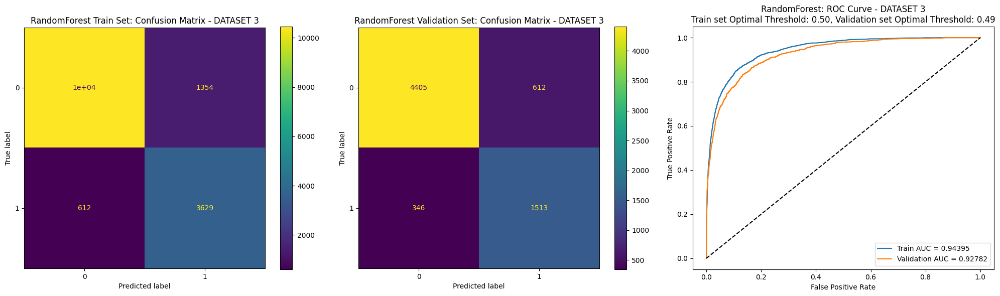

--------- DATASET 4 ---------
Cross-Validated ROC AUC: 0.63280
Training - ROC AUC: 0.66532
Training - Recall: 0.59066
Training - Accuracy: 0.63013
Training - Precision: 0.37934
Training - F1 Score: 0.46198

Validation - ROC AUC: 0.63863
Validation - Recall: 0.55482
Validation - Accuracy: 0.61006
Validation - Precision: 0.35039
Validation - F1 Score: 0.42952



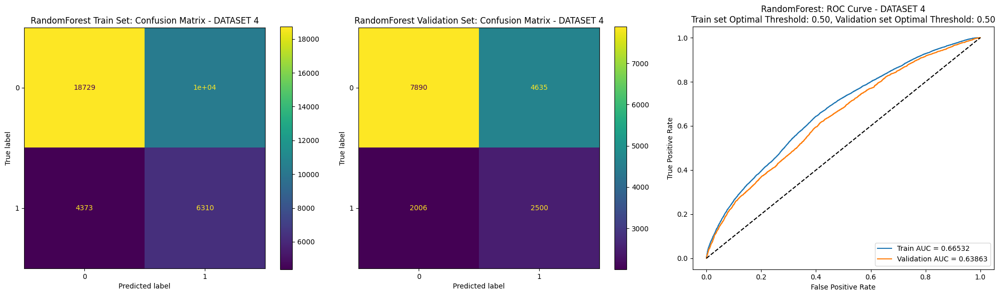

In [ ]:
rf_model = RandomForestClassifier(n_estimators=100, max_depth=5, n_jobs=-1, random_state=42, class_weight='balanced')
class_train_wrapper(scaled_train_dfs, scaled_test_dfs, rf_model, final_features, 'RandomForest', model_scores_class, model_rocs_train, model_rocs_val)

### XGBoost

--------- DATASET 1 ---------
Cross-Validated ROC AUC: 0.90166
Training - ROC AUC: 0.99980
Training - Recall: 0.99977
Training - Accuracy: 0.99158
Training - Precision: 0.97489
Training - F1 Score: 0.98717

Validation - ROC AUC: 0.91349
Validation - Recall: 0.78622
Validation - Accuracy: 0.84885
Validation - Precision: 0.75644
Validation - F1 Score: 0.77105



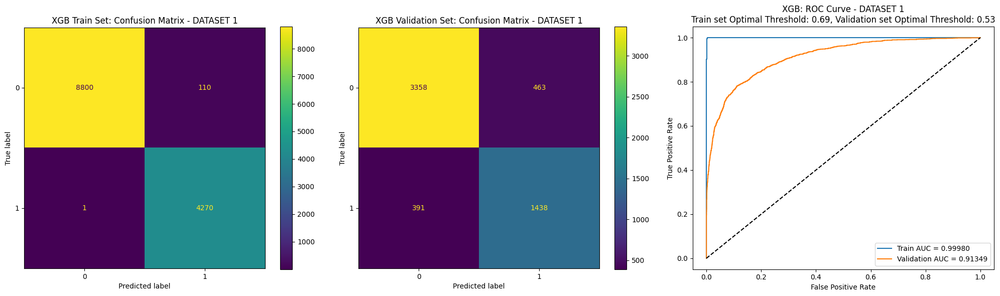

--------- DATASET 2 ---------
Cross-Validated ROC AUC: 0.70341
Training - ROC AUC: 0.93379
Training - Recall: 0.93024
Training - Accuracy: 0.81028
Training - Precision: 0.64179
Training - F1 Score: 0.75955

Validation - ROC AUC: 0.70752
Validation - Recall: 0.66284
Validation - Accuracy: 0.63217
Validation - Precision: 0.45535
Validation - F1 Score: 0.53985



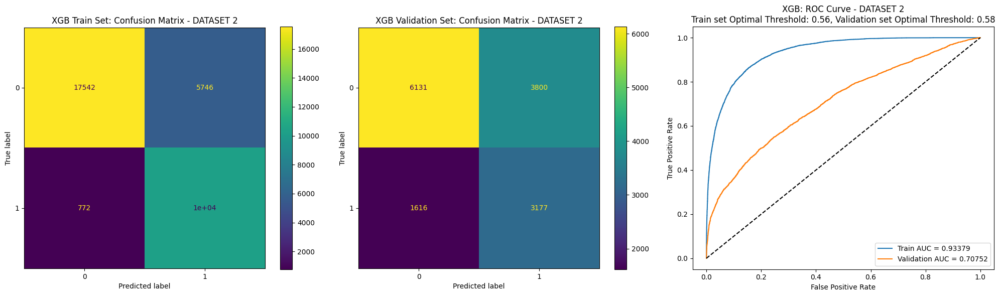

--------- DATASET 3 ---------
Cross-Validated ROC AUC: 0.94781
Training - ROC AUC: 0.99996
Training - Recall: 1.00000
Training - Accuracy: 0.99564
Training - Precision: 0.98376
Training - F1 Score: 0.99181

Validation - ROC AUC: 0.95330
Validation - Recall: 0.82087
Validation - Accuracy: 0.90009
Validation - Precision: 0.81170
Validation - F1 Score: 0.81626



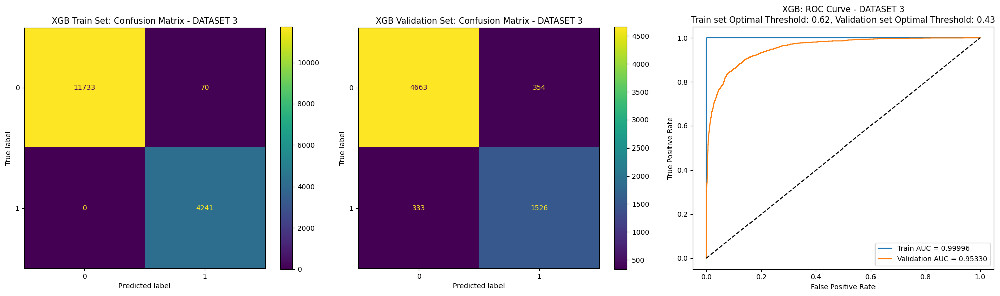

--------- DATASET 4 ---------
Cross-Validated ROC AUC: 0.72565
Training - ROC AUC: 0.93037
Training - Recall: 0.87251
Training - Accuracy: 0.84070
Training - Precision: 0.65232
Training - F1 Score: 0.74652

Validation - ROC AUC: 0.73761
Validation - Recall: 0.61429
Validation - Accuracy: 0.70841
Validation - Precision: 0.46164
Validation - F1 Score: 0.52714



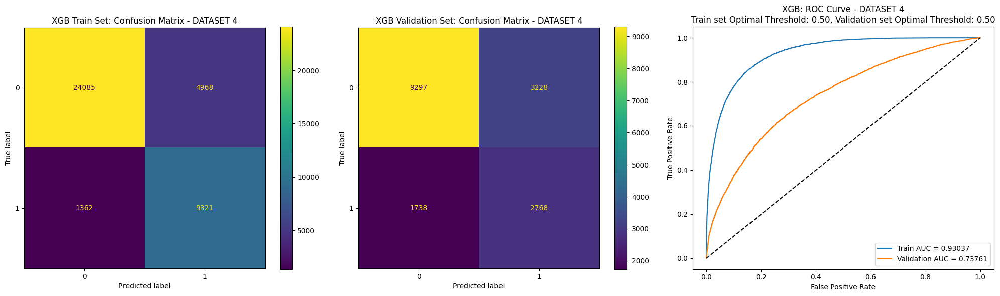

In [ ]:
xgb_model = XGBClassifier(use_label_encoder=False, eval_metric='logloss', scale_pos_weight=3, random_state=42)
class_train_wrapper(scaled_train_dfs, scaled_test_dfs, xgb_model, final_features, 'XGB', model_scores_class, model_rocs_train, model_rocs_val)

### k-Nearest Neighbours


--------- DATASET 1 ---------
Cross-Validated ROC AUC: 0.87545
Training - ROC AUC: 0.94054
Training - Recall: 0.81948
Training - Accuracy: 0.86701
Training - Precision: 0.78090
Training - F1 Score: 0.79973

Validation - ROC AUC: 0.89710
Validation - Recall: 0.78458
Validation - Accuracy: 0.83150
Validation - Precision: 0.72002
Validation - F1 Score: 0.75092



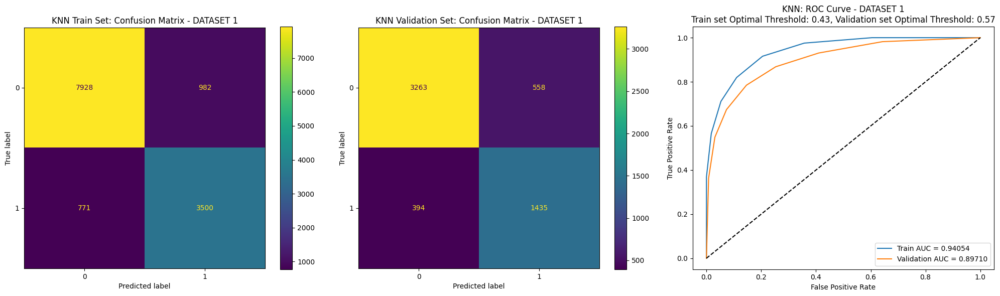

--------- DATASET 2 ---------
Cross-Validated ROC AUC: 0.53817
Training - ROC AUC: 0.75439
Training - Recall: 0.33496
Training - Accuracy: 0.72965
Training - Precision: 0.65785
Training - F1 Score: 0.44390

Validation - ROC AUC: 0.55038
Validation - Recall: 0.19216
Validation - Accuracy: 0.64174
Validation - Precision: 0.39630
Validation - F1 Score: 0.25882



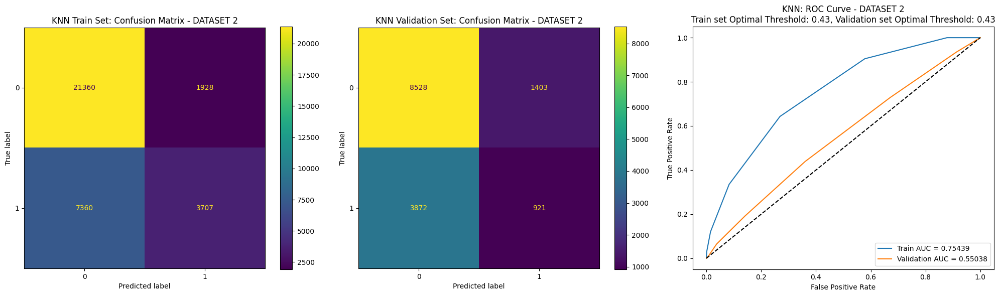

--------- DATASET 3 ---------
Cross-Validated ROC AUC: 0.91138
Training - ROC AUC: 0.96285
Training - Recall: 0.85947
Training - Accuracy: 0.90108
Training - Precision: 0.78624
Training - F1 Score: 0.82122

Validation - ROC AUC: 0.92529
Validation - Recall: 0.81011
Validation - Accuracy: 0.87129
Validation - Precision: 0.73896
Validation - F1 Score: 0.77290



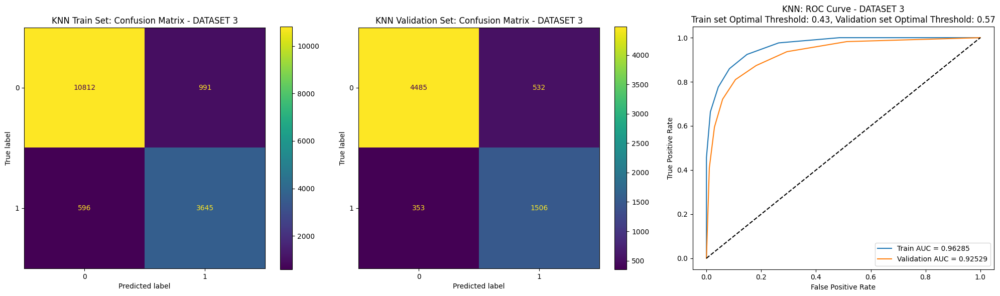

--------- DATASET 4 ---------
Cross-Validated ROC AUC: 0.53141
Training - ROC AUC: 0.76426
Training - Recall: 0.23701
Training - Accuracy: 0.75992
Training - Precision: 0.64575
Training - F1 Score: 0.34675

Validation - ROC AUC: 0.54200
Validation - Recall: 0.11496
Validation - Accuracy: 0.70008
Validation - Precision: 0.31624
Validation - F1 Score: 0.16862



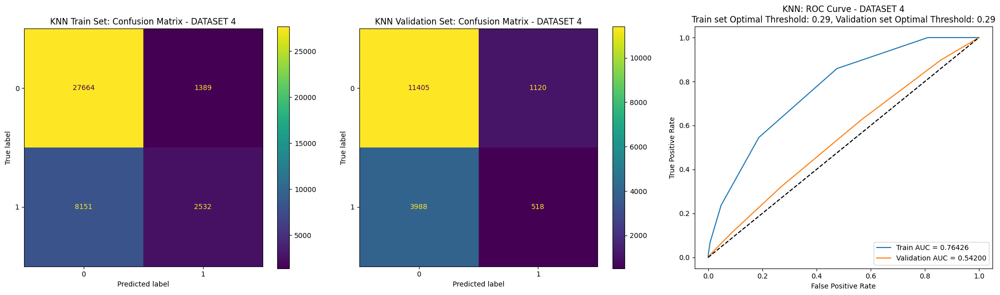

In [ ]:
knn_model = KNeighborsClassifier(n_neighbors=7, n_jobs=-1)
class_train_wrapper(scaled_train_dfs, scaled_test_dfs, knn_model, final_features, 'KNN', model_scores_class, model_rocs_train, model_rocs_val)

### Comparing Classification Models

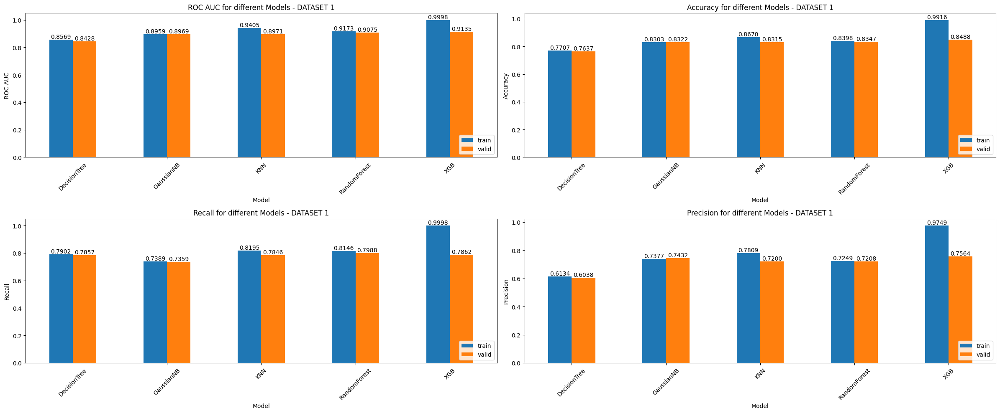

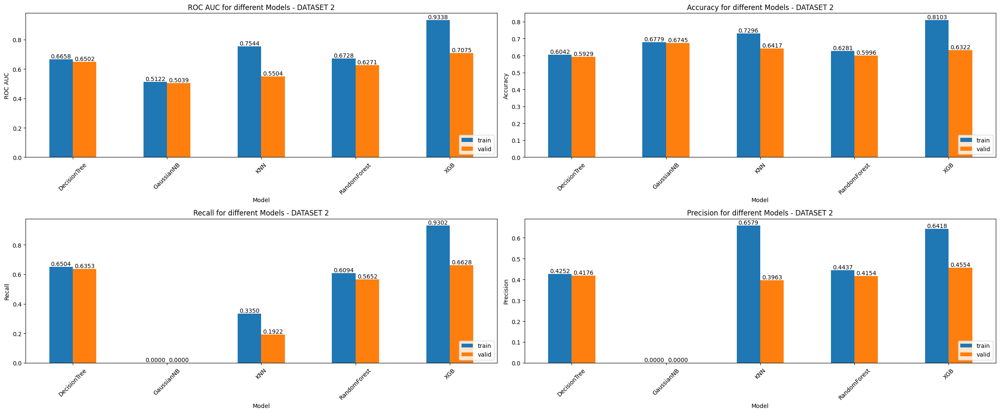

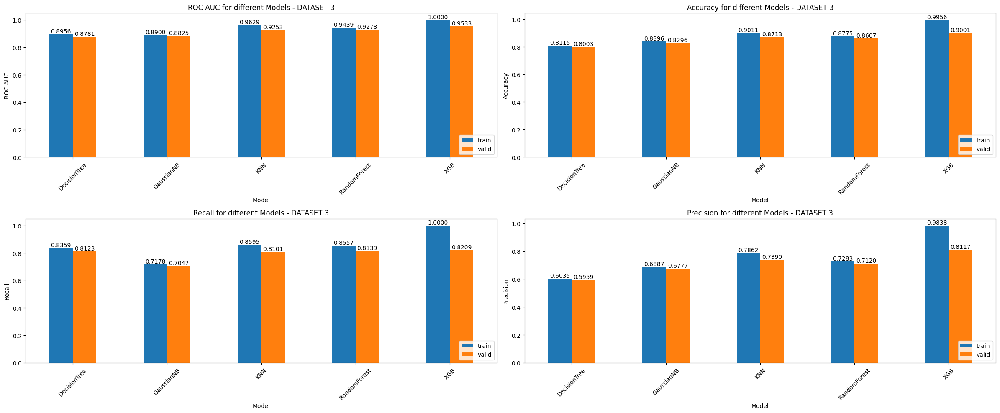

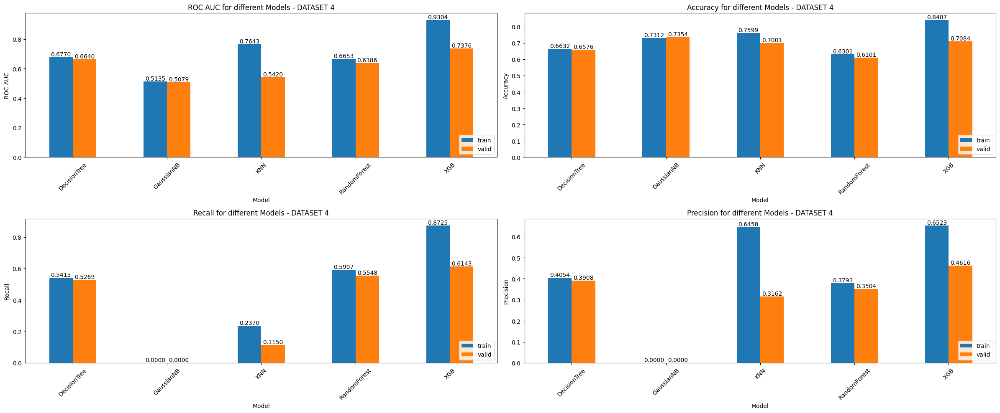

In [ ]:
model_scores_df_class = pd.DataFrame.from_dict(model_scores_class)
class_metrics = ['ROC AUC', 'Recall', 'Accuracy', 'Precision', 'F1']
compare_metrics(model_scores_df_class, class_metrics)

### Hyperparameter optimisation

In [ ]:
def get_roc_df(fpr, tpr, thresholds, y_score, y):
  engines_roc = []
  for thr in thresholds:
    engines_roc.append((y_score>=thr).mean()) # proportion of engines that require maintenance
  engines_roc = np.array(engines_roc)

  roc_thresh = {'Thresholds': thresholds, 'TPR': tpr, 'FPR': fpr, 'Engine': engines_roc}

  df_roc_thresh = pd.DataFrame.from_dict(roc_thresh)

  pos_class_count = y.value_counts()[1] # TP + FN
  neg_class_count = y.value_counts()[0] # FP + TN

  df_roc_thresh['TP'] = (pos_class_count * df_roc_thresh.TPR).astype(int)
  df_roc_thresh['FN'] = (pos_class_count - df_roc_thresh.TP).astype(int)

  df_roc_thresh['FP'] = (neg_class_count * df_roc_thresh.FPR).astype(int)
  df_roc_thresh['TN'] = (neg_class_count - df_roc_thresh.FP).astype(int)

  df_roc_thresh['TNR'] = df_roc_thresh['TN']/(df_roc_thresh['FP'] + df_roc_thresh['TN'])
  df_roc_thresh['FNR'] = df_roc_thresh['FN']/(df_roc_thresh['TP'] + df_roc_thresh['FN'])

  return df_roc_thresh

--------- DATASET 1 ---------
Fitting 5 folds for each of 243 candidates, totalling 1215 fits
Best parameters found: {'colsample_bytree': 0.7, 'learning_rate': 0.05, 'max_depth': 5, 'n_estimators': 200, 'subsample': 1.0}
Best CV score: 0.917945344569989
Training - ROC AUC: 0.97114
Training - Recall: 0.82135
Training - Accuracy: 0.91328
Training - Precision: 0.90226
Training - F1 Score: 0.85991

Validation - ROC AUC: 0.92496
Validation - Recall: 0.73866
Validation - Accuracy: 0.86673
Validation - Precision: 0.83087
Validation - F1 Score: 0.78205

Test - ROC AUC: 0.89873
Test - Recall: 0.62984
Test - Accuracy: 0.90988
Test - Precision: 0.58284
Test - F1 Score: 0.60543



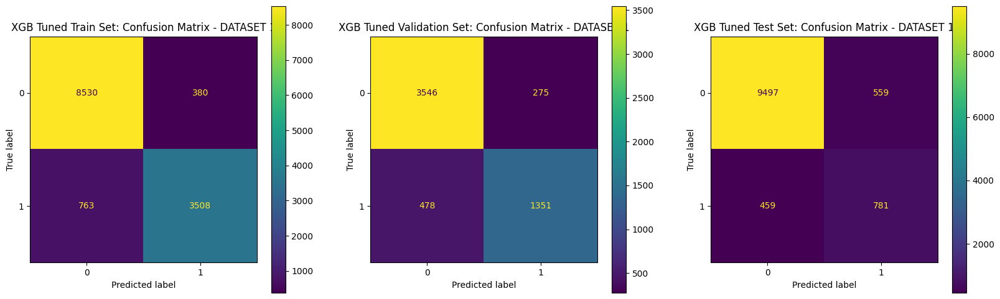

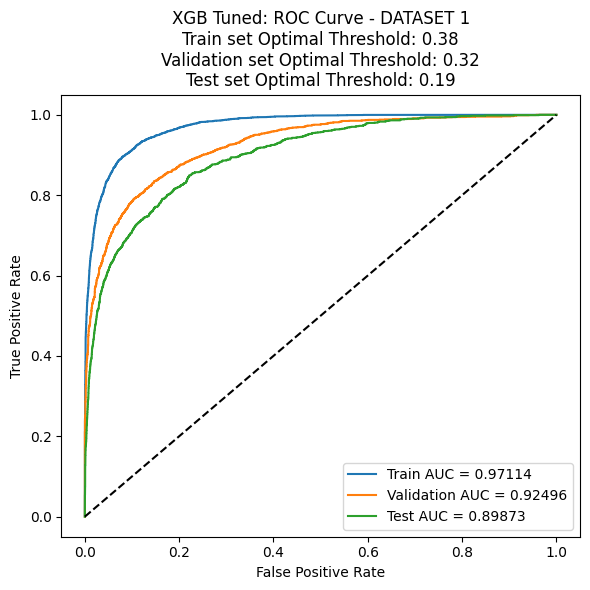

--------- DATASET 2 ---------
Fitting 5 folds for each of 243 candidates, totalling 1215 fits
Best parameters found: {'colsample_bytree': 1.0, 'learning_rate': 0.1, 'max_depth': 5, 'n_estimators': 300, 'subsample': 0.7}
Best CV score: 0.7142246529290425
Training - ROC AUC: 0.88068
Training - Recall: 0.43499
Training - Accuracy: 0.79980
Training - Precision: 0.88509
Training - F1 Score: 0.58330

Validation - ROC AUC: 0.72173
Validation - Recall: 0.31296
Validation - Accuracy: 0.73764
Validation - Precision: 0.72464
Validation - F1 Score: 0.43713

Test - ROC AUC: 0.69449
Test - Recall: 0.26601
Test - Accuracy: 0.85704
Test - Precision: 0.37475
Test - F1 Score: 0.31115



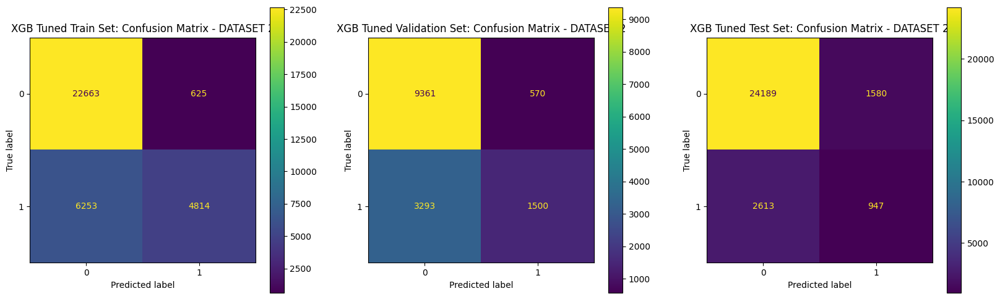

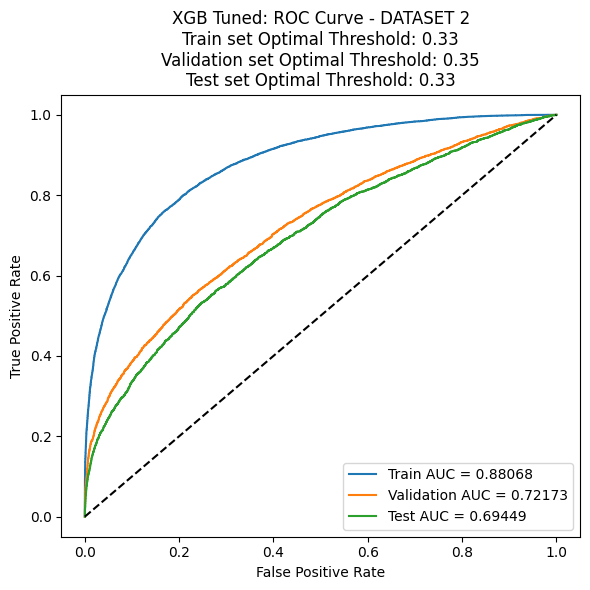

--------- DATASET 3 ---------
Fitting 5 folds for each of 243 candidates, totalling 1215 fits
Best parameters found: {'colsample_bytree': 1.0, 'learning_rate': 0.05, 'max_depth': 5, 'n_estimators': 300, 'subsample': 0.7}
Best CV score: 0.960259174320125
Training - ROC AUC: 0.99115
Training - Recall: 0.89649
Training - Accuracy: 0.95737
Training - Precision: 0.93946
Training - F1 Score: 0.91747

Validation - ROC AUC: 0.95611
Validation - Recall: 0.76708
Validation - Accuracy: 0.90256
Validation - Precision: 0.85749
Validation - F1 Score: 0.80977

Test - ROC AUC: 0.94997
Test - Recall: 0.69912
Test - Accuracy: 0.94586
Test - Precision: 0.63506
Test - F1 Score: 0.66555



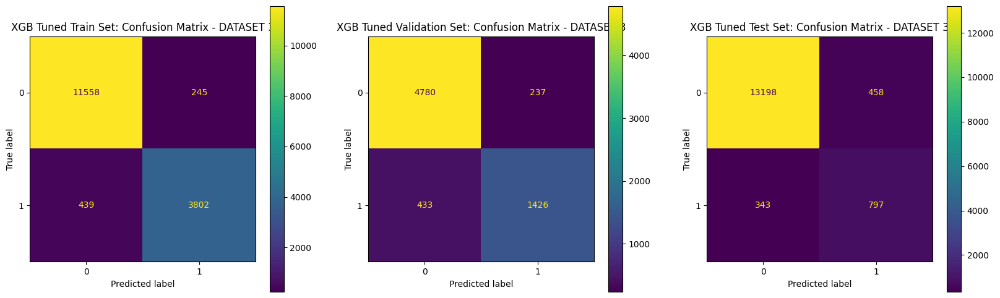

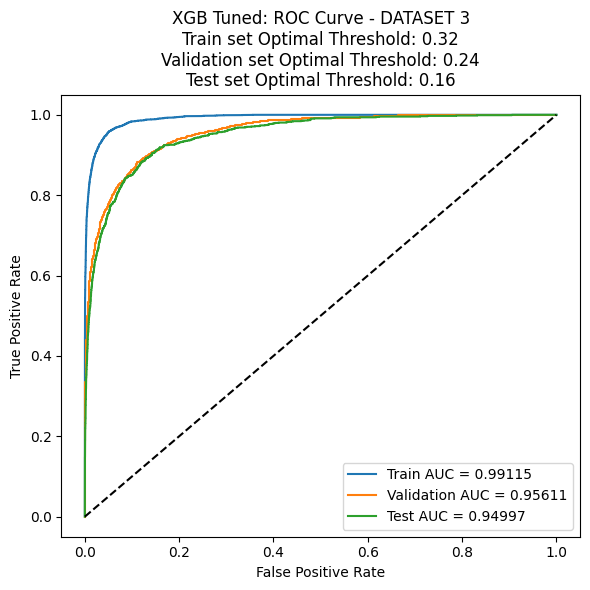

--------- DATASET 4 ---------
Fitting 5 folds for each of 243 candidates, totalling 1215 fits
Best parameters found: {'colsample_bytree': 1.0, 'learning_rate': 0.1, 'max_depth': 5, 'n_estimators': 300, 'subsample': 0.7}
Best CV score: 0.7398702701840102
Training - ROC AUC: 0.87678
Training - Recall: 0.39034
Training - Accuracy: 0.81878
Training - Precision: 0.85838
Training - F1 Score: 0.53665

Validation - ROC AUC: 0.74898
Validation - Recall: 0.26676
Validation - Accuracy: 0.77001
Validation - Precision: 0.66226
Validation - F1 Score: 0.38032

Test - ROC AUC: 0.71557
Test - Recall: 0.19115
Test - Accuracy: 0.89279
Test - Precision: 0.29206
Test - F1 Score: 0.23107



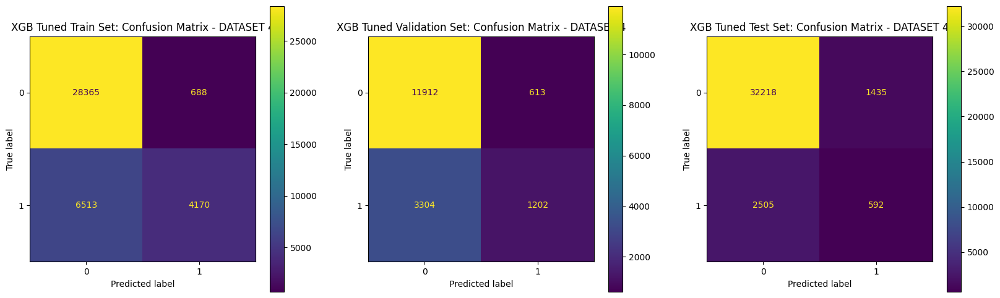

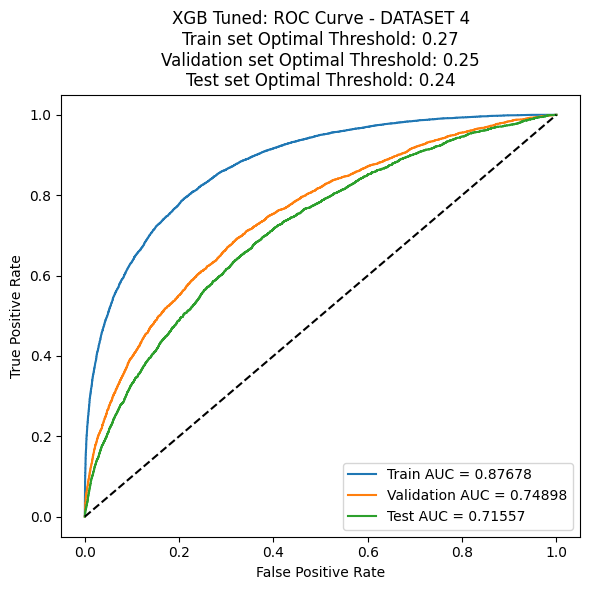

In [ ]:
class_metrics = ['ROC AUC', 'Recall', 'Accuracy', 'Precision', 'F1']
xgb_cls = XGBClassifier(random_state=42, use_label_encoder=False, eval_metric='logloss')
tuned_xgb_class_scores = {'model':[], 'dataset': [], 'train_valid':[], 'ROC AUC' : [], 'Recall':[], 'Accuracy':[], 'Precision':[], 'F1':[]}
tuned_xgb_roc_train = []
tuned_xgb_roc_val = []
tuned_xgb_roc_test = []
y_train_counts = []
y_val_counts = []
y_test_counts = []

for i, (train_df, test_df) in enumerate(zip(scaled_train_dfs, scaled_test_dfs)):
    print(f'--------- DATASET {i+1} ---------')

    # Set data
    X = train_df[final_features[i]].values
    y = train_df['RUL_label'].values
    X_train, X_val, y_train, y_val = train_test_split(X, y, test_size=0.3, random_state=42)
    X_test = test_df[final_features[i]].values
    y_test = test_df['RUL_label'].values

    # Define the parameter grid for hyperparameter optimization
    param_grid = {
        'n_estimators': [100, 200, 300],
        'learning_rate': [0.01, 0.05, 0.1],
        'max_depth': [3, 4, 5],
        'subsample': [0.5, 0.7, 1.0],
        'colsample_bytree': [0.5, 0.7, 1.0],
    }

    # Initialize GridSearchCV
    grid_search = GridSearchCV(
        estimator=xgb_cls,
        param_grid=param_grid,
        scoring='roc_auc',
        cv=5,
        verbose=1,
        n_jobs=-1  # Use all available cores
    )

    # Perform grid search and fit the model
    grid_search.fit(X_train, y_train)
    best_params = grid_search.best_params_
    best_model = grid_search.best_estimator_
    print(f"Best parameters found: {best_params}")
    print(f"Best CV score: {grid_search.best_score_}")

    # Predict with the best model
    y_pred_train = best_model.predict(X_train)
    y_pred_val = best_model.predict(X_val)
    y_pred_test = best_model.predict(X_test)
    y_score_train = best_model.predict_proba(X_train)[:, 1]  # Probabilities for the positive class
    y_score_val = best_model.predict_proba(X_val)[:, 1]  # Probabilities for the positive class
    y_score_test = best_model.predict_proba(X_test)[:, 1]  # Probabilities for the positive class

    # Calculate and print metrics
    train_metrics = calculate_class_metrics(y_train, y_pred_train, y_score_train, "Training")
    val_metrics = calculate_class_metrics(y_val, y_pred_val, y_score_val, "Validation")
    test_metrics = calculate_class_metrics(y_test, y_pred_test, y_score_test, "Test")

    update_model_scores_reg(tuned_xgb_class_scores, 'XGB Tuned', 'train', i+1, train_metrics, class_metrics)
    update_model_scores_reg(tuned_xgb_class_scores, 'XGB Tuned', 'valid', i+1, val_metrics, class_metrics)
    update_model_scores_reg(tuned_xgb_class_scores, 'XGB Tuned', 'test', i+1, test_metrics, class_metrics)

    # Confusion Matrix
    f, axs = plt.subplots(1,3,figsize=(20, 6))

    cm_train = confusion_matrix(y_train, y_pred_train)
    disp = ConfusionMatrixDisplay(confusion_matrix=cm_train, display_labels=best_model.classes_)
    disp.plot(ax=axs[0])
    axs[0].set_title(f'XGB Tuned Train Set: Confusion Matrix - DATASET {i+1}')

    cm_val = confusion_matrix(y_val, y_pred_val)
    disp = ConfusionMatrixDisplay(confusion_matrix=cm_val, display_labels=best_model.classes_)
    disp.plot(ax=axs[1])
    axs[1].set_title(f'XGB Tuned Validation Set: Confusion Matrix - DATASET {i+1}')

    cm_test = confusion_matrix(y_test, y_pred_test)
    disp = ConfusionMatrixDisplay(confusion_matrix=cm_test, display_labels=best_model.classes_)
    disp.plot(ax=axs[2])
    axs[2].set_title(f'XGB Tuned Test Set: Confusion Matrix - DATASET {i+1}')

    # ROC Curve
    f, ax = plt.subplots(figsize=(6, 6))

    fpr_train, tpr_train, thresholds_train = roc_curve(y_train, y_score_train)
    th_optimal_train = thresholds_train[np.argmax(tpr_train - fpr_train)] # threshold is optimal for when tpr + (1-fpr) is maximized
    roc_auc_train = auc(fpr_train, tpr_train)
    df_roc_train = get_roc_df(fpr_train, tpr_train, thresholds_train, y_score_train, y_train)

    fpr_val, tpr_val, thresholds_val = roc_curve(y_val, y_score_val)
    th_optimal_val = thresholds_val[np.argmax(tpr_val - fpr_val)]
    roc_auc_val = auc(fpr_val, tpr_val)
    df_roc_val = get_roc_df(fpr_val, tpr_val, thresholds_val, y_score_val, y_val)

    fpr_test, tpr_test, thresholds_test = roc_curve(y_test, y_score_test)
    th_optimal_test = thresholds_test[np.argmax(tpr_test - fpr_test)]
    roc_auc_test = auc(fpr_test, tpr_test)
    df_roc_test = get_roc_df(fpr_test, tpr_test, thresholds_test, y_score_test, y_test)

    ax.plot(fpr_train, tpr_train, label=f'Train AUC = {roc_auc_train:.5f}')
    ax.plot(fpr_val, tpr_val, label=f'Validation AUC = {roc_auc_val:.5f}')
    ax.plot(fpr_test, tpr_test, label=f'Test AUC = {roc_auc_test:.5f}')
    ax.plot([0, 1], [0, 1], 'k--')  # Dashed diagonal
    ax.set_xlabel('False Positive Rate')
    ax.set_ylabel('True Positive Rate')
    ax.set_title(f'XGB Tuned: ROC Curve - DATASET {i+1}\nTrain set Optimal Threshold: {th_optimal_train:.2f}\nValidation set Optimal Threshold: {th_optimal_val:.2f}\nTest set Optimal Threshold: {th_optimal_test:.2f}')
    ax.legend(loc='lower right')

    plt.tight_layout()
    plt.show();

    tuned_xgb_roc_train.append(df_roc_train)
    tuned_xgb_roc_val.append(df_roc_val)
    tuned_xgb_roc_test.append(df_roc_test)
    y_train_counts.append(y_train.value_counts())
    y_val_counts.append(y_val.value_counts())
    y_test_counts.append(y_test.value_counts())


In [ ]:
tuned_xgb_class = pd.concat([model_scores_df_class.loc[model_scores_df_class.model == 'XGB'], pd.DataFrame.from_dict(tuned_xgb_class_scores)]).reset_index(drop=True)
compare_metrics(tuned_xgb_class, class_metrics)

NameError: name 'model_scores_df_class' is not defined

### Expected Profit Calculation

In [ ]:
# Assume the following costs and benefits
TPb = 400
TNb = 0
FPc = -40
FNc = -500

In [ ]:
for i in range(4):
  prob_positive = y_train_counts[i][1]/y_train_counts[i].sum()
  prob_negative = y_train_counts[i][0]/y_train_counts[i].sum()
  df = tuned_xgb_roc_train[i].copy()
  df['Profit'] = prob_positive*(df.TPR*TPb + df.FNR*FNc) + prob_negative*(df.TNR*TNb + df.FPR*FPc)
  tuned_xgb_roc_train[i] = df

In [ ]:
for i in range(4):
  prob_positive = y_val_counts[i][1]/y_val_counts[i].sum()
  prob_negative = y_val_counts[i][0]/y_val_counts[i].sum()
  df = tuned_xgb_roc_val[i].copy()
  df['Profit'] = prob_positive*(df.TPR*TPb + df.FNR*FNc) + prob_negative*(df.TNR*TNb + df.FPR*FPc)
  tuned_xgb_roc_val[i] = df

In [ ]:
for i in range(4):
  prob_positive = y_test_counts[i][1]/y_test_counts[i].sum()
  prob_negative = y_test_counts[i][0]/y_test_counts[i].sum()
  df = tuned_xgb_roc_test[i].copy()
  df['Profit'] = prob_positive*(df.TPR*TPb + df.FNR*FNc) + prob_negative*(df.TNR*TNb + df.FPR*FPc)
  tuned_xgb_roc_test[i] = df

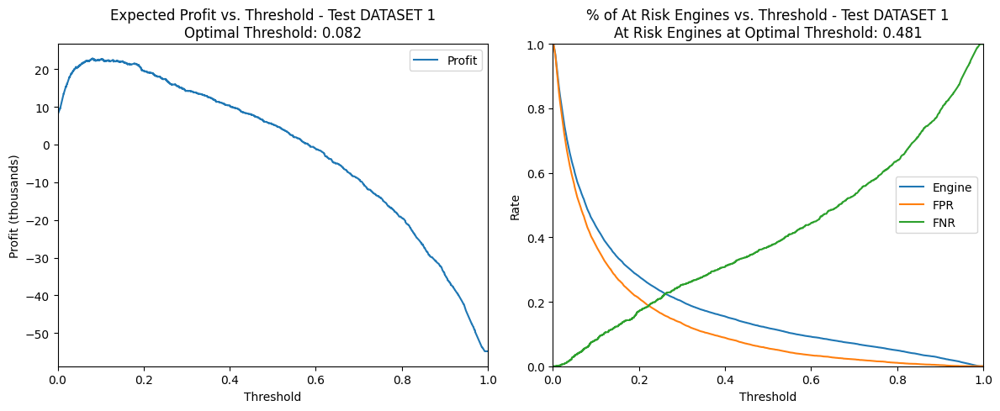

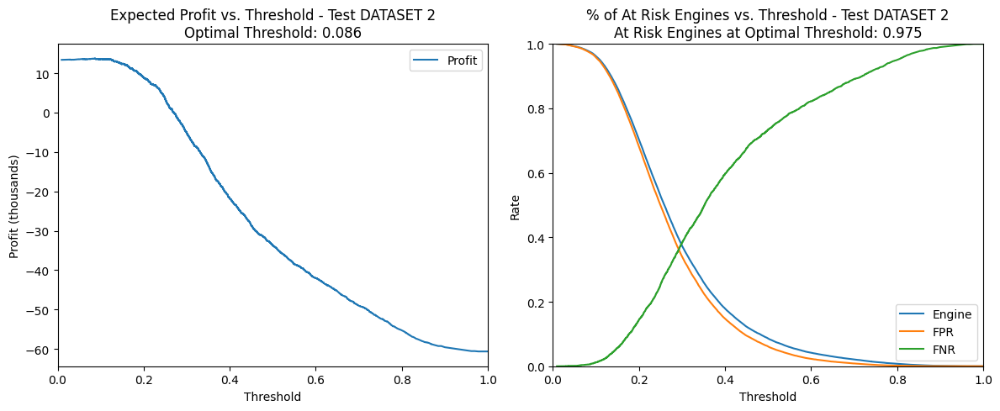

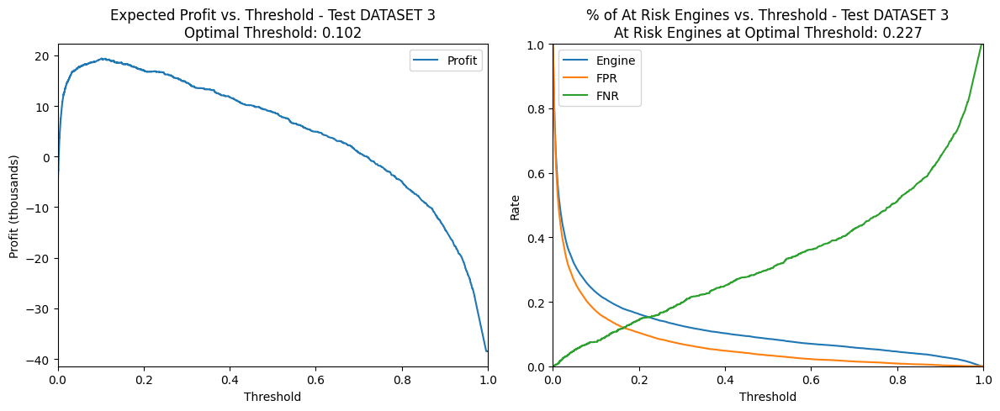

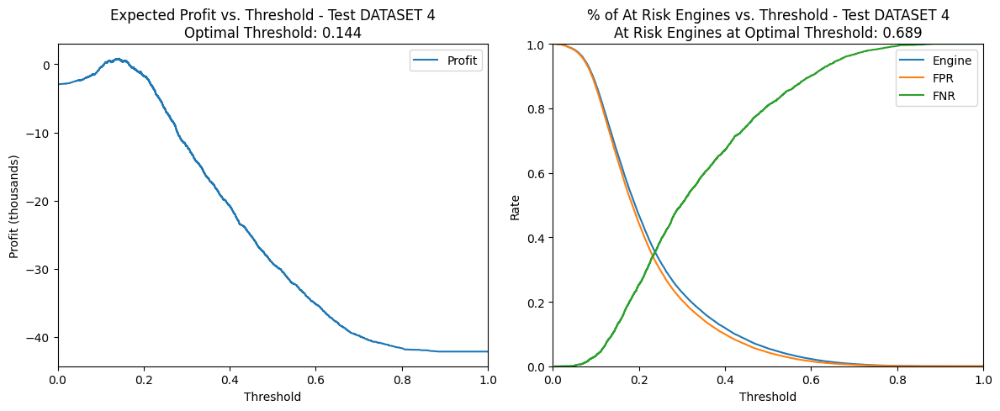

In [ ]:
for i in range(4):
  f, ax = plt.subplots(1,2, figsize=(12,5))
  ax1 = ax[0]
  tuned_xgb_roc_test[i].plot(x='Thresholds', y='Profit', ax=ax1)
  ax1.set_xlim([0.0, 1.0])
  ax1.set_xlabel('Threshold')
  ax1.set_ylabel('Profit (thousands)')
  optimal_profit_th = tuned_xgb_roc_test[i][tuned_xgb_roc_test[i].Profit == tuned_xgb_roc_test[i].Profit.max()].Thresholds.values[0]
  ax1.set_title(f'Expected Profit vs. Threshold - Test DATASET {i+1}\nOptimal Threshold: {optimal_profit_th:.3f}')

  ax2 = ax[1]
  tuned_xgb_roc_test[i].plot(x='Thresholds', y='Engine', ax=ax2)
  tuned_xgb_roc_test[i].plot(x='Thresholds', y='FPR', ax=ax2)
  tuned_xgb_roc_test[i].plot(x='Thresholds', y='FNR', ax=ax2)
  optimal_profit_th_engine = tuned_xgb_roc_test[i][tuned_xgb_roc_test[i].Profit == tuned_xgb_roc_test[i].Profit.max()].Engine.values[0]
  ax2.set_xlim([0.0, 1.0])
  ax2.set_ylim([0.0, 1.0])
  ax2.set_xlabel('Threshold')
  ax2.set_ylabel('Rate')
  ax2.set_title(f'% of At Risk Engines vs. Threshold - Test DATASET {i+1}\nAt Risk Engines at Optimal Threshold: {optimal_profit_th_engine:.3f}')

  plt.tight_layout()
  plt.show();